In [1]:
import pandas as pd
file_path = '../MONDO_0004975_associations_export.tsv'
df = pd.read_csv(file_path, sep='\t')

# Step 2: Check column names to confirm correct p-value column
print(df.columns)

# Step 3: Filter SNPs with p-value < 1e-8
filtered_df = df[df['pValue'] < 1e-4]

# Step 4: Keep only variantId ending with -A, -T, -C, or -G (exclude -?)
filtered_df = filtered_df[filtered_df['riskAllele'].str.match(r'^rs\d+-[ATCG]$', na=False)]
#convert - to _
filtered_df['riskAllele'] = filtered_df['riskAllele'].str.replace('-', '_')
print(filtered_df['riskAllele'].head())
p_value5_id = filtered_df['riskAllele'].tolist()
# Step 5: Print the first 5 SNPs with p-value < 1e-8
print("SNPs with p-value < 1e-8:")
for snp in p_value5_id:
    print(snp)

Index(['riskAllele', 'pValue', 'pValueAnnotation', 'riskFrequency', 'orValue',
       'beta', 'ci', 'mappedGenes', 'traitName', 'efoTraits', 'bgTraits',
       'accessionId', 'locations', 'pubmedId', 'author'],
      dtype='object')
1     rs8077028_T
2     rs2244526_T
3    rs17022021_T
4     rs1034435_A
5     rs4760243_A
Name: riskAllele, dtype: object
SNPs with p-value < 1e-8:
rs8077028_T
rs2244526_T
rs17022021_T
rs1034435_A
rs4760243_A
rs7260181_T
rs12716755_A
rs3820443_T
rs846858_A
rs5771225_T
rs7313581_T
rs2699450_A
rs6945197_T
rs184992198_T
rs115972394_A
rs73215707_T
rs79926713_T
rs73732514_A
rs62177277_T
rs73681522_A
rs2234017_C
rs147597631_T
rs145848414_A
rs147985478_A
rs116050881_T
rs186542490_A
rs186076999_T
rs141521929_T
rs73865608_A
rs184614511_T
rs193129245_A
rs150061627_T
rs190457471_A
rs141387448_T
rs117760708_T
rs187423924_A
rs181634374_T
rs145228677_C
rs188699384_A
rs148003968_A
rs185867524_A
rs117756856_A
rs184457411_A
rs180751169_T
rs188392327_A
rs192232892_T
rs149839

In [2]:
import pandas as pd
data_with_no_filtering = pd.read_csv('../adni_full.raw', delim_whitespace=True, usecols= lambda x: not x.endswith('.'), nrows=5)

/tmp/ipykernel_45361/436810400.py:2: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  data_with_no_filtering = pd.read_csv('../adni_full.raw', delim_whitespace=True, usecols= lambda x: not x.endswith('.'), nrows=5)


In [3]:
len(data_with_no_filtering.columns)

592538

In [4]:
id_of_pvalue5 = []
for col in data_with_no_filtering.columns:
    if col in p_value5_id:
        print(col, "is in the list")
        id_of_pvalue5.append(col)
print(id_of_pvalue5)


rs4255357_G is in the list
rs2970989_T is in the list
rs1552244_A is in the list
rs17022021_T is in the list
rs9832461_A is in the list
rs17785248_A is in the list
rs4974424_A is in the list
rs1923775_T is in the list
rs1448284_T is in the list
rs10012882_T is in the list
rs13178362_T is in the list
rs29745_A is in the list
rs6882046_A is in the list
rs543844_A is in the list
rs9381563_T is in the list
rs2718058_A is in the list
rs11771145_G is in the list
rs7016182_C is in the list
rs956225_A is in the list
rs474951_T is in the list
rs7155434_A is in the list
rs10498633_G is in the list
rs2456930_G is in the list
rs8049439_T is in the list
rs450674_T is in the list
rs16973424_A is in the list
rs440277_G is in the list
rs8106922_A is in the list
rs5167_T is in the list
['rs4255357_G', 'rs2970989_T', 'rs1552244_A', 'rs17022021_T', 'rs9832461_A', 'rs17785248_A', 'rs4974424_A', 'rs1923775_T', 'rs1448284_T', 'rs10012882_T', 'rs13178362_T', 'rs29745_A', 'rs6882046_A', 'rs543844_A', 'rs93815

In [5]:
# read the data again with the selected columns and first 6 columns of data and first 5 rows
metadata_cols = ['IID', 'SEX', 'PHENOTYPE',]

# Combine metadata columns with your filtered SNP rsIDs
columns_to_use = metadata_cols + id_of_pvalue5

# Read only those columns (first 5 + selected SNPs) and first 5 rows
data_with_filtering = pd.read_csv('../adni_full.raw', delim_whitespace=True, usecols=columns_to_use)


/tmp/ipykernel_45361/990478919.py:8: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  data_with_filtering = pd.read_csv('../adni_full.raw', delim_whitespace=True, usecols=columns_to_use)


In [6]:
#caclulate missing values of every column
missing_values = data_with_filtering.isnull().sum()
# Print the missing values
print("Missing values in each column:")
print(missing_values)
#see the minimum and median and maximum of the data


Missing values in each column:
IID             0
SEX             0
PHENOTYPE       0
rs4255357_G     7
rs2970989_T     0
rs1552244_A     0
rs17022021_T    0
rs9832461_A     0
rs17785248_A    4
rs4974424_A     2
rs1923775_T     0
rs1448284_T     0
rs10012882_T    2
rs13178362_T    1
rs29745_A       1
rs6882046_A     2
rs543844_A      0
rs9381563_T     9
rs2718058_A     1
rs11771145_G    0
rs7016182_C     0
rs956225_A      0
rs474951_T      1
rs7155434_A     2
rs10498633_G    0
rs2456930_G     1
rs8049439_T     0
rs450674_T      0
rs16973424_A    1
rs440277_G      0
rs8106922_A     0
rs5167_T        0
dtype: int64


In [7]:
# Load ADNIMERGE
adni_merge = pd.read_csv('../ADNIMERGE_11May2025.csv')

# Filter to baseline diagnoses
adni_dx = adni_merge[adni_merge['VISCODE'] == 'bl'][['RID', 'DX']]

# Extract RID from IID if needed (only if IID is like '014_S_0520')
data_with_filtering['RID'] = data_with_filtering['IID'].str.extract(r'_(\d+)$')[0].astype(int)

# Merge DX into your dataset
data_with_filtering = data_with_filtering.merge(adni_dx, on='RID', how='left')

# Drop RID if no longer needed
data_with_filtering.drop(columns=['RID'], inplace=True)

# Check merge result
print("Missing DX labels:", data_with_filtering['DX'].isna().sum())

Missing DX labels: 0


/tmp/ipykernel_45361/4016535944.py:2: DtypeWarning: Columns (19,20,21,50,51,104,105,106) have mixed types. Specify dtype option on import or set low_memory=False.
  adni_merge = pd.read_csv('../ADNIMERGE_11May2025.csv')


In [8]:
print(data_with_filtering.columns)


Index(['IID', 'SEX', 'PHENOTYPE', 'rs4255357_G', 'rs2970989_T', 'rs1552244_A',
       'rs17022021_T', 'rs9832461_A', 'rs17785248_A', 'rs4974424_A',
       'rs1923775_T', 'rs1448284_T', 'rs10012882_T', 'rs13178362_T',
       'rs29745_A', 'rs6882046_A', 'rs543844_A', 'rs9381563_T', 'rs2718058_A',
       'rs11771145_G', 'rs7016182_C', 'rs956225_A', 'rs474951_T',
       'rs7155434_A', 'rs10498633_G', 'rs2456930_G', 'rs8049439_T',
       'rs450674_T', 'rs16973424_A', 'rs440277_G', 'rs8106922_A', 'rs5167_T',
       'DX'],
      dtype='object')


In [9]:
columns_to_remove = [ 'IID','SEX','PHENOTYPE']  # Adjust the list based on your data

# Drop the specified columns
data_cleaned_with_just_dx_and_snp = data_with_filtering.drop(columns=columns_to_remove)
#convert data_cleaned_with_just_dx_and_snp to file

In [10]:
# Fill missing values with mode for all columns except 'DX'
for column in data_cleaned_with_just_dx_and_snp.columns:
    if column != 'DX':
        mode_value = data_cleaned_with_just_dx_and_snp[column].mode()[0]
        data_cleaned_with_just_dx_and_snp[column].fillna(mode_value, inplace=True)

/tmp/ipykernel_45361/1545016660.py:5: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  data_cleaned_with_just_dx_and_snp[column].fillna(mode_value, inplace=True)
/tmp/ipykernel_45361/1545016660.py:5: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method

In [11]:
# Map DX values to numerical values
dx_mapping = {'CN': 0, 'MCI': 0, 'Dementia': 1}
data_cleaned_with_just_dx_and_snp['DX'] = data_cleaned_with_just_dx_and_snp['DX'].replace(dx_mapping)

/tmp/ipykernel_45361/2107091537.py:3: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  data_cleaned_with_just_dx_and_snp['DX'] = data_cleaned_with_just_dx_and_snp['DX'].replace(dx_mapping)


In [12]:
print(data_cleaned_with_just_dx_and_snp['DX'].value_counts())

DX
0    577
1    180
Name: count, dtype: int64


In [13]:
#change all float64 columns to int64
for column in data_cleaned_with_just_dx_and_snp.columns:
    if data_cleaned_with_just_dx_and_snp[column].dtype == 'float64':
        data_cleaned_with_just_dx_and_snp[column] = data_cleaned_with_just_dx_and_snp[column].astype('int64')
#save the data_cleaned_with_just_dx_and_snp to a file

In [14]:
# train and test split
from sklearn.model_selection import train_test_split
X = data_cleaned_with_just_dx_and_snp.drop(columns=['DX'])
y = data_cleaned_with_just_dx_and_snp['DX']

In [15]:
!pip install ctgan

In [16]:
pip install xgboost


Note: you may need to restart the kernel to use updated packages.


In [21]:
!pip install catboost


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.2/99.2 MB 1.7 MB/s eta 0:00:0000:0100:02


In [15]:
# Enhanced Alzheimer's SNP Classification Pipeline (With SelectKBest)

import pandas as pd
import numpy as np
from collections import Counter
from ctgan import CTGAN
from sklearn.model_selection import train_test_split, RepeatedStratifiedKFold, GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import (
    RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier,
    HistGradientBoostingClassifier, StackingClassifier
)
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import (
    accuracy_score, balanced_accuracy_score, f1_score, classification_report,
    roc_auc_score, matthews_corrcoef, recall_score, precision_recall_curve
)
from sklearn.calibration import CalibratedClassifierCV
from imblearn.combine import SMOTETomek

# Sampling strategy using SMOTETomek after split
def apply_smote(X_train, y_train):
    smt = SMOTETomek(random_state=42)
    return smt.fit_resample(X_train, y_train)

# Threshold optimization function
def find_best_threshold(y_true, y_scores):
    precision, recall, thresholds = precision_recall_curve(y_true, y_scores)
    f1_scores = 2 * (precision * recall) / (precision + recall + 1e-10)
    best_idx = np.argmax(f1_scores)
    return thresholds[best_idx]

# Evaluate model
def evaluate_model(model, X_train, y_train, X_test, y_test):
    kf = RepeatedStratifiedKFold(n_splits=5, n_repeats=2, random_state=42)
    accs, baccs, f1s, mccs, aucs, recalls = [], [], [], [], [], []
    for train_idx, val_idx in kf.split(X_train, y_train):
        X_tr, X_val = X_train[train_idx], X_train[val_idx]
        y_tr, y_val = y_train[train_idx], y_train[val_idx]
        model.fit(X_tr, y_tr)
        y_val_pred = model.predict(X_val)
        y_val_proba = model.predict_proba(X_val)[:, 1]
        accs.append(accuracy_score(y_val, y_val_pred))
        baccs.append(balanced_accuracy_score(y_val, y_val_pred))
        f1s.append(f1_score(y_val, y_val_pred))
        mccs.append(matthews_corrcoef(y_val, y_val_pred))
        recalls.append(recall_score(y_val, y_val_pred))
        aucs.append(roc_auc_score(y_val, y_val_proba))
    print(f"CV Accuracy:            {np.mean(accs):.4f}")
    print(f"CV Balanced Accuracy:   {np.mean(baccs):.4f}")
    print(f"CV F1 Score:            {np.mean(f1s):.4f}")
    print(f"CV Recall (Sens.):      {np.mean(recalls):.4f}")
    print(f"CV MCC:                 {np.mean(mccs):.4f}")
    print(f"CV ROC AUC Score:       {np.mean(aucs):.4f}")

    model.fit(X_train, y_train)
    y_test_proba = model.predict_proba(X_test)[:, 1]
    threshold = find_best_threshold(y_test, y_test_proba)
    y_test_pred = (y_test_proba >= threshold).astype(int)

    print("\n--- Final Test Performance ---")
    print(f"Accuracy:            {accuracy_score(y_test, y_test_pred):.4f}")
    print(f"Balanced Accuracy:   {balanced_accuracy_score(y_test, y_test_pred):.4f}")
    print(f"F1 Score:            {f1_score(y_test, y_test_pred):.4f}")
    print(f"Recall (Sensitivity):{recall_score(y_test, y_test_pred):.4f}")
    print(f"MCC:                 {matthews_corrcoef(y_test, y_test_pred):.4f}")
    print(f"ROC AUC Score:       {roc_auc_score(y_test, y_test_proba):.4f}")
    print("Classification Report:")
    print(classification_report(y_test, y_test_pred, zero_division=0))

# Define models
models = {
    "Logistic Regression": LogisticRegression(solver='liblinear', max_iter=1000),
    "SVM (Linear)": SVC(kernel='linear', probability=True, class_weight='balanced'),
    "SVM (RBF)": SVC(kernel='rbf', probability=True, class_weight='balanced'),
    "MLP (Basic)": MLPClassifier(hidden_layer_sizes=(64,), alpha=0.0001, max_iter=1000),
    "MLP (Deep)": MLPClassifier(hidden_layer_sizes=(128, 64, 32), alpha=0.0005, learning_rate_init=0.001, max_iter=1500),
    "XGBoost": XGBClassifier(scale_pos_weight=1, use_label_encoder=False, eval_metric='logloss'),
    "Random Forest": RandomForestClassifier(class_weight='balanced'),
    "Gradient Boosting": GradientBoostingClassifier(),
    "AdaBoost": AdaBoostClassifier(),
    "HistGradientBoosting": HistGradientBoostingClassifier(),
    "K-Nearest Neighbors": KNeighborsClassifier(),
    "LightGBM": LGBMClassifier(class_weight='balanced'),
    "CatBoost": CatBoostClassifier(verbose=0, auto_class_weights='Balanced'),
    "Stacked Ensemble": StackingClassifier(
        estimators=[
            ('xgb', XGBClassifier(use_label_encoder=False, eval_metric='logloss')),
            ('mlp', MLPClassifier(max_iter=1000))
        ],
        final_estimator=LogisticRegression()
    )
}

# Run training pipeline for different random seeds
random_states = [66, 20, 87, 141, 69, 87, 90]

for seed in random_states:
    print(f"\n==================== Random State = {seed} ====================\n")
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed, stratify=y)

    print("Train distribution before sampling:", Counter(y_train))

    # Apply SMOTETomek
    X_train_aug, y_train_aug = apply_smote(X_train, y_train)
    print("Train distribution after SMOTETomek:", Counter(y_train_aug))

    # Scale features
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train_aug)
    X_test_scaled = scaler.transform(X_test)

    # Apply SelectKBest
    k = 100  # number of top features
    selector = SelectKBest(score_func=f_classif, k=k)
    X_train_selected = selector.fit_transform(X_train_scaled, y_train_aug)
    X_test_selected = selector.transform(X_test_scaled)

    for name, model in models.items():
        print(f"\n--- {name} ---")
        calibrated_model = CalibratedClassifierCV(model, method='isotonic', cv=5)
        evaluate_model(calibrated_model, X_train_selected, y_train_aug, X_test_selected, y_test)



==================== Random State = 66 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({0: 454, 1: 454})

--- Logistic Regression ---


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/feature_selection/_univariate_selection.py:776: UserWarning: k=100 is greater than n_features=29. All the features will be returned.
  warnings.warn(


CV Accuracy:            0.6454
CV Balanced Accuracy:   0.6453
CV F1 Score:            0.6502
CV Recall (Sens.):      0.6617
CV MCC:                 0.2922
CV ROC AUC Score:       0.6968

--- Final Test Performance ---
Accuracy:            0.5921
Balanced Accuracy:   0.6178
F1 Score:            0.4364
Recall (Sensitivity):0.6667
MCC:                 0.2004
ROC AUC Score:       0.5942
Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.57      0.68       116
           1       0.32      0.67      0.44        36

    accuracy                           0.59       152
   macro avg       0.59      0.62      0.56       152
weighted avg       0.72      0.59      0.62       152


--- SVM (Linear) ---
CV Accuracy:            0.6526
CV Balanced Accuracy:   0.6525
CV F1 Score:            0.6551
CV Recall (Sens.):      0.6617
CV MCC:                 0.3059
CV ROC AUC Score:       0.7035

--- Final Test Performance ---
Accuracy:            0.4

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:00:17] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:00:17] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:00:17] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:00:17] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8298
CV Balanced Accuracy:   0.8298
CV F1 Score:            0.8186
CV Recall (Sens.):      0.7719
CV MCC:                 0.6661
CV ROC AUC Score:       0.8977


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:00:22] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:00:23] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:00:23] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:00:23] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)



--- Final Test Performance ---
Accuracy:            0.4474
Balanced Accuracy:   0.5900
F1 Score:            0.4247
Recall (Sensitivity):0.8611
MCC:                 0.1712
ROC AUC Score:       0.5703
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.32      0.47       116
           1       0.28      0.86      0.42        36

    accuracy                           0.45       152
   macro avg       0.58      0.59      0.45       152
weighted avg       0.74      0.45      0.46       152


--- Random Forest ---
CV Accuracy:            0.8596
CV Balanced Accuracy:   0.8595
CV F1 Score:            0.8482
CV Recall (Sens.):      0.7873
CV MCC:                 0.7276
CV ROC AUC Score:       0.9218

--- Final Test Performance ---
Accuracy:            0.3618
Balanced Accuracy:   0.5532
F1 Score:            0.4049
Recall (Sensitivity):0.9167
MCC:                 0.1219
ROC AUC Score:       0.5285
Classification Report:
              prec

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.6960
CV Balanced Accuracy:   0.6960
CV F1 Score:            0.6926
CV Recall (Sens.):      0.6871
CV MCC:                 0.3940
CV ROC AUC Score:       0.7494


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.4539
Balanced Accuracy:   0.5943
F1 Score:            0.4276
Recall (Sensitivity):0.8611
MCC:                 0.1781
ROC AUC Score:       0.5273
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.33      0.48       116
           1       0.28      0.86      0.43        36

    accuracy                           0.45       152
   macro avg       0.58      0.59      0.45       152
weighted avg       0.74      0.45      0.47       152


--- HistGradientBoosting ---
CV Accuracy:            0.8166
CV Balanced Accuracy:   0.8166
CV F1 Score:            0.8070
CV Recall (Sens.):      0.7698
CV MCC:                 0.6382
CV ROC AUC Score:       0.8876

--- Final Test Performance ---
Accuracy:            0.4605
Balanced Accuracy:   0.5891
F1 Score:            0.4225
Recall (Sensitivity):0.8333
MCC:                 0.1649
ROC AUC Score:       0.5773
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:03:24] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:03:27] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:03:39] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:03:42] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8359
CV Balanced Accuracy:   0.8359
CV F1 Score:            0.8258
CV Recall (Sens.):      0.7796
CV MCC:                 0.6785
CV ROC AUC Score:       0.8984


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:17:01] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:17:04] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:17:17] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:17:21] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.4013
Balanced Accuracy:   0.5790
F1 Score:            0.4204
Recall (Sensitivity):0.9167
MCC:                 0.1668
ROC AUC Score:       0.5568
Classification Report:
              precision    recall  f1-score   support

           0       0.90      0.24      0.38       116
           1       0.27      0.92      0.42        36

    accuracy                           0.40       152
   macro avg       0.59      0.58      0.40       152
weighted avg       0.75      0.40      0.39       152


==================== Random State = 20 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({0: 457, 1: 457})

--- Logistic Regression ---


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/feature_selection/_univariate_selection.py:776: UserWarning: k=100 is greater than n_features=29. All the features will be returned.
  warnings.warn(


CV Accuracy:            0.6805
CV Balanced Accuracy:   0.6806
CV F1 Score:            0.6822
CV Recall (Sens.):      0.6872
CV MCC:                 0.3619
CV ROC AUC Score:       0.7211

--- Final Test Performance ---
Accuracy:            0.3224
Balanced Accuracy:   0.5369
F1 Score:            0.3977
Recall (Sensitivity):0.9444
MCC:                 0.0995
ROC AUC Score:       0.4756
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.13      0.23       116
           1       0.25      0.94      0.40        36

    accuracy                           0.32       152
   macro avg       0.57      0.54      0.31       152
weighted avg       0.73      0.32      0.27       152


--- SVM (Linear) ---
CV Accuracy:            0.6800
CV Balanced Accuracy:   0.6800
CV F1 Score:            0.6752
CV Recall (Sens.):      0.6674
CV MCC:                 0.3611
CV ROC AUC Score:       0.7269

--- Final Test Performance ---
Accuracy:            0.3

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:23:00] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:23:00] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:23:01] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:23:01] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8222
CV Balanced Accuracy:   0.8223
CV F1 Score:            0.8113
CV Recall (Sens.):      0.7682
CV MCC:                 0.6494
CV ROC AUC Score:       0.8986


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:23:06] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:23:06] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:23:06] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:23:06] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.4013
Balanced Accuracy:   0.5407
F1 Score:            0.3893
Recall (Sensitivity):0.8056
MCC:                 0.0793
ROC AUC Score:       0.4767
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.28      0.41       116
           1       0.26      0.81      0.39        36

    accuracy                           0.40       152
   macro avg       0.54      0.54      0.40       152
weighted avg       0.69      0.40      0.41       152


--- Random Forest ---
CV Accuracy:            0.8474
CV Balanced Accuracy:   0.8475
CV F1 Score:            0.8351
CV Recall (Sens.):      0.7758
CV MCC:                 0.7028
CV ROC AUC Score:       0.9163

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4746
Classification Report:
              prec

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.6860
CV Balanced Accuracy:   0.6861
CV F1 Score:            0.6743
CV Recall (Sens.):      0.6510
CV MCC:                 0.3742
CV ROC AUC Score:       0.7446


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.3487
Balanced Accuracy:   0.5445
F1 Score:            0.4000
Recall (Sensitivity):0.9167
MCC:                 0.1057
ROC AUC Score:       0.5034
Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.17      0.29       116
           1       0.26      0.92      0.40        36

    accuracy                           0.35       152
   macro avg       0.56      0.54      0.34       152
weighted avg       0.72      0.35      0.31       152


--- HistGradientBoosting ---
CV Accuracy:            0.8064
CV Balanced Accuracy:   0.8064
CV F1 Score:            0.7943
CV Recall (Sens.):      0.7484
CV MCC:                 0.6176
CV ROC AUC Score:       0.8833

--- Final Test Performance ---
Accuracy:            0.3487
Balanced Accuracy:   0.5350
F1 Score:            0.3926
Recall (Sensitivity):0.8889
MCC:                 0.0802
ROC AUC Score:       0.4849
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:26:09] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:26:11] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:26:12] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:26:24] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8167
CV Balanced Accuracy:   0.8168
CV F1 Score:            0.8038
CV Recall (Sens.):      0.7550
CV MCC:                 0.6398
CV ROC AUC Score:       0.8957


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:40:08] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:40:11] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:40:24] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:40:28] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.5461
Balanced Accuracy:   0.5685
F1 Score:            0.3894
Recall (Sensitivity):0.6111
MCC:                 0.1165
ROC AUC Score:       0.4680
Classification Report:
              precision    recall  f1-score   support

           0       0.81      0.53      0.64       116
           1       0.29      0.61      0.39        36

    accuracy                           0.55       152
   macro avg       0.55      0.57      0.51       152
weighted avg       0.69      0.55      0.58       152


==================== Random State = 87 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({0: 455, 1: 455})

--- Logistic Regression ---


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/feature_selection/_univariate_selection.py:776: UserWarning: k=100 is greater than n_features=29. All the features will be returned.
  warnings.warn(


CV Accuracy:            0.6885
CV Balanced Accuracy:   0.6885
CV F1 Score:            0.7002
CV Recall (Sens.):      0.7297
CV MCC:                 0.3814
CV ROC AUC Score:       0.7405

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.5134
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       116
           1       0.24      1.00      0.38        36

    accuracy                           0.24       152
   macro avg       0.12      0.50      0.19       152
weighted avg       0.06      0.24      0.09       152


--- SVM (Linear) ---
CV Accuracy:            0.6863
CV Balanced Accuracy:   0.6863
CV F1 Score:            0.6924
CV Recall (Sens.):      0.7088
CV MCC:                 0.3747
CV ROC AUC Score:       0.7427

--- Final Test Performance ---
Accuracy:            0.2

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:46:01] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:46:01] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:46:01] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:46:01] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8467
CV Balanced Accuracy:   0.8467
CV F1 Score:            0.8373
CV Recall (Sens.):      0.7912
CV MCC:                 0.7008
CV ROC AUC Score:       0.9092


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:46:07] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:46:07] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:46:07] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:46:07] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.5263
Balanced Accuracy:   0.5651
F1 Score:            0.3898
Recall (Sensitivity):0.6389
MCC:                 0.1111
ROC AUC Score:       0.5122
Classification Report:
              precision    recall  f1-score   support

           0       0.81      0.49      0.61       116
           1       0.28      0.64      0.39        36

    accuracy                           0.53       152
   macro avg       0.55      0.57      0.50       152
weighted avg       0.69      0.53      0.56       152


--- Random Forest ---
CV Accuracy:            0.8720
CV Balanced Accuracy:   0.8720
CV F1 Score:            0.8633
CV Recall (Sens.):      0.8110
CV MCC:                 0.7513
CV ROC AUC Score:       0.9271

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4628
Classification Report:
              prec

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.7214
CV Balanced Accuracy:   0.7214
CV F1 Score:            0.7182
CV Recall (Sens.):      0.7110
CV MCC:                 0.4443
CV ROC AUC Score:       0.7902


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.2434
Balanced Accuracy:   0.5043
F1 Score:            0.3850
Recall (Sensitivity):1.0000
MCC:                 0.0453
ROC AUC Score:       0.4729
Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.01      0.02       116
           1       0.24      1.00      0.39        36

    accuracy                           0.24       152
   macro avg       0.62      0.50      0.20       152
weighted avg       0.82      0.24      0.10       152


--- HistGradientBoosting ---
CV Accuracy:            0.8385
CV Balanced Accuracy:   0.8385
CV F1 Score:            0.8310
CV Recall (Sens.):      0.7945
CV MCC:                 0.6816
CV ROC AUC Score:       0.9037

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4835
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:49:09] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:49:11] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:49:12] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [22:49:24] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8374
CV Balanced Accuracy:   0.8374
CV F1 Score:            0.8281
CV Recall (Sens.):      0.7868
CV MCC:                 0.6809
CV ROC AUC Score:       0.9101


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:02:46] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:02:50] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:03:03] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:03:06] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.5132
Balanced Accuracy:   0.5661
F1 Score:            0.3934
Recall (Sensitivity):0.6667
MCC:                 0.1134
ROC AUC Score:       0.5257
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.47      0.59       116
           1       0.28      0.67      0.39        36

    accuracy                           0.51       152
   macro avg       0.55      0.57      0.49       152
weighted avg       0.69      0.51      0.55       152


==================== Random State = 141 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({1: 459, 0: 459})

--- Logistic Regression ---


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/feature_selection/_univariate_selection.py:776: UserWarning: k=100 is greater than n_features=29. All the features will be returned.
  warnings.warn(


CV Accuracy:            0.6607
CV Balanced Accuracy:   0.6607
CV F1 Score:            0.6653
CV Recall (Sens.):      0.6743
CV MCC:                 0.3230
CV ROC AUC Score:       0.7221

--- Final Test Performance ---
Accuracy:            0.2632
Balanced Accuracy:   0.5172
F1 Score:            0.3913
Recall (Sensitivity):1.0000
MCC:                 0.0916
ROC AUC Score:       0.4549
Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.03      0.07       116
           1       0.24      1.00      0.39        36

    accuracy                           0.26       152
   macro avg       0.62      0.52      0.23       152
weighted avg       0.82      0.26      0.14       152


--- SVM (Linear) ---
CV Accuracy:            0.6612
CV Balanced Accuracy:   0.6612
CV F1 Score:            0.6594
CV Recall (Sens.):      0.6580
CV MCC:                 0.3246
CV ROC AUC Score:       0.7237

--- Final Test Performance ---
Accuracy:            0.2

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:08:40] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:08:40] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:08:41] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:08:41] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8252
CV Balanced Accuracy:   0.8252
CV F1 Score:            0.8168
CV Recall (Sens.):      0.7810
CV MCC:                 0.6533
CV ROC AUC Score:       0.9021


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:08:46] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:08:46] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:08:46] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:08:46] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4540
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       116
           1       0.24      1.00      0.38        36

    accuracy                           0.24       152
   macro avg       0.12      0.50      0.19       152
weighted avg       0.06      0.24      0.09       152


--- Random Forest ---
CV Accuracy:            0.8568
CV Balanced Accuracy:   0.8567
CV F1 Score:            0.8471
CV Recall (Sens.):      0.7973
CV MCC:                 0.7195
CV ROC AUC Score:       0.9231

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4274
Classification Report:
              prec

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.7179
CV Balanced Accuracy:   0.7178
CV F1 Score:            0.7173
CV Recall (Sens.):      0.7167
CV MCC:                 0.4376
CV ROC AUC Score:       0.7746


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.3158
Balanced Accuracy:   0.5230
F1 Score:            0.3882
Recall (Sensitivity):0.9167
MCC:                 0.0605
ROC AUC Score:       0.4407
Classification Report:
              precision    recall  f1-score   support

           0       0.83      0.13      0.22       116
           1       0.25      0.92      0.39        36

    accuracy                           0.32       152
   macro avg       0.54      0.52      0.31       152
weighted avg       0.69      0.32      0.26       152


--- HistGradientBoosting ---
CV Accuracy:            0.8203
CV Balanced Accuracy:   0.8203
CV F1 Score:            0.8115
CV Recall (Sens.):      0.7767
CV MCC:                 0.6438
CV ROC AUC Score:       0.8901

--- Final Test Performance ---
Accuracy:            0.3618
Balanced Accuracy:   0.5436
F1 Score:            0.3975
Recall (Sensitivity):0.8889
MCC:                 0.0970
ROC AUC Score:       0.4765
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:11:49] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:11:52] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:11:53] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:12:05] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8334
CV Balanced Accuracy:   0.8334
CV F1 Score:            0.8256
CV Recall (Sens.):      0.7941
CV MCC:                 0.6702
CV ROC AUC Score:       0.9032


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:25:29] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:25:32] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:25:46] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:25:49] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4467
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       116
           1       0.24      1.00      0.38        36

    accuracy                           0.24       152
   macro avg       0.12      0.50      0.19       152
weighted avg       0.06      0.24      0.09       152


==================== Random State = 69 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({0: 455, 1: 455})

--- Logistic Regression ---


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/feature_selection/_univariate_selection.py:776: UserWarning: k=100 is greater than n_features=29. All the features will be returned.
  warnings.warn(


CV Accuracy:            0.6786
CV Balanced Accuracy:   0.6786
CV F1 Score:            0.6758
CV Recall (Sens.):      0.6736
CV MCC:                 0.3588
CV ROC AUC Score:       0.7461

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4850
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       116
           1       0.24      1.00      0.38        36

    accuracy                           0.24       152
   macro avg       0.12      0.50      0.19       152
weighted avg       0.06      0.24      0.09       152


--- SVM (Linear) ---
CV Accuracy:            0.6769
CV Balanced Accuracy:   0.6769
CV F1 Score:            0.6737
CV Recall (Sens.):      0.6681
CV MCC:                 0.3547
CV ROC AUC Score:       0.7423

--- Final Test Performance ---
Accuracy:            0.2

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:31:17] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:31:17] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:31:17] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:31:17] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8401
CV Balanced Accuracy:   0.8401
CV F1 Score:            0.8296
CV Recall (Sens.):      0.7780
CV MCC:                 0.6859
CV ROC AUC Score:       0.9128


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:31:22] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:31:23] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:31:23] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:31:23] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)



--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4998
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       116
           1       0.24      1.00      0.38        36

    accuracy                           0.24       152
   macro avg       0.12      0.50      0.19       152
weighted avg       0.06      0.24      0.09       152


--- Random Forest ---
CV Accuracy:            0.8577
CV Balanced Accuracy:   0.8577
CV F1 Score:            0.8458
CV Recall (Sens.):      0.7813
CV MCC:                 0.7241
CV ROC AUC Score:       0.9283

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4773
Classification Report:
              prec

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.7071
CV Balanced Accuracy:   0.7071
CV F1 Score:            0.6991
CV Recall (Sens.):      0.6824
CV MCC:                 0.4152
CV ROC AUC Score:       0.7822


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.5035
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       116
           1       0.24      1.00      0.38        36

    accuracy                           0.24       152
   macro avg       0.12      0.50      0.19       152
weighted avg       0.06      0.24      0.09       152


--- HistGradientBoosting ---
CV Accuracy:            0.8253
CV Balanced Accuracy:   0.8253
CV F1 Score:            0.8152
CV Recall (Sens.):      0.7725
CV MCC:                 0.6548
CV ROC AUC Score:       0.9061

--- Final Test Performance ---
Accuracy:            0.2829
Balanced Accuracy:   0.5110
F1 Score:            0.3842
Recall (Sensitivity):0.9444
MCC:                 0.0361
ROC AUC Score:       0.5219
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:34:24] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:34:26] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:34:38] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:34:41] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8341
CV Balanced Accuracy:   0.8341
CV F1 Score:            0.8228
CV Recall (Sens.):      0.7703
CV MCC:                 0.6744
CV ROC AUC Score:       0.9104


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:47:44] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:47:47] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:48:00] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:48:03] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4919
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       116
           1       0.24      1.00      0.38        36

    accuracy                           0.24       152
   macro avg       0.12      0.50      0.19       152
weighted avg       0.06      0.24      0.09       152


==================== Random State = 87 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({0: 455, 1: 455})

--- Logistic Regression ---


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/feature_selection/_univariate_selection.py:776: UserWarning: k=100 is greater than n_features=29. All the features will be returned.
  warnings.warn(


CV Accuracy:            0.6885
CV Balanced Accuracy:   0.6885
CV F1 Score:            0.7002
CV Recall (Sens.):      0.7297
CV MCC:                 0.3814
CV ROC AUC Score:       0.7405

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.5134
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       116
           1       0.24      1.00      0.38        36

    accuracy                           0.24       152
   macro avg       0.12      0.50      0.19       152
weighted avg       0.06      0.24      0.09       152


--- SVM (Linear) ---
CV Accuracy:            0.6863
CV Balanced Accuracy:   0.6863
CV F1 Score:            0.6924
CV Recall (Sens.):      0.7088
CV MCC:                 0.3747
CV ROC AUC Score:       0.7427

--- Final Test Performance ---
Accuracy:            0.2

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:53:30] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:53:31] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:53:31] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:53:31] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8467
CV Balanced Accuracy:   0.8467
CV F1 Score:            0.8373
CV Recall (Sens.):      0.7912
CV MCC:                 0.7008
CV ROC AUC Score:       0.9092


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:53:36] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:53:36] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:53:36] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:53:36] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.5263
Balanced Accuracy:   0.5651
F1 Score:            0.3898
Recall (Sensitivity):0.6389
MCC:                 0.1111
ROC AUC Score:       0.5122
Classification Report:
              precision    recall  f1-score   support

           0       0.81      0.49      0.61       116
           1       0.28      0.64      0.39        36

    accuracy                           0.53       152
   macro avg       0.55      0.57      0.50       152
weighted avg       0.69      0.53      0.56       152


--- Random Forest ---
CV Accuracy:            0.8670
CV Balanced Accuracy:   0.8670
CV F1 Score:            0.8570
CV Recall (Sens.):      0.7989
CV MCC:                 0.7426
CV ROC AUC Score:       0.9265

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4423
Classification Report:
              prec

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.7214
CV Balanced Accuracy:   0.7214
CV F1 Score:            0.7182
CV Recall (Sens.):      0.7110
CV MCC:                 0.4443
CV ROC AUC Score:       0.7902


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.2434
Balanced Accuracy:   0.5043
F1 Score:            0.3850
Recall (Sensitivity):1.0000
MCC:                 0.0453
ROC AUC Score:       0.4729
Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.01      0.02       116
           1       0.24      1.00      0.39        36

    accuracy                           0.24       152
   macro avg       0.62      0.50      0.20       152
weighted avg       0.82      0.24      0.10       152


--- HistGradientBoosting ---
CV Accuracy:            0.8385
CV Balanced Accuracy:   0.8385
CV F1 Score:            0.8310
CV Recall (Sens.):      0.7945
CV MCC:                 0.6816
CV ROC AUC Score:       0.9037

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4835
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:56:35] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:56:38] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:56:50] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [23:56:53] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8390
CV Balanced Accuracy:   0.8390
CV F1 Score:            0.8288
CV Recall (Sens.):      0.7824
CV MCC:                 0.6851
CV ROC AUC Score:       0.9120


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [00:09:55] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [00:09:58] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [00:10:11] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [00:10:14] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.5263
Balanced Accuracy:   0.5939
F1 Score:            0.4194
Recall (Sensitivity):0.7222
MCC:                 0.1617
ROC AUC Score:       0.5366
Classification Report:
              precision    recall  f1-score   support

           0       0.84      0.47      0.60       116
           1       0.30      0.72      0.42        36

    accuracy                           0.53       152
   macro avg       0.57      0.59      0.51       152
weighted avg       0.71      0.53      0.56       152


==================== Random State = 90 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({0: 456, 1: 456})

--- Logistic Regression ---


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/feature_selection/_univariate_selection.py:776: UserWarning: k=100 is greater than n_features=29. All the features will be returned.
  warnings.warn(


CV Accuracy:            0.6759
CV Balanced Accuracy:   0.6760
CV F1 Score:            0.6743
CV Recall (Sens.):      0.6720
CV MCC:                 0.3533
CV ROC AUC Score:       0.7367

--- Final Test Performance ---
Accuracy:            0.3092
Balanced Accuracy:   0.5187
F1 Score:            0.3860
Recall (Sensitivity):0.9167
MCC:                 0.0504
ROC AUC Score:       0.4565
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.12      0.21       116
           1       0.24      0.92      0.39        36

    accuracy                           0.31       152
   macro avg       0.53      0.52      0.30       152
weighted avg       0.69      0.31      0.25       152


--- SVM (Linear) ---
CV Accuracy:            0.6896
CV Balanced Accuracy:   0.6897
CV F1 Score:            0.6823
CV Recall (Sens.):      0.6689
CV MCC:                 0.3823
CV ROC AUC Score:       0.7416

--- Final Test Performance ---
Accuracy:            0.2

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [00:15:41] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [00:15:41] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [00:15:41] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [00:15:42] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8306
CV Balanced Accuracy:   0.8306
CV F1 Score:            0.8185
CV Recall (Sens.):      0.7664
CV MCC:                 0.6683
CV ROC AUC Score:       0.9056


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [00:15:47] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [00:15:47] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [00:15:47] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [00:15:47] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4792
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       116
           1       0.24      1.00      0.38        36

    accuracy                           0.24       152
   macro avg       0.12      0.50      0.19       152
weighted avg       0.06      0.24      0.09       152


--- Random Forest ---
CV Accuracy:            0.8591
CV Balanced Accuracy:   0.8591
CV F1 Score:            0.8505
CV Recall (Sens.):      0.8038
CV MCC:                 0.7232
CV ROC AUC Score:       0.9229

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4472
Classification Report:
              prec

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.6946
CV Balanced Accuracy:   0.6947
CV F1 Score:            0.6918
CV Recall (Sens.):      0.6875
CV MCC:                 0.3911
CV ROC AUC Score:       0.7597


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.2763
Balanced Accuracy:   0.5163
F1 Score:            0.3889
Recall (Sensitivity):0.9722
MCC:                 0.0620
ROC AUC Score:       0.4568
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.06      0.11       116
           1       0.24      0.97      0.39        36

    accuracy                           0.28       152
   macro avg       0.56      0.52      0.25       152
weighted avg       0.73      0.28      0.18       152


--- HistGradientBoosting ---
CV Accuracy:            0.8234
CV Balanced Accuracy:   0.8235
CV F1 Score:            0.8139
CV Recall (Sens.):      0.7741
CV MCC:                 0.6519
CV ROC AUC Score:       0.8992

--- Final Test Performance ---
Accuracy:            0.5329
Balanced Accuracy:   0.5694
F1 Score:            0.3932
Recall (Sensitivity):0.6389
MCC:                 0.1184
ROC AUC Score:       0.5128
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [00:18:44] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [00:18:47] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [00:18:58] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [00:19:01] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8300
CV Balanced Accuracy:   0.8300
CV F1 Score:            0.8166
CV Recall (Sens.):      0.7587
CV MCC:                 0.6678
CV ROC AUC Score:       0.9038


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [00:31:50] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [00:31:53] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [00:32:05] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [00:32:09] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4774
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       116
           1       0.24      1.00      0.38        36

    accuracy                           0.24       152
   macro avg       0.12      0.50      0.19       152
weighted avg       0.06      0.24      0.09       152



In [22]:
# Enhanced Alzheimer's SNP Classification Pipeline

import pandas as pd
from collections import Counter
from ctgan import CTGAN
from sklearn.model_selection import train_test_split, StratifiedKFold, GridSearchCV, RepeatedStratifiedKFold
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import (
    RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier,
    HistGradientBoostingClassifier, StackingClassifier
)
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import (
    accuracy_score, balanced_accuracy_score, f1_score, classification_report,
    roc_auc_score, matthews_corrcoef, recall_score, precision_recall_curve
)
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.calibration import CalibratedClassifierCV
from imblearn.combine import SMOTETomek
import numpy as np

# Optional: Reduce to most informative features
selector = SelectKBest(score_func=f_classif, k=100)
X_selected = selector.fit_transform(X, y)

# Sampling strategy using SMOTETomek after split
def apply_smote(X_train, y_train):
    smt = SMOTETomek(random_state=42)
    return smt.fit_resample(X_train, y_train)

# Threshold optimization function
def find_best_threshold(y_true, y_scores):
    precision, recall, thresholds = precision_recall_curve(y_true, y_scores)
    f1_scores = 2 * (precision * recall) / (precision + recall + 1e-10)
    best_idx = np.argmax(f1_scores)
    return thresholds[best_idx]

# Evaluate model
def evaluate_model(model, X_train, y_train, X_test, y_test):
    kf = RepeatedStratifiedKFold(n_splits=5, n_repeats=2, random_state=42)
    accs, baccs, f1s, mccs, aucs, recalls = [], [], [], [], [], []
    for train_idx, val_idx in kf.split(X_train, y_train):
        X_tr, X_val = X_train[train_idx], X_train[val_idx]
        y_tr, y_val = y_train[train_idx], y_train[val_idx]
        model.fit(X_tr, y_tr)
        y_val_pred = model.predict(X_val)
        y_val_proba = model.predict_proba(X_val)[:, 1]
        accs.append(accuracy_score(y_val, y_val_pred))
        baccs.append(balanced_accuracy_score(y_val, y_val_pred))
        f1s.append(f1_score(y_val, y_val_pred))
        mccs.append(matthews_corrcoef(y_val, y_val_pred))
        recalls.append(recall_score(y_val, y_val_pred))
        aucs.append(roc_auc_score(y_val, y_val_proba))
    print(f"CV Accuracy:            {np.mean(accs):.4f}")
    print(f"CV Balanced Accuracy:   {np.mean(baccs):.4f}")
    print(f"CV F1 Score:            {np.mean(f1s):.4f}")
    print(f"CV Recall (Sens.):      {np.mean(recalls):.4f}")
    print(f"CV MCC:                 {np.mean(mccs):.4f}")
    print(f"CV ROC AUC Score:       {np.mean(aucs):.4f}")

    model.fit(X_train, y_train)
    y_test_proba = model.predict_proba(X_test)[:, 1]
    threshold = find_best_threshold(y_test, y_test_proba)
    y_test_pred = (y_test_proba >= threshold).astype(int)

    print("\n--- Final Test Performance ---")
    print(f"Accuracy:            {accuracy_score(y_test, y_test_pred):.4f}")
    print(f"Balanced Accuracy:   {balanced_accuracy_score(y_test, y_test_pred):.4f}")
    print(f"F1 Score:            {f1_score(y_test, y_test_pred):.4f}")
    print(f"Recall (Sensitivity):{recall_score(y_test, y_test_pred):.4f}")
    print(f"MCC:                 {matthews_corrcoef(y_test, y_test_pred):.4f}")
    print(f"ROC AUC Score:       {roc_auc_score(y_test, y_test_proba):.4f}")
    print("Classification Report:")
    print(classification_report(y_test, y_test_pred, zero_division=0))

# Define models with best configs
models = {
    "XGBoost": XGBClassifier(scale_pos_weight=3, eval_metric='logloss', use_label_encoder=False),
    "LightGBM": LGBMClassifier(class_weight='balanced'),
    "CatBoost": CatBoostClassifier(verbose=0, auto_class_weights='Balanced'),
    "Stacked Ensemble": StackingClassifier(
        estimators=[
            ('xgb', XGBClassifier(use_label_encoder=False, eval_metric='logloss')),
            ('mlp', MLPClassifier(max_iter=1000))
        ],
        final_estimator=LogisticRegression()
    )
}

random_states = [66, 20]

for seed in random_states:
    print(f"\n==================== Random State = {seed} ====================\n")
    X_train, X_test, y_train, y_test = train_test_split(X_selected, y, test_size=0.3, random_state=seed, stratify=y)

    print("Train distribution before sampling:", Counter(y_train))

    # Apply SMOTETomek
    X_train_aug, y_train_aug = apply_smote(X_train, y_train)
    print("Train distribution after SMOTETomek:", Counter(y_train_aug))

    # Scale features
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train_aug)
    X_test_scaled = scaler.transform(X_test)

    for name, model in models.items():
        print(f"\n--- {name} ---")
        calibrated_model = CalibratedClassifierCV(model, method='isotonic', cv=5)
        evaluate_model(calibrated_model, X_train_scaled, y_train_aug, X_test_scaled, y_test)



==================== Random State = 66 ====================

Train distribution before sampling: Counter({0: 403, 1: 126})
Train distribution after SMOTETomek: Counter({0: 400, 1: 400})

--- XGBoost ---
CV Accuracy:            0.8313
CV Balanced Accuracy:   0.8313
CV F1 Score:            0.8186
CV Recall (Sens.):      0.7675
CV MCC:                 0.6694
CV ROC AUC Score:       0.9046

--- Final Test Performance ---
Accuracy:            0.3509
Balanced Accuracy:   0.5364
F1 Score:            0.3934
Recall (Sensitivity):0.8889
MCC:                 0.0830
ROC AUC Score:       0.5166
Classification Report:
              precision    recall  f1-score   support

           0       0.84      0.18      0.30       174
           1       0.25      0.89      0.39        54

    accuracy                           0.35       228
   macro avg       0.55      0.54      0.35       228
weighted avg       0.70      0.35      0.32       228


--- LightGBM ---
[LightGBM] [Info] Number of positive: 256,

In [ ]:
# Enhanced Alzheimer's SNP Classification Pipeline

import pandas as pd
from collections import Counter
from ctgan import CTGAN
from sklearn.model_selection import train_test_split, RepeatedStratifiedKFold
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import (
    RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier,
    HistGradientBoostingClassifier, StackingClassifier
)
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import (
    accuracy_score, balanced_accuracy_score, f1_score, classification_report,
    roc_auc_score, matthews_corrcoef, recall_score, precision_recall_curve
)
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.calibration import CalibratedClassifierCV
from imblearn.combine import SMOTETomek
import numpy as np

# Assuming X and y are already defined from data preprocessing
# Optional: Reduce to most informative features
selector = SelectKBest(score_func=f_classif, k=100)
X_selected = selector.fit_transform(X, y)

# Sampling strategy using SMOTETomek after split
def apply_smote(X_train, y_train):
    smt = SMOTETomek(random_state=42)
    return smt.fit_resample(X_train, y_train)

# Threshold optimization function
def find_best_threshold(y_true, y_scores):
    precision, recall, thresholds = precision_recall_curve(y_true, y_scores)
    f1_scores = 2 * (precision * recall) / (precision + recall + 1e-10)
    best_idx = np.argmax(f1_scores)
    return thresholds[best_idx]

# Evaluate model
def evaluate_model(model, X_train, y_train, X_test, y_test):
    kf = RepeatedStratifiedKFold(n_splits=5, n_repeats=2, random_state=42)
    accs, baccs, f1s, mccs, aucs, recalls = [], [], [], [], [], []
    for train_idx, val_idx in kf.split(X_train, y_train):
        X_tr, X_val = X_train[train_idx], X_train[val_idx]
        y_tr, y_val = y_train[train_idx], y_train[val_idx]
        model.fit(X_tr, y_tr)
        y_val_pred = model.predict(X_val)
        y_val_proba = model.predict_proba(X_val)[:, 1]
        accs.append(accuracy_score(y_val, y_val_pred))
        baccs.append(balanced_accuracy_score(y_val, y_val_pred))
        f1s.append(f1_score(y_val, y_val_pred))
        mccs.append(matthews_corrcoef(y_val, y_val_pred))
        recalls.append(recall_score(y_val, y_val_pred))
        aucs.append(roc_auc_score(y_val, y_val_proba))
    print(f"CV Accuracy:            {np.mean(accs):.4f}")
    print(f"CV Balanced Accuracy:   {np.mean(baccs):.4f}")
    print(f"CV F1 Score:            {np.mean(f1s):.4f}")
    print(f"CV Recall (Sens.):      {np.mean(recalls):.4f}")
    print(f"CV MCC:                 {np.mean(mccs):.4f}")
    print(f"CV ROC AUC Score:       {np.mean(aucs):.4f}")

    model.fit(X_train, y_train)
    y_test_proba = model.predict_proba(X_test)[:, 1]
    threshold = find_best_threshold(y_test, y_test_proba)
    y_test_pred = (y_test_proba >= threshold).astype(int)

    print("\n--- Final Test Performance ---")
    print(f"Accuracy:            {accuracy_score(y_test, y_test_pred):.4f}")
    print(f"Balanced Accuracy:   {balanced_accuracy_score(y_test, y_test_pred):.4f}")
    print(f"F1 Score:            {f1_score(y_test, y_test_pred):.4f}")
    print(f"Recall (Sensitivity):{recall_score(y_test, y_test_pred):.4f}")
    print(f"MCC:                 {matthews_corrcoef(y_test, y_test_pred):.4f}")
    print(f"ROC AUC Score:       {roc_auc_score(y_test, y_test_proba):.4f}")
    print("Classification Report:")
    print(classification_report(y_test, y_test_pred, zero_division=0))

# Define models
models = {
    "Logistic Regression": LogisticRegression(solver='liblinear', max_iter=1000),
    "SVM (Linear)": SVC(kernel='linear', probability=True, class_weight='balanced'),
    "SVM (RBF)": SVC(kernel='rbf', probability=True, class_weight='balanced'),
    "MLP (Basic)": MLPClassifier(hidden_layer_sizes=(64,), alpha=0.0001, max_iter=1000),
    "MLP (Deep)": MLPClassifier(hidden_layer_sizes=(128, 64, 32), alpha=0.0005, learning_rate_init=0.001, max_iter=1500),
    "XGBoost": XGBClassifier(n_estimators=100, learning_rate=0.1, max_depth=3, scale_pos_weight=1, use_label_encoder=False, eval_metric='logloss'),
    "Random Forest": RandomForestClassifier(n_estimators=100, max_depth=None, class_weight='balanced'),
    "Gradient Boosting": GradientBoostingClassifier(n_estimators=100, learning_rate=0.1),
    "AdaBoost": AdaBoostClassifier(n_estimators=50, learning_rate=1.0),
    "HistGradientBoosting": HistGradientBoostingClassifier(max_iter=100, learning_rate=0.1),
    "K-Nearest Neighbors": KNeighborsClassifier(n_neighbors=5),
    "LightGBM": LGBMClassifier(class_weight='balanced'),
    "CatBoost": CatBoostClassifier(verbose=0, auto_class_weights='Balanced'),
    "Stacked Ensemble": StackingClassifier(
        estimators=[
            ('xgb', XGBClassifier(use_label_encoder=False, eval_metric='logloss')),
            ('mlp', MLPClassifier(max_iter=1000))
        ],
        final_estimator=LogisticRegression()
    )
}

random_states = [66, 20, 87, 141, 69, 87, 90]

for seed in random_states:
    print(f"\n==================== Random State = {seed} ====================\n")
    X_train, X_test, y_train, y_test = train_test_split(X_selected, y, test_size=0.3, random_state=seed, stratify=y)

    print("Train distribution before sampling:", Counter(y_train))

    # Apply SMOTETomek
    X_train_aug, y_train_aug = apply_smote(X_train, y_train)
    print("Train distribution after SMOTETomek:", Counter(y_train_aug))

    # Scale features
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train_aug)
    X_test_scaled = scaler.transform(X_test)

    for name, model in models.items():
        print(f"\n--- {name} ---")
        calibrated_model = CalibratedClassifierCV(model, method='isotonic', cv=5)
        evaluate_model(calibrated_model, X_train_scaled, y_train_aug, X_test_scaled, y_test)



==================== Random State = 66 ====================

Train distribution before sampling: Counter({0: 403, 1: 126})
Train distribution after SMOTETomek: Counter({0: 400, 1: 400})

--- Logistic Regression ---
CV Accuracy:            0.6788
CV Balanced Accuracy:   0.6788
CV F1 Score:            0.6719
CV Recall (Sens.):      0.6587
CV MCC:                 0.3594
CV ROC AUC Score:       0.7187

--- Final Test Performance ---
Accuracy:            0.5439
Balanced Accuracy:   0.5798
F1 Score:            0.4023
Recall (Sensitivity):0.6481
MCC:                 0.1359
ROC AUC Score:       0.5563
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.51      0.63       174
           1       0.29      0.65      0.40        54

    accuracy                           0.54       228
   macro avg       0.56      0.58      0.52       228
weighted avg       0.70      0.54      0.58       228


--- SVM (Linear) ---
CV Accuracy:            0.

In [15]:
# Enhanced Alzheimer's SNP Classification Pipeline

import pandas as pd
from collections import Counter
from ctgan import CTGAN
from sklearn.model_selection import train_test_split, RepeatedStratifiedKFold
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import (
    RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier,
    HistGradientBoostingClassifier, StackingClassifier
)
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import (
    accuracy_score, balanced_accuracy_score, f1_score, classification_report,
    roc_auc_score, matthews_corrcoef, recall_score, precision_recall_curve
)
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.calibration import CalibratedClassifierCV
from imblearn.combine import SMOTETomek
import numpy as np

# Assuming X and y are already defined from data preprocessing
# Optional: Reduce to most informative features
selector = SelectKBest(score_func=f_classif, k=100)
X_selected = selector.fit_transform(X, y)

# Sampling strategy using SMOTETomek after split
def apply_smote(X_train, y_train):
    smt = SMOTETomek(random_state=42)
    return smt.fit_resample(X_train, y_train)

# Threshold optimization function
def find_best_threshold(y_true, y_scores):
    precision, recall, thresholds = precision_recall_curve(y_true, y_scores)
    f1_scores = 2 * (precision * recall) / (precision + recall + 1e-10)
    best_idx = np.argmax(f1_scores)
    return thresholds[best_idx]

# Evaluate model
def evaluate_model(model, X_train, y_train, X_test, y_test):
    kf = RepeatedStratifiedKFold(n_splits=5, n_repeats=2, random_state=42)
    accs, baccs, f1s, mccs, aucs, recalls = [], [], [], [], [], []
    for train_idx, val_idx in kf.split(X_train, y_train):
        X_tr, X_val = X_train[train_idx], X_train[val_idx]
        y_tr, y_val = y_train[train_idx], y_train[val_idx]
        model.fit(X_tr, y_tr)
        y_val_pred = model.predict(X_val)
        y_val_proba = model.predict_proba(X_val)[:, 1]
        accs.append(accuracy_score(y_val, y_val_pred))
        baccs.append(balanced_accuracy_score(y_val, y_val_pred))
        f1s.append(f1_score(y_val, y_val_pred))
        mccs.append(matthews_corrcoef(y_val, y_val_pred))
        recalls.append(recall_score(y_val, y_val_pred))
        aucs.append(roc_auc_score(y_val, y_val_proba))
    print(f"CV Accuracy:            {np.mean(accs):.4f}")
    print(f"CV Balanced Accuracy:   {np.mean(baccs):.4f}")
    print(f"CV F1 Score:            {np.mean(f1s):.4f}")
    print(f"CV Recall (Sens.):      {np.mean(recalls):.4f}")
    print(f"CV MCC:                 {np.mean(mccs):.4f}")
    print(f"CV ROC AUC Score:       {np.mean(aucs):.4f}")

    model.fit(X_train, y_train)
    y_test_proba = model.predict_proba(X_test)[:, 1]
    threshold = find_best_threshold(y_test, y_test_proba)
    y_test_pred = (y_test_proba >= threshold).astype(int)

    print("\n--- Final Test Performance ---")
    print(f"Accuracy:            {accuracy_score(y_test, y_test_pred):.4f}")
    print(f"Balanced Accuracy:   {balanced_accuracy_score(y_test, y_test_pred):.4f}")
    print(f"F1 Score:            {f1_score(y_test, y_test_pred):.4f}")
    print(f"Recall (Sensitivity):{recall_score(y_test, y_test_pred):.4f}")
    print(f"MCC:                 {matthews_corrcoef(y_test, y_test_pred):.4f}")
    print(f"ROC AUC Score:       {roc_auc_score(y_test, y_test_proba):.4f}")
    print("Classification Report:")
    print(classification_report(y_test, y_test_pred, zero_division=0))

# Define models
models = {
    "Logistic Regression": LogisticRegression(solver='liblinear', max_iter=1000),
    "SVM (Linear)": SVC(kernel='linear', probability=True, class_weight='balanced'),
    "SVM (RBF)": SVC(kernel='rbf', probability=True, class_weight='balanced'),
    "MLP (Basic)": MLPClassifier(hidden_layer_sizes=(64,), alpha=0.0001, max_iter=1000),
    "MLP (Deep)": MLPClassifier(hidden_layer_sizes=(128, 64, 32), alpha=0.0005, learning_rate_init=0.001, max_iter=1500),
    "XGBoost": XGBClassifier(n_estimators=100, learning_rate=0.1, max_depth=3, scale_pos_weight=1, use_label_encoder=False, eval_metric='logloss'),
    "Random Forest": RandomForestClassifier(n_estimators=100, max_depth=None, class_weight='balanced'),
    "Gradient Boosting": GradientBoostingClassifier(n_estimators=100, learning_rate=0.1),
    "AdaBoost": AdaBoostClassifier(n_estimators=50, learning_rate=1.0),
    "HistGradientBoosting": HistGradientBoostingClassifier(max_iter=100, learning_rate=0.1),
    "K-Nearest Neighbors": KNeighborsClassifier(n_neighbors=5),
    "LightGBM": LGBMClassifier(class_weight='balanced'),
    "CatBoost": CatBoostClassifier(verbose=0, auto_class_weights='Balanced'),
    "Stacked Ensemble": StackingClassifier(
        estimators=[
            ('xgb', XGBClassifier(use_label_encoder=False, eval_metric='logloss')),
            ('mlp', MLPClassifier(max_iter=1000))
        ],
        final_estimator=LogisticRegression()
    )
}

random_states = [66, 20, 87, 141, 69, 87, 90]

for seed in random_states:
    print(f"\n==================== Random State = {seed} ====================\n")
    X_train, X_test, y_train, y_test = train_test_split(X_selected, y, test_size=0.2, random_state=seed, stratify=y)

    print("Train distribution before sampling:", Counter(y_train))

    # Apply SMOTETomek
    X_train_aug, y_train_aug = apply_smote(X_train, y_train)
    print("Train distribution after SMOTETomek:", Counter(y_train_aug))

    # Scale features
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train_aug)
    X_test_scaled = scaler.transform(X_test)

    for name, model in models.items():
        print(f"\n--- {name} ---")
        calibrated_model = CalibratedClassifierCV(model, method='isotonic', cv=5)
        evaluate_model(calibrated_model, X_train_scaled, y_train_aug, X_test_scaled, y_test)


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/feature_selection/_univariate_selection.py:776: UserWarning: k=100 is greater than n_features=29. All the features will be returned.
  warnings.warn(



==================== Random State = 66 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({0: 454, 1: 454})

--- Logistic Regression ---
CV Accuracy:            0.6454
CV Balanced Accuracy:   0.6453
CV F1 Score:            0.6502
CV Recall (Sens.):      0.6617
CV MCC:                 0.2922
CV ROC AUC Score:       0.6969

--- Final Test Performance ---
Accuracy:            0.5921
Balanced Accuracy:   0.6178
F1 Score:            0.4364
Recall (Sensitivity):0.6667
MCC:                 0.2004
ROC AUC Score:       0.5942
Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.57      0.68       116
           1       0.32      0.67      0.44        36

    accuracy                           0.59       152
   macro avg       0.59      0.62      0.56       152
weighted avg       0.72      0.59      0.62       152


--- SVM (Linear) ---
CV Accuracy:            0.

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [10:47:45] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [10:47:45] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [10:47:45] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [10:47:45] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.7704
CV Balanced Accuracy:   0.7703
CV F1 Score:            0.7634
CV Recall (Sens.):      0.7454
CV MCC:                 0.5447
CV ROC AUC Score:       0.8375


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [10:47:49] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [10:47:49] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [10:47:49] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [10:47:50] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.3750
Balanced Accuracy:   0.5809
F1 Score:            0.4242
Recall (Sensitivity):0.9722
MCC:                 0.1920
ROC AUC Score:       0.5506
Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.19      0.32       116
           1       0.27      0.97      0.42        36

    accuracy                           0.38       152
   macro avg       0.61      0.58      0.37       152
weighted avg       0.79      0.38      0.34       152


--- Random Forest ---
CV Accuracy:            0.8612
CV Balanced Accuracy:   0.8612
CV F1 Score:            0.8503
CV Recall (Sens.):      0.7928
CV MCC:                 0.7313
CV ROC AUC Score:       0.9241

--- Final Test Performance ---
Accuracy:            0.4079
Balanced Accuracy:   0.5546
F1 Score:            0.4000
Recall (Sensitivity):0.8333
MCC:                 0.1072
ROC AUC Score:       0.5478
Classification Report:
              prec

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.6960
CV Balanced Accuracy:   0.6960
CV F1 Score:            0.6926
CV Recall (Sens.):      0.6871
CV MCC:                 0.3940
CV ROC AUC Score:       0.7494


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.4539
Balanced Accuracy:   0.5943
F1 Score:            0.4276
Recall (Sensitivity):0.8611
MCC:                 0.1781
ROC AUC Score:       0.5273
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.33      0.48       116
           1       0.28      0.86      0.43        36

    accuracy                           0.45       152
   macro avg       0.58      0.59      0.45       152
weighted avg       0.74      0.45      0.47       152


--- HistGradientBoosting ---
CV Accuracy:            0.8166
CV Balanced Accuracy:   0.8166
CV F1 Score:            0.8070
CV Recall (Sens.):      0.7698
CV MCC:                 0.6382
CV ROC AUC Score:       0.8876

--- Final Test Performance ---
Accuracy:            0.4605
Balanced Accuracy:   0.5891
F1 Score:            0.4225
Recall (Sensitivity):0.8333
MCC:                 0.1649
ROC AUC Score:       0.5773
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [10:50:40] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [10:50:43] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [10:50:54] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [10:50:57] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8321
CV Balanced Accuracy:   0.8320
CV F1 Score:            0.8228
CV Recall (Sens.):      0.7818
CV MCC:                 0.6692
CV ROC AUC Score:       0.8983


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:03:23] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:03:26] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:03:38] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:03:42] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.5066
Balanced Accuracy:   0.5905
F1 Score:            0.4186
Recall (Sensitivity):0.7500
MCC:                 0.1579
ROC AUC Score:       0.5629
Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.43      0.57       116
           1       0.29      0.75      0.42        36

    accuracy                           0.51       152
   macro avg       0.57      0.59      0.50       152
weighted avg       0.72      0.51      0.54       152


==================== Random State = 20 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({0: 457, 1: 457})

--- Logistic Regression ---
CV Accuracy:            0.6805
CV Balanced Accuracy:   0.6806
CV F1 Score:            0.6822
CV Recall (Sens.):      0.6872
CV MCC:                 0.3619
CV ROC AUC Score:       0.7211

--- Final Test Performance ---
Accuracy:       

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:09:03] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:09:03] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:09:03] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:09:04] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.7577
CV Balanced Accuracy:   0.7577
CV F1 Score:            0.7490
CV Recall (Sens.):      0.7232
CV MCC:                 0.5171
CV ROC AUC Score:       0.8401


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:09:07] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:09:07] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:09:08] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)



--- Final Test Performance ---
Accuracy:            0.3553
Balanced Accuracy:   0.5393
F1 Score:            0.3951
Recall (Sensitivity):0.8889
MCC:                 0.0887
ROC AUC Score:       0.5136
Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.19      0.31       116
           1       0.25      0.89      0.40        36

    accuracy                           0.36       152
   macro avg       0.55      0.54      0.35       152
weighted avg       0.71      0.36      0.33       152


--- Random Forest ---
CV Accuracy:            0.8512
CV Balanced Accuracy:   0.8513
CV F1 Score:            0.8387
CV Recall (Sens.):      0.7747
CV MCC:                 0.7112
CV ROC AUC Score:       0.9166

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4588
Classification Report:
              prec

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.6860
CV Balanced Accuracy:   0.6861
CV F1 Score:            0.6743
CV Recall (Sens.):      0.6510
CV MCC:                 0.3742
CV ROC AUC Score:       0.7446


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.3487
Balanced Accuracy:   0.5445
F1 Score:            0.4000
Recall (Sensitivity):0.9167
MCC:                 0.1057
ROC AUC Score:       0.5034
Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.17      0.29       116
           1       0.26      0.92      0.40        36

    accuracy                           0.35       152
   macro avg       0.56      0.54      0.34       152
weighted avg       0.72      0.35      0.31       152


--- HistGradientBoosting ---
CV Accuracy:            0.8064
CV Balanced Accuracy:   0.8064
CV F1 Score:            0.7943
CV Recall (Sens.):      0.7484
CV MCC:                 0.6176
CV ROC AUC Score:       0.8833

--- Final Test Performance ---
Accuracy:            0.3487
Balanced Accuracy:   0.5350
F1 Score:            0.3926
Recall (Sensitivity):0.8889
MCC:                 0.0802
ROC AUC Score:       0.4849
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:11:56] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:11:59] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:12:00] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:12:11] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8217
CV Balanced Accuracy:   0.8218
CV F1 Score:            0.8086
CV Recall (Sens.):      0.7583
CV MCC:                 0.6497
CV ROC AUC Score:       0.8965


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:24:51] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:24:54] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:24:55] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:25:08] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.5329
Balanced Accuracy:   0.5886
F1 Score:            0.4132
Recall (Sensitivity):0.6944
MCC:                 0.1517
ROC AUC Score:       0.4913
Classification Report:
              precision    recall  f1-score   support

           0       0.84      0.48      0.61       116
           1       0.29      0.69      0.41        36

    accuracy                           0.53       152
   macro avg       0.56      0.59      0.51       152
weighted avg       0.71      0.53      0.56       152


==================== Random State = 87 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({0: 455, 1: 455})

--- Logistic Regression ---
CV Accuracy:            0.6885
CV Balanced Accuracy:   0.6885
CV F1 Score:            0.7002
CV Recall (Sens.):      0.7297
CV MCC:                 0.3814
CV ROC AUC Score:       0.7405

--- Final Test Performance ---
Accuracy:       

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:31:30] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:31:31] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:31:31] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:31:31] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.7852
CV Balanced Accuracy:   0.7852
CV F1 Score:            0.7758
CV Recall (Sens.):      0.7440
CV MCC:                 0.5740
CV ROC AUC Score:       0.8640


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:31:45] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:31:45] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:31:45] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:31:45] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4855
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       116
           1       0.24      1.00      0.38        36

    accuracy                           0.24       152
   macro avg       0.12      0.50      0.19       152
weighted avg       0.06      0.24      0.09       152


--- Random Forest ---
CV Accuracy:            0.8676
CV Balanced Accuracy:   0.8676
CV F1 Score:            0.8573
CV Recall (Sens.):      0.7989
CV MCC:                 0.7438
CV ROC AUC Score:       0.9252

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4744
Classification Report:
              prec

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.7214
CV Balanced Accuracy:   0.7214
CV F1 Score:            0.7182
CV Recall (Sens.):      0.7110
CV MCC:                 0.4443
CV ROC AUC Score:       0.7902


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.2434
Balanced Accuracy:   0.5043
F1 Score:            0.3850
Recall (Sensitivity):1.0000
MCC:                 0.0453
ROC AUC Score:       0.4729
Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.01      0.02       116
           1       0.24      1.00      0.39        36

    accuracy                           0.24       152
   macro avg       0.62      0.50      0.20       152
weighted avg       0.82      0.24      0.10       152


--- HistGradientBoosting ---
CV Accuracy:            0.8385
CV Balanced Accuracy:   0.8385
CV F1 Score:            0.8310
CV Recall (Sens.):      0.7945
CV MCC:                 0.6816
CV ROC AUC Score:       0.9037

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4835
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:35:05] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:35:07] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:35:08] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:35:20] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8418
CV Balanced Accuracy:   0.8418
CV F1 Score:            0.8326
CV Recall (Sens.):      0.7901
CV MCC:                 0.6903
CV ROC AUC Score:       0.9117


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:48:16] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:48:19] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:48:20] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:48:32] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.5000
Balanced Accuracy:   0.5862
F1 Score:            0.4154
Recall (Sensitivity):0.7500
MCC:                 0.1509
ROC AUC Score:       0.5296
Classification Report:
              precision    recall  f1-score   support

           0       0.84      0.42      0.56       116
           1       0.29      0.75      0.42        36

    accuracy                           0.50       152
   macro avg       0.57      0.59      0.49       152
weighted avg       0.71      0.50      0.53       152


==================== Random State = 141 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({1: 459, 0: 459})

--- Logistic Regression ---
CV Accuracy:            0.6607
CV Balanced Accuracy:   0.6607
CV F1 Score:            0.6653
CV Recall (Sens.):      0.6743
CV MCC:                 0.3230
CV ROC AUC Score:       0.7221

--- Final Test Performance ---
Accuracy:      

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:54:03] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:54:03] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:54:03] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:54:03] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.7745
CV Balanced Accuracy:   0.7745
CV F1 Score:            0.7643
CV Recall (Sens.):      0.7343
CV MCC:                 0.5516
CV ROC AUC Score:       0.8450


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:54:07] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:54:07] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:54:07] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:54:07] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.2500
Balanced Accuracy:   0.5086
F1 Score:            0.3871
Recall (Sensitivity):1.0000
MCC:                 0.0643
ROC AUC Score:       0.4532
Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.02      0.03       116
           1       0.24      1.00      0.39        36

    accuracy                           0.25       152
   macro avg       0.62      0.51      0.21       152
weighted avg       0.82      0.25      0.12       152


--- Random Forest ---
CV Accuracy:            0.8606
CV Balanced Accuracy:   0.8606
CV F1 Score:            0.8512
CV Recall (Sens.):      0.8028
CV MCC:                 0.7266
CV ROC AUC Score:       0.9240

--- Final Test Performance ---
Accuracy:            0.2434
Balanced Accuracy:   0.5043
F1 Score:            0.3850
Recall (Sensitivity):1.0000
MCC:                 0.0453
ROC AUC Score:       0.4335
Classification Report:
              prec

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.7179
CV Balanced Accuracy:   0.7178
CV F1 Score:            0.7173
CV Recall (Sens.):      0.7167
CV MCC:                 0.4376
CV ROC AUC Score:       0.7746


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.3158
Balanced Accuracy:   0.5230
F1 Score:            0.3882
Recall (Sensitivity):0.9167
MCC:                 0.0605
ROC AUC Score:       0.4407
Classification Report:
              precision    recall  f1-score   support

           0       0.83      0.13      0.22       116
           1       0.25      0.92      0.39        36

    accuracy                           0.32       152
   macro avg       0.54      0.52      0.31       152
weighted avg       0.69      0.32      0.26       152


--- HistGradientBoosting ---
CV Accuracy:            0.8203
CV Balanced Accuracy:   0.8203
CV F1 Score:            0.8115
CV Recall (Sens.):      0.7767
CV MCC:                 0.6438
CV ROC AUC Score:       0.8901

--- Final Test Performance ---
Accuracy:            0.3618
Balanced Accuracy:   0.5436
F1 Score:            0.3975
Recall (Sensitivity):0.8889
MCC:                 0.0970
ROC AUC Score:       0.4765
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:56:58] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:57:01] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:57:13] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [11:57:15] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8366
CV Balanced Accuracy:   0.8366
CV F1 Score:            0.8273
CV Recall (Sens.):      0.7887
CV MCC:                 0.6779
CV ROC AUC Score:       0.9035


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:10:13] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:10:16] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:10:29] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:10:32] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4428
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       116
           1       0.24      1.00      0.38        36

    accuracy                           0.24       152
   macro avg       0.12      0.50      0.19       152
weighted avg       0.06      0.24      0.09       152


==================== Random State = 69 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({0: 455, 1: 455})

--- Logistic Regression ---
CV Accuracy:            0.6786
CV Balanced Accuracy:   0.6786
CV F1 Score:            0.6758
CV Recall (Sens.):      0.6736
CV MCC:                 0.3588
CV ROC AUC Score:       0.7461

--- Final Test Performance ---
Accuracy:       

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:15:49] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:15:49] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:15:49] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:15:49] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.7863
CV Balanced Accuracy:   0.7863
CV F1 Score:            0.7769
CV Recall (Sens.):      0.7462
CV MCC:                 0.5750
CV ROC AUC Score:       0.8620


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:15:53] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:15:53] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:15:53] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:15:53] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.3224
Balanced Accuracy:   0.5273
F1 Score:            0.3905
Recall (Sensitivity):0.9167
MCC:                 0.0702
ROC AUC Score:       0.5301
Classification Report:
              precision    recall  f1-score   support

           0       0.84      0.14      0.24       116
           1       0.25      0.92      0.39        36

    accuracy                           0.32       152
   macro avg       0.55      0.53      0.31       152
weighted avg       0.70      0.32      0.27       152


--- Random Forest ---
CV Accuracy:            0.8681
CV Balanced Accuracy:   0.8681
CV F1 Score:            0.8584
CV Recall (Sens.):      0.8011
CV MCC:                 0.7434
CV ROC AUC Score:       0.9329

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4825
Classification Report:
              prec

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.7071
CV Balanced Accuracy:   0.7071
CV F1 Score:            0.6991
CV Recall (Sens.):      0.6824
CV MCC:                 0.4152
CV ROC AUC Score:       0.7822


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.5035
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       116
           1       0.24      1.00      0.38        36

    accuracy                           0.24       152
   macro avg       0.12      0.50      0.19       152
weighted avg       0.06      0.24      0.09       152


--- HistGradientBoosting ---
CV Accuracy:            0.8253
CV Balanced Accuracy:   0.8253
CV F1 Score:            0.8152
CV Recall (Sens.):      0.7725
CV MCC:                 0.6548
CV ROC AUC Score:       0.9061

--- Final Test Performance ---
Accuracy:            0.2829
Balanced Accuracy:   0.5110
F1 Score:            0.3842
Recall (Sensitivity):0.9444
MCC:                 0.0361
ROC AUC Score:       0.5219
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:18:45] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:18:48] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:18:59] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:19:02] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8352
CV Balanced Accuracy:   0.8352
CV F1 Score:            0.8253
CV Recall (Sens.):      0.7780
CV MCC:                 0.6754
CV ROC AUC Score:       0.9108


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:31:32] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:31:35] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:31:36] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:31:48] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.2829
Balanced Accuracy:   0.5110
F1 Score:            0.3842
Recall (Sensitivity):0.9444
MCC:                 0.0361
ROC AUC Score:       0.4836
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.08      0.14       116
           1       0.24      0.94      0.38        36

    accuracy                           0.28       152
   macro avg       0.53      0.51      0.26       152
weighted avg       0.68      0.28      0.20       152


==================== Random State = 87 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({0: 455, 1: 455})

--- Logistic Regression ---
CV Accuracy:            0.6885
CV Balanced Accuracy:   0.6885
CV F1 Score:            0.7002
CV Recall (Sens.):      0.7297
CV MCC:                 0.3814
CV ROC AUC Score:       0.7405

--- Final Test Performance ---
Accuracy:       

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:37:10] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:37:10] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:37:10] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:37:10] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.7852
CV Balanced Accuracy:   0.7852
CV F1 Score:            0.7758
CV Recall (Sens.):      0.7440
CV MCC:                 0.5740
CV ROC AUC Score:       0.8640


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:37:14] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:37:14] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:37:14] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:37:14] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4855
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       116
           1       0.24      1.00      0.38        36

    accuracy                           0.24       152
   macro avg       0.12      0.50      0.19       152
weighted avg       0.06      0.24      0.09       152


--- Random Forest ---
CV Accuracy:            0.8670
CV Balanced Accuracy:   0.8670
CV F1 Score:            0.8577
CV Recall (Sens.):      0.8044
CV MCC:                 0.7415
CV ROC AUC Score:       0.9276

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4945
Classification Report:
              prec

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.7214
CV Balanced Accuracy:   0.7214
CV F1 Score:            0.7182
CV Recall (Sens.):      0.7110
CV MCC:                 0.4443
CV ROC AUC Score:       0.7902


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.2434
Balanced Accuracy:   0.5043
F1 Score:            0.3850
Recall (Sensitivity):1.0000
MCC:                 0.0453
ROC AUC Score:       0.4729
Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.01      0.02       116
           1       0.24      1.00      0.39        36

    accuracy                           0.24       152
   macro avg       0.62      0.50      0.20       152
weighted avg       0.82      0.24      0.10       152


--- HistGradientBoosting ---
CV Accuracy:            0.8385
CV Balanced Accuracy:   0.8385
CV F1 Score:            0.8310
CV Recall (Sens.):      0.7945
CV MCC:                 0.6816
CV ROC AUC Score:       0.9037

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4835
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:40:06] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:40:09] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:40:20] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:40:23] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8407
CV Balanced Accuracy:   0.8407
CV F1 Score:            0.8312
CV Recall (Sens.):      0.7901
CV MCC:                 0.6874
CV ROC AUC Score:       0.9105


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:53:08] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:53:12] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:53:24] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:53:28] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.4868
Balanced Accuracy:   0.5776
F1 Score:            0.4091
Recall (Sensitivity):0.7500
MCC:                 0.1368
ROC AUC Score:       0.5248
Classification Report:
              precision    recall  f1-score   support

           0       0.84      0.41      0.55       116
           1       0.28      0.75      0.41        36

    accuracy                           0.49       152
   macro avg       0.56      0.58      0.48       152
weighted avg       0.71      0.49      0.51       152


==================== Random State = 90 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({0: 456, 1: 456})

--- Logistic Regression ---
CV Accuracy:            0.6759
CV Balanced Accuracy:   0.6760
CV F1 Score:            0.6743
CV Recall (Sens.):      0.6720
CV MCC:                 0.3533
CV ROC AUC Score:       0.7367

--- Final Test Performance ---
Accuracy:       

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:58:53] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:58:53] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:58:53] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:58:53] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.7807
CV Balanced Accuracy:   0.7807
CV F1 Score:            0.7726
CV Recall (Sens.):      0.7467
CV MCC:                 0.5646
CV ROC AUC Score:       0.8537


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:58:57] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:58:58] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [12:58:58] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)



--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4648
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       116
           1       0.24      1.00      0.38        36

    accuracy                           0.24       152
   macro avg       0.12      0.50      0.19       152
weighted avg       0.06      0.24      0.09       152


--- Random Forest ---
CV Accuracy:            0.8624
CV Balanced Accuracy:   0.8624
CV F1 Score:            0.8515
CV Recall (Sens.):      0.7917
CV MCC:                 0.7330
CV ROC AUC Score:       0.9256

--- Final Test Performance ---
Accuracy:            0.3289
Balanced Accuracy:   0.5220
F1 Score:            0.3855
Recall (Sensitivity):0.8889
MCC:                 0.0532
ROC AUC Score:       0.4304
Classification Report:
              prec

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.6946
CV Balanced Accuracy:   0.6947
CV F1 Score:            0.6918
CV Recall (Sens.):      0.6875
CV MCC:                 0.3911
CV ROC AUC Score:       0.7597


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.2763
Balanced Accuracy:   0.5163
F1 Score:            0.3889
Recall (Sensitivity):0.9722
MCC:                 0.0620
ROC AUC Score:       0.4568
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.06      0.11       116
           1       0.24      0.97      0.39        36

    accuracy                           0.28       152
   macro avg       0.56      0.52      0.25       152
weighted avg       0.73      0.28      0.18       152


--- HistGradientBoosting ---
CV Accuracy:            0.8234
CV Balanced Accuracy:   0.8235
CV F1 Score:            0.8139
CV Recall (Sens.):      0.7741
CV MCC:                 0.6519
CV ROC AUC Score:       0.8992

--- Final Test Performance ---
Accuracy:            0.5329
Balanced Accuracy:   0.5694
F1 Score:            0.3932
Recall (Sensitivity):0.6389
MCC:                 0.1184
ROC AUC Score:       0.5128
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:01:50] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:01:53] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:02:05] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:02:07] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8317
CV Balanced Accuracy:   0.8317
CV F1 Score:            0.8191
CV Recall (Sens.):      0.7642
CV MCC:                 0.6707
CV ROC AUC Score:       0.9021


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:15:05] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:15:09] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:15:21] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:15:25] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.4539
Balanced Accuracy:   0.5752
F1 Score:            0.4113
Recall (Sensitivity):0.8056
MCC:                 0.1383
ROC AUC Score:       0.5144
Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.34      0.49       116
           1       0.28      0.81      0.41        36

    accuracy                           0.45       152
   macro avg       0.56      0.58      0.45       152
weighted avg       0.71      0.45      0.47       152



In [18]:
# Enhanced Alzheimer's SNP Classification Pipeline (Leakage Fixed)

import pandas as pd
import numpy as np
from collections import Counter
from ctgan import CTGAN
from sklearn.model_selection import train_test_split, RepeatedStratifiedKFold
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import (
    RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier,
    HistGradientBoostingClassifier, StackingClassifier
)
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import (
    accuracy_score, balanced_accuracy_score, f1_score, classification_report,
    roc_auc_score, matthews_corrcoef, recall_score, precision_recall_curve
)
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.calibration import CalibratedClassifierCV
from imblearn.combine import SMOTETomek

# Threshold optimization

def find_best_threshold(y_true, y_scores):
    precision, recall, thresholds = precision_recall_curve(y_true, y_scores)
    f1_scores = 2 * (precision * recall) / (precision + recall + 1e-10)
    best_idx = np.argmax(f1_scores)
    return thresholds[best_idx]

# SMOTETomek on training data only
def apply_smote(X_train, y_train):
    smt = SMOTETomek(random_state=42)
    return smt.fit_resample(X_train, y_train)

# Evaluation

def evaluate_model(model, X_train, y_train, X_test, y_test):
    kf = RepeatedStratifiedKFold(n_splits=5, n_repeats=2, random_state=42)
    accs, baccs, f1s, mccs, aucs, recalls = [], [], [], [], [], []
    for train_idx, val_idx in kf.split(X_train, y_train):
        X_tr, X_val = X_train[train_idx], X_train[val_idx]
        y_tr, y_val = y_train[train_idx], y_train[val_idx]
        model.fit(X_tr, y_tr)
        y_val_pred = model.predict(X_val)
        y_val_proba = model.predict_proba(X_val)[:, 1]
        accs.append(accuracy_score(y_val, y_val_pred))
        baccs.append(balanced_accuracy_score(y_val, y_val_pred))
        f1s.append(f1_score(y_val, y_val_pred))
        mccs.append(matthews_corrcoef(y_val, y_val_pred))
        recalls.append(recall_score(y_val, y_val_pred))
        aucs.append(roc_auc_score(y_val, y_val_proba))

    print(f"CV Accuracy:            {np.mean(accs):.4f}")
    print(f"CV Balanced Accuracy:   {np.mean(baccs):.4f}")
    print(f"CV F1 Score:            {np.mean(f1s):.4f}")
    print(f"CV Recall (Sens.):      {np.mean(recalls):.4f}")
    print(f"CV MCC:                 {np.mean(mccs):.4f}")
    print(f"CV ROC AUC Score:       {np.mean(aucs):.4f}")

    model.fit(X_train, y_train)
    y_test_proba = model.predict_proba(X_test)[:, 1]
    threshold = find_best_threshold(y_test, y_test_proba)
    y_test_pred = (y_test_proba >= threshold).astype(int)

    print("\n--- Final Test Performance ---")
    print(f"Accuracy:            {accuracy_score(y_test, y_test_pred):.4f}")
    print(f"Balanced Accuracy:   {balanced_accuracy_score(y_test, y_test_pred):.4f}")
    print(f"F1 Score:            {f1_score(y_test, y_test_pred):.4f}")
    print(f"Recall (Sensitivity):{recall_score(y_test, y_test_pred):.4f}")
    print(f"MCC:                 {matthews_corrcoef(y_test, y_test_pred):.4f}")
    print(f"ROC AUC Score:       {roc_auc_score(y_test, y_test_proba):.4f}")
    print("Classification Report:")
    print(classification_report(y_test, y_test_pred, zero_division=0))

# Define models
models = {
    "Logistic Regression": LogisticRegression(solver='liblinear', max_iter=1000),
    "SVM (Linear)": SVC(kernel='linear', probability=True, class_weight='balanced'),
    "SVM (RBF)": SVC(kernel='rbf', probability=True, class_weight='balanced'),
    "MLP (Basic)": MLPClassifier(hidden_layer_sizes=(64,), alpha=0.0001, max_iter=1000),
    "MLP (Deep)": MLPClassifier(hidden_layer_sizes=(128, 64, 32), alpha=0.0005, learning_rate_init=0.001, max_iter=1500),
    "XGBoost": XGBClassifier(n_estimators=100, learning_rate=0.1, max_depth=3, scale_pos_weight=1, use_label_encoder=False, eval_metric='logloss'),
    "Random Forest": RandomForestClassifier(n_estimators=100, max_depth=None, class_weight='balanced'),
    "Gradient Boosting": GradientBoostingClassifier(n_estimators=100, learning_rate=0.1),
    "AdaBoost": AdaBoostClassifier(n_estimators=50, learning_rate=1.0),
    "HistGradientBoosting": HistGradientBoostingClassifier(max_iter=100, learning_rate=0.1),
    "K-Nearest Neighbors": KNeighborsClassifier(n_neighbors=5),
    "LightGBM": LGBMClassifier(class_weight='balanced'),
    "CatBoost": CatBoostClassifier(verbose=0, auto_class_weights='Balanced'),
    "Stacked Ensemble": StackingClassifier(
        estimators=[
            ('xgb', XGBClassifier(use_label_encoder=False, eval_metric='logloss')),
            ('mlp', MLPClassifier(max_iter=1000))
        ],
        final_estimator=LogisticRegression()
    )
}

# Assume X, y are defined
def run_pipeline(X, y):
    random_states = [66, 20,87]

    for seed in random_states:
        print(f"\n==================== Random State = {seed} ====================\n")

        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=seed, stratify=y)

        print("Train distribution before sampling:", Counter(y_train))

        # Feature selection after split (no leakage!)
        selector = SelectKBest(score_func=f_classif, k=100)
        X_train_selected = selector.fit_transform(X_train, y_train)
        X_test_selected = selector.transform(X_test)

        # Apply SMOTETomek
        X_train_aug, y_train_aug = apply_smote(X_train_selected, y_train)
        print("Train distribution after SMOTETomek:", Counter(y_train_aug))

        # Scale features
        scaler = StandardScaler()
        X_train_scaled = scaler.fit_transform(X_train_aug)
        X_test_scaled = scaler.transform(X_test_selected)

        for name, model in models.items():
            print(f"\n--- {name} ---")
            calibrated_model = CalibratedClassifierCV(model, method='isotonic', cv=5)
            evaluate_model(calibrated_model, X_train_scaled, y_train_aug, X_test_scaled, y_test)
# Run the pipeline with your data
run_pipeline(X, y)



==================== Random State = 66 ====================

Train distribution before sampling: Counter({0: 403, 1: 126})
Train distribution after SMOTETomek: Counter({0: 400, 1: 400})

--- Logistic Regression ---


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/feature_selection/_univariate_selection.py:776: UserWarning: k=100 is greater than n_features=29. All the features will be returned.
  warnings.warn(


CV Accuracy:            0.6788
CV Balanced Accuracy:   0.6788
CV F1 Score:            0.6719
CV Recall (Sens.):      0.6587
CV MCC:                 0.3594
CV ROC AUC Score:       0.7187

--- Final Test Performance ---
Accuracy:            0.5439
Balanced Accuracy:   0.5798
F1 Score:            0.4023
Recall (Sensitivity):0.6481
MCC:                 0.1359
ROC AUC Score:       0.5563
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.51      0.63       174
           1       0.29      0.65      0.40        54

    accuracy                           0.54       228
   macro avg       0.56      0.58      0.52       228
weighted avg       0.70      0.54      0.58       228


--- SVM (Linear) ---
CV Accuracy:            0.6825
CV Balanced Accuracy:   0.6825
CV F1 Score:            0.6722
CV Recall (Sens.):      0.6550
CV MCC:                 0.3673
CV ROC AUC Score:       0.7239

--- Final Test Performance ---
Accuracy:            0.3

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:24:41] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:24:41] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:24:41] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:24:41] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.7881
CV Balanced Accuracy:   0.7881
CV F1 Score:            0.7785
CV Recall (Sens.):      0.7462
CV MCC:                 0.5788
CV ROC AUC Score:       0.8527


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:24:47] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:24:47] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:24:48] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:24:48] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.3158
Balanced Accuracy:   0.5390
F1 Score:            0.4000
Recall (Sensitivity):0.9630
MCC:                 0.1122
ROC AUC Score:       0.5040
Classification Report:
              precision    recall  f1-score   support

           0       0.91      0.11      0.20       174
           1       0.25      0.96      0.40        54

    accuracy                           0.32       228
   macro avg       0.58      0.54      0.30       228
weighted avg       0.75      0.32      0.25       228


--- Random Forest ---
CV Accuracy:            0.8512
CV Balanced Accuracy:   0.8512
CV F1 Score:            0.8410
CV Recall (Sens.):      0.7925
CV MCC:                 0.7092
CV ROC AUC Score:       0.9157

--- Final Test Performance ---
Accuracy:            0.3465
Balanced Accuracy:   0.5271
F1 Score:            0.3868
Recall (Sensitivity):0.8704
MCC:                 0.0613
ROC AUC Score:       0.4835
Classification Report:
              prec

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.6962
CV Balanced Accuracy:   0.6963
CV F1 Score:            0.6894
CV Recall (Sens.):      0.6788
CV MCC:                 0.3943
CV ROC AUC Score:       0.7679


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.2939
Balanced Accuracy:   0.5310
F1 Score:            0.3970
Recall (Sensitivity):0.9815
MCC:                 0.1062
ROC AUC Score:       0.5293
Classification Report:
              precision    recall  f1-score   support

           0       0.93      0.08      0.15       174
           1       0.25      0.98      0.40        54

    accuracy                           0.29       228
   macro avg       0.59      0.53      0.27       228
weighted avg       0.77      0.29      0.21       228


--- HistGradientBoosting ---
CV Accuracy:            0.8113
CV Balanced Accuracy:   0.8113
CV F1 Score:            0.7998
CV Recall (Sens.):      0.7575
CV MCC:                 0.6274
CV ROC AUC Score:       0.8877

--- Final Test Performance ---
Accuracy:            0.4254
Balanced Accuracy:   0.5533
F1 Score:            0.3963
Recall (Sensitivity):0.7963
MCC:                 0.1004
ROC AUC Score:       0.4977
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:27:36] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:27:38] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:27:39] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:27:55] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8413
CV Balanced Accuracy:   0.8413
CV F1 Score:            0.8301
CV Recall (Sens.):      0.7787
CV MCC:                 0.6893
CV ROC AUC Score:       0.9106


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:45:00] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:45:03] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:45:15] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:45:18] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.4211
Balanced Accuracy:   0.5377
F1 Score:            0.3832
Recall (Sensitivity):0.7593
MCC:                 0.0700
ROC AUC Score:       0.5107
Classification Report:
              precision    recall  f1-score   support

           0       0.81      0.32      0.45       174
           1       0.26      0.76      0.38        54

    accuracy                           0.42       228
   macro avg       0.53      0.54      0.42       228
weighted avg       0.68      0.42      0.44       228


==================== Random State = 20 ====================

Train distribution before sampling: Counter({0: 403, 1: 126})
Train distribution after SMOTETomek: Counter({0: 401, 1: 401})

--- Logistic Regression ---


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/feature_selection/_univariate_selection.py:776: UserWarning: k=100 is greater than n_features=29. All the features will be returned.
  warnings.warn(


CV Accuracy:            0.7008
CV Balanced Accuracy:   0.7007
CV F1 Score:            0.7041
CV Recall (Sens.):      0.7180
CV MCC:                 0.4036
CV ROC AUC Score:       0.7503

--- Final Test Performance ---
Accuracy:            0.2412
Balanced Accuracy:   0.5029
F1 Score:            0.3843
Recall (Sensitivity):1.0000
MCC:                 0.0370
ROC AUC Score:       0.4911
Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.01      0.01       174
           1       0.24      1.00      0.38        54

    accuracy                           0.24       228
   macro avg       0.62      0.50      0.20       228
weighted avg       0.82      0.24      0.10       228


--- SVM (Linear) ---
CV Accuracy:            0.7039
CV Balanced Accuracy:   0.7038
CV F1 Score:            0.7089
CV Recall (Sens.):      0.7256
CV MCC:                 0.4095
CV ROC AUC Score:       0.7571

--- Final Test Performance ---
Accuracy:            0.2

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:50:21] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:50:21] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:50:21] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:50:21] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.7656
CV Balanced Accuracy:   0.7656
CV F1 Score:            0.7571
CV Recall (Sens.):      0.7318
CV MCC:                 0.5337
CV ROC AUC Score:       0.8478


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:50:25] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:50:25] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:50:25] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:50:25] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.5088
Balanced Accuracy:   0.5760
F1 Score:            0.4043
Recall (Sensitivity):0.7037
MCC:                 0.1313
ROC AUC Score:       0.5497
Classification Report:
              precision    recall  f1-score   support

           0       0.83      0.45      0.58       174
           1       0.28      0.70      0.40        54

    accuracy                           0.51       228
   macro avg       0.56      0.58      0.49       228
weighted avg       0.70      0.51      0.54       228


--- Random Forest ---
CV Accuracy:            0.8610
CV Balanced Accuracy:   0.8610
CV F1 Score:            0.8503
CV Recall (Sens.):      0.7930
CV MCC:                 0.7294
CV ROC AUC Score:       0.9192

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4593
Classification Report:
              prec

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.6989
CV Balanced Accuracy:   0.6987
CV F1 Score:            0.6881
CV Recall (Sens.):      0.6718
CV MCC:                 0.3998
CV ROC AUC Score:       0.7683


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.5614
Balanced Accuracy:   0.5722
F1 Score:            0.3902
Recall (Sensitivity):0.5926
MCC:                 0.1228
ROC AUC Score:       0.5188
Classification Report:
              precision    recall  f1-score   support

           0       0.81      0.55      0.66       174
           1       0.29      0.59      0.39        54

    accuracy                           0.56       228
   macro avg       0.55      0.57      0.52       228
weighted avg       0.69      0.56      0.59       228


--- HistGradientBoosting ---
CV Accuracy:            0.8180
CV Balanced Accuracy:   0.8179
CV F1 Score:            0.8025
CV Recall (Sens.):      0.7418
CV MCC:                 0.6442
CV ROC AUC Score:       0.8925

--- Final Test Performance ---
Accuracy:            0.5614
Balanced Accuracy:   0.5849
F1 Score:            0.4048
Recall (Sensitivity):0.6296
MCC:                 0.1444
ROC AUC Score:       0.5278
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:53:13] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:53:15] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:53:16] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [13:53:31] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8354
CV Balanced Accuracy:   0.8354
CV F1 Score:            0.8220
CV Recall (Sens.):      0.7642
CV MCC:                 0.6787
CV ROC AUC Score:       0.9031


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:10:14] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:10:17] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:10:18] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:10:29] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.2412
Balanced Accuracy:   0.5029
F1 Score:            0.3843
Recall (Sensitivity):1.0000
MCC:                 0.0370
ROC AUC Score:       0.4882
Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.01      0.01       174
           1       0.24      1.00      0.38        54

    accuracy                           0.24       228
   macro avg       0.62      0.50      0.20       228
weighted avg       0.82      0.24      0.10       228


==================== Random State = 87 ====================

Train distribution before sampling: Counter({0: 403, 1: 126})
Train distribution after SMOTETomek: Counter({1: 399, 0: 399})

--- Logistic Regression ---


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/feature_selection/_univariate_selection.py:776: UserWarning: k=100 is greater than n_features=29. All the features will be returned.
  warnings.warn(


CV Accuracy:            0.6792
CV Balanced Accuracy:   0.6792
CV F1 Score:            0.6811
CV Recall (Sens.):      0.6854
CV MCC:                 0.3593
CV ROC AUC Score:       0.7331

--- Final Test Performance ---
Accuracy:            0.4605
Balanced Accuracy:   0.5572
F1 Score:            0.3941
Recall (Sensitivity):0.7407
MCC:                 0.1021
ROC AUC Score:       0.5343
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.37      0.51       174
           1       0.27      0.74      0.39        54

    accuracy                           0.46       228
   macro avg       0.55      0.56      0.45       228
weighted avg       0.69      0.46      0.49       228


--- SVM (Linear) ---
CV Accuracy:            0.6855
CV Balanced Accuracy:   0.6854
CV F1 Score:            0.6901
CV Recall (Sens.):      0.7016
CV MCC:                 0.3717
CV ROC AUC Score:       0.7409

--- Final Test Performance ---
Accuracy:            0.5

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:15:30] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:15:30] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:15:30] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:15:30] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.7876
CV Balanced Accuracy:   0.7876
CV F1 Score:            0.7781
CV Recall (Sens.):      0.7444
CV MCC:                 0.5778
CV ROC AUC Score:       0.8596


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:15:34] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:15:34] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:15:34] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:15:34] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4979
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       174
           1       0.24      1.00      0.38        54

    accuracy                           0.24       228
   macro avg       0.12      0.50      0.19       228
weighted avg       0.06      0.24      0.09       228


--- Random Forest ---
CV Accuracy:            0.8622
CV Balanced Accuracy:   0.8621
CV F1 Score:            0.8524
CV Recall (Sens.):      0.7981
CV MCC:                 0.7318
CV ROC AUC Score:       0.9279

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4600
Classification Report:
              prec

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.7055
CV Balanced Accuracy:   0.7055
CV F1 Score:            0.7043
CV Recall (Sens.):      0.7005
CV MCC:                 0.4116
CV ROC AUC Score:       0.7739


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.5146
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       174
           1       0.24      1.00      0.38        54

    accuracy                           0.24       228
   macro avg       0.12      0.50      0.19       228
weighted avg       0.06      0.24      0.09       228


--- HistGradientBoosting ---
CV Accuracy:            0.8289
CV Balanced Accuracy:   0.8289
CV F1 Score:            0.8167
CV Recall (Sens.):      0.7631
CV MCC:                 0.6648
CV ROC AUC Score:       0.8928

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4938
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:18:21] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:18:23] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:18:39] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:18:41] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8302
CV Balanced Accuracy:   0.8302
CV F1 Score:            0.8168
CV Recall (Sens.):      0.7581
CV MCC:                 0.6676
CV ROC AUC Score:       0.9039


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:35:53] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:35:56] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:35:57] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:36:08] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.5082
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       174
           1       0.24      1.00      0.38        54

    accuracy                           0.24       228
   macro avg       0.12      0.50      0.19       228
weighted avg       0.06      0.24      0.09       228



In [19]:
# Enhanced Alzheimer's SNP Classification Pipeline (Leakage Fixed)

import pandas as pd
import numpy as np
from collections import Counter
from ctgan import CTGAN
from sklearn.model_selection import train_test_split, RepeatedStratifiedKFold
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import (
    RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier,
    HistGradientBoostingClassifier, StackingClassifier
)
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import (
    accuracy_score, balanced_accuracy_score, f1_score, classification_report,
    roc_auc_score, matthews_corrcoef, recall_score, precision_recall_curve
)
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.calibration import CalibratedClassifierCV
from imblearn.combine import SMOTETomek

# Threshold optimization

def find_best_threshold(y_true, y_scores):
    precision, recall, thresholds = precision_recall_curve(y_true, y_scores)
    f1_scores = 2 * (precision * recall) / (precision + recall + 1e-10)
    best_idx = np.argmax(f1_scores)
    return thresholds[best_idx]

# SMOTETomek on training data only
def apply_smote(X_train, y_train):
    smt = SMOTETomek(random_state=42)
    return smt.fit_resample(X_train, y_train)

# Evaluation

def evaluate_model(model, X_train, y_train, X_test, y_test):
    kf = RepeatedStratifiedKFold(n_splits=5, n_repeats=2, random_state=42)
    accs, baccs, f1s, mccs, aucs, recalls = [], [], [], [], [], []
    for train_idx, val_idx in kf.split(X_train, y_train):
        X_tr, X_val = X_train[train_idx], X_train[val_idx]
        y_tr, y_val = y_train[train_idx], y_train[val_idx]
        model.fit(X_tr, y_tr)
        y_val_pred = model.predict(X_val)
        y_val_proba = model.predict_proba(X_val)[:, 1]
        accs.append(accuracy_score(y_val, y_val_pred))
        baccs.append(balanced_accuracy_score(y_val, y_val_pred))
        f1s.append(f1_score(y_val, y_val_pred))
        mccs.append(matthews_corrcoef(y_val, y_val_pred))
        recalls.append(recall_score(y_val, y_val_pred))
        aucs.append(roc_auc_score(y_val, y_val_proba))

    print(f"CV Accuracy:            {np.mean(accs):.4f}")
    print(f"CV Balanced Accuracy:   {np.mean(baccs):.4f}")
    print(f"CV F1 Score:            {np.mean(f1s):.4f}")
    print(f"CV Recall (Sens.):      {np.mean(recalls):.4f}")
    print(f"CV MCC:                 {np.mean(mccs):.4f}")
    print(f"CV ROC AUC Score:       {np.mean(aucs):.4f}")

    model.fit(X_train, y_train)
    y_test_proba = model.predict_proba(X_test)[:, 1]
    threshold = find_best_threshold(y_test, y_test_proba)
    y_test_pred = (y_test_proba >= threshold).astype(int)

    print("\n--- Final Test Performance ---")
    print(f"Accuracy:            {accuracy_score(y_test, y_test_pred):.4f}")
    print(f"Balanced Accuracy:   {balanced_accuracy_score(y_test, y_test_pred):.4f}")
    print(f"F1 Score:            {f1_score(y_test, y_test_pred):.4f}")
    print(f"Recall (Sensitivity):{recall_score(y_test, y_test_pred):.4f}")
    print(f"MCC:                 {matthews_corrcoef(y_test, y_test_pred):.4f}")
    print(f"ROC AUC Score:       {roc_auc_score(y_test, y_test_proba):.4f}")
    print("Classification Report:")
    print(classification_report(y_test, y_test_pred, zero_division=0))

# Define models
models = {
    "Logistic Regression": LogisticRegression(solver='liblinear', max_iter=1000),
    "SVM (Linear)": SVC(kernel='linear', probability=True, class_weight='balanced'),
    "SVM (RBF)": SVC(kernel='rbf', probability=True, class_weight='balanced'),
    "MLP (Basic)": MLPClassifier(hidden_layer_sizes=(64,), alpha=0.0001, max_iter=1000),
    "MLP (Deep)": MLPClassifier(hidden_layer_sizes=(128, 64, 32), alpha=0.0005, learning_rate_init=0.001, max_iter=1500),
    "XGBoost": XGBClassifier(n_estimators=100, learning_rate=0.1, max_depth=3, scale_pos_weight=1, use_label_encoder=False, eval_metric='logloss'),
    "Random Forest": RandomForestClassifier(n_estimators=100, max_depth=None, class_weight='balanced'),
    "Gradient Boosting": GradientBoostingClassifier(n_estimators=100, learning_rate=0.1),
    "AdaBoost": AdaBoostClassifier(n_estimators=50, learning_rate=1.0),
    "HistGradientBoosting": HistGradientBoostingClassifier(max_iter=100, learning_rate=0.1),
    "K-Nearest Neighbors": KNeighborsClassifier(n_neighbors=5),
    "LightGBM": LGBMClassifier(class_weight='balanced'),
    "CatBoost": CatBoostClassifier(verbose=0, auto_class_weights='Balanced'),
    "Stacked Ensemble": StackingClassifier(
        estimators=[
            ('xgb', XGBClassifier(use_label_encoder=False, eval_metric='logloss')),
            ('mlp', MLPClassifier(max_iter=1000))
        ],
        final_estimator=LogisticRegression()
    )
}

# Assume X, y are defined
def run_pipeline(X, y):
    random_states = [66, 20,87]

    for seed in random_states:
        print(f"\n==================== Random State = {seed} ====================\n")

        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed, stratify=y)

        print("Train distribution before sampling:", Counter(y_train))

        # Feature selection after split (no leakage!)
        selector = SelectKBest(score_func=f_classif, k=100)
        X_train_selected = selector.fit_transform(X_train, y_train)
        X_test_selected = selector.transform(X_test)

        # Apply SMOTETomek
        X_train_aug, y_train_aug = apply_smote(X_train_selected, y_train)
        print("Train distribution after SMOTETomek:", Counter(y_train_aug))

        # Scale features
        scaler = StandardScaler()
        X_train_scaled = scaler.fit_transform(X_train_aug)
        X_test_scaled = scaler.transform(X_test_selected)

        for name, model in models.items():
            print(f"\n--- {name} ---")
            calibrated_model = CalibratedClassifierCV(model, method='isotonic', cv=5)
            evaluate_model(calibrated_model, X_train_scaled, y_train_aug, X_test_scaled, y_test)
# Run the pipeline with your data
run_pipeline(X, y)



==================== Random State = 66 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({0: 454, 1: 454})

--- Logistic Regression ---


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/feature_selection/_univariate_selection.py:776: UserWarning: k=100 is greater than n_features=29. All the features will be returned.
  warnings.warn(


CV Accuracy:            0.6454
CV Balanced Accuracy:   0.6453
CV F1 Score:            0.6502
CV Recall (Sens.):      0.6617
CV MCC:                 0.2922
CV ROC AUC Score:       0.6969

--- Final Test Performance ---
Accuracy:            0.5921
Balanced Accuracy:   0.6178
F1 Score:            0.4364
Recall (Sensitivity):0.6667
MCC:                 0.2004
ROC AUC Score:       0.5942
Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.57      0.68       116
           1       0.32      0.67      0.44        36

    accuracy                           0.59       152
   macro avg       0.59      0.62      0.56       152
weighted avg       0.72      0.59      0.62       152


--- SVM (Linear) ---
CV Accuracy:            0.6526
CV Balanced Accuracy:   0.6525
CV F1 Score:            0.6551
CV Recall (Sens.):      0.6617
CV MCC:                 0.3059
CV ROC AUC Score:       0.7035

--- Final Test Performance ---
Accuracy:            0.4

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:55:09] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:55:09] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:55:09] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:55:09] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.7704
CV Balanced Accuracy:   0.7703
CV F1 Score:            0.7634
CV Recall (Sens.):      0.7454
CV MCC:                 0.5447
CV ROC AUC Score:       0.8375


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:55:13] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:55:13] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:55:13] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:55:13] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)



--- Final Test Performance ---
Accuracy:            0.3750
Balanced Accuracy:   0.5809
F1 Score:            0.4242
Recall (Sensitivity):0.9722
MCC:                 0.1920
ROC AUC Score:       0.5506
Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.19      0.32       116
           1       0.27      0.97      0.42        36

    accuracy                           0.38       152
   macro avg       0.61      0.58      0.37       152
weighted avg       0.79      0.38      0.34       152


--- Random Forest ---
CV Accuracy:            0.8618
CV Balanced Accuracy:   0.8617
CV F1 Score:            0.8501
CV Recall (Sens.):      0.7895
CV MCC:                 0.7329
CV ROC AUC Score:       0.9210

--- Final Test Performance ---
Accuracy:            0.5789
Balanced Accuracy:   0.5996
F1 Score:            0.4182
Recall (Sensitivity):0.6389
MCC:                 0.1695
ROC AUC Score:       0.5667
Classification Report:
              prec

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.6960
CV Balanced Accuracy:   0.6960
CV F1 Score:            0.6926
CV Recall (Sens.):      0.6871
CV MCC:                 0.3940
CV ROC AUC Score:       0.7494


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.4539
Balanced Accuracy:   0.5943
F1 Score:            0.4276
Recall (Sensitivity):0.8611
MCC:                 0.1781
ROC AUC Score:       0.5273
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.33      0.48       116
           1       0.28      0.86      0.43        36

    accuracy                           0.45       152
   macro avg       0.58      0.59      0.45       152
weighted avg       0.74      0.45      0.47       152


--- HistGradientBoosting ---
CV Accuracy:            0.8166
CV Balanced Accuracy:   0.8166
CV F1 Score:            0.8070
CV Recall (Sens.):      0.7698
CV MCC:                 0.6382
CV ROC AUC Score:       0.8876

--- Final Test Performance ---
Accuracy:            0.4605
Balanced Accuracy:   0.5891
F1 Score:            0.4225
Recall (Sensitivity):0.8333
MCC:                 0.1649
ROC AUC Score:       0.5773
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:58:05] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:58:07] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:58:08] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:58:19] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8348
CV Balanced Accuracy:   0.8348
CV F1 Score:            0.8239
CV Recall (Sens.):      0.7752
CV MCC:                 0.6759
CV ROC AUC Score:       0.8990


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:11:21] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:11:24] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:11:37] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:11:40] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.5132
Balanced Accuracy:   0.6044
F1 Score:            0.4308
Recall (Sensitivity):0.7778
MCC:                 0.1828
ROC AUC Score:       0.5830
Classification Report:
              precision    recall  f1-score   support

           0       0.86      0.43      0.57       116
           1       0.30      0.78      0.43        36

    accuracy                           0.51       152
   macro avg       0.58      0.60      0.50       152
weighted avg       0.73      0.51      0.54       152


==================== Random State = 20 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({0: 457, 1: 457})

--- Logistic Regression ---


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/feature_selection/_univariate_selection.py:776: UserWarning: k=100 is greater than n_features=29. All the features will be returned.
  warnings.warn(


CV Accuracy:            0.6805
CV Balanced Accuracy:   0.6806
CV F1 Score:            0.6822
CV Recall (Sens.):      0.6872
CV MCC:                 0.3619
CV ROC AUC Score:       0.7211

--- Final Test Performance ---
Accuracy:            0.3224
Balanced Accuracy:   0.5369
F1 Score:            0.3977
Recall (Sensitivity):0.9444
MCC:                 0.0995
ROC AUC Score:       0.4756
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.13      0.23       116
           1       0.25      0.94      0.40        36

    accuracy                           0.32       152
   macro avg       0.57      0.54      0.31       152
weighted avg       0.73      0.32      0.27       152


--- SVM (Linear) ---
CV Accuracy:            0.6800
CV Balanced Accuracy:   0.6800
CV F1 Score:            0.6752
CV Recall (Sens.):      0.6674
CV MCC:                 0.3611
CV ROC AUC Score:       0.7269

--- Final Test Performance ---
Accuracy:            0.3

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:17:15] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:17:15] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:17:15] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:17:15] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.7577
CV Balanced Accuracy:   0.7577
CV F1 Score:            0.7490
CV Recall (Sens.):      0.7232
CV MCC:                 0.5171
CV ROC AUC Score:       0.8401


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:17:19] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:17:19] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:17:19] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:17:19] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)



--- Final Test Performance ---
Accuracy:            0.3553
Balanced Accuracy:   0.5393
F1 Score:            0.3951
Recall (Sensitivity):0.8889
MCC:                 0.0887
ROC AUC Score:       0.5136
Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.19      0.31       116
           1       0.25      0.89      0.40        36

    accuracy                           0.36       152
   macro avg       0.55      0.54      0.35       152
weighted avg       0.71      0.36      0.33       152


--- Random Forest ---
CV Accuracy:            0.8496
CV Balanced Accuracy:   0.8496
CV F1 Score:            0.8373
CV Recall (Sens.):      0.7769
CV MCC:                 0.7070
CV ROC AUC Score:       0.9173

--- Final Test Performance ---
Accuracy:            0.3684
Balanced Accuracy:   0.5383
F1 Score:            0.3924
Recall (Sensitivity):0.8611
MCC:                 0.0819
ROC AUC Score:       0.4731
Classification Report:
              prec

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.6860
CV Balanced Accuracy:   0.6861
CV F1 Score:            0.6743
CV Recall (Sens.):      0.6510
CV MCC:                 0.3742
CV ROC AUC Score:       0.7446


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.3487
Balanced Accuracy:   0.5445
F1 Score:            0.4000
Recall (Sensitivity):0.9167
MCC:                 0.1057
ROC AUC Score:       0.5034
Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.17      0.29       116
           1       0.26      0.92      0.40        36

    accuracy                           0.35       152
   macro avg       0.56      0.54      0.34       152
weighted avg       0.72      0.35      0.31       152


--- HistGradientBoosting ---
CV Accuracy:            0.8064
CV Balanced Accuracy:   0.8064
CV F1 Score:            0.7943
CV Recall (Sens.):      0.7484
CV MCC:                 0.6176
CV ROC AUC Score:       0.8833

--- Final Test Performance ---
Accuracy:            0.3487
Balanced Accuracy:   0.5350
F1 Score:            0.3926
Recall (Sensitivity):0.8889
MCC:                 0.0802
ROC AUC Score:       0.4849
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:20:17] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:20:20] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:20:21] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:20:32] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8233
CV Balanced Accuracy:   0.8234
CV F1 Score:            0.8101
CV Recall (Sens.):      0.7573
CV MCC:                 0.6534
CV ROC AUC Score:       0.8975


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:34:03] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:34:06] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:34:07] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:34:20] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.3947
Balanced Accuracy:   0.5556
F1 Score:            0.4026
Recall (Sensitivity):0.8611
MCC:                 0.1134
ROC AUC Score:       0.5043
Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.25      0.39       116
           1       0.26      0.86      0.40        36

    accuracy                           0.39       152
   macro avg       0.56      0.56      0.39       152
weighted avg       0.71      0.39      0.39       152


==================== Random State = 87 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({0: 455, 1: 455})

--- Logistic Regression ---


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/feature_selection/_univariate_selection.py:776: UserWarning: k=100 is greater than n_features=29. All the features will be returned.
  warnings.warn(


CV Accuracy:            0.6885
CV Balanced Accuracy:   0.6885
CV F1 Score:            0.7002
CV Recall (Sens.):      0.7297
CV MCC:                 0.3814
CV ROC AUC Score:       0.7405

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.5134
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       116
           1       0.24      1.00      0.38        36

    accuracy                           0.24       152
   macro avg       0.12      0.50      0.19       152
weighted avg       0.06      0.24      0.09       152


--- SVM (Linear) ---
CV Accuracy:            0.6863
CV Balanced Accuracy:   0.6863
CV F1 Score:            0.6924
CV Recall (Sens.):      0.7088
CV MCC:                 0.3747
CV ROC AUC Score:       0.7427

--- Final Test Performance ---
Accuracy:            0.2

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:43:00] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:43:00] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:43:00] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:43:00] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.7852
CV Balanced Accuracy:   0.7852
CV F1 Score:            0.7758
CV Recall (Sens.):      0.7440
CV MCC:                 0.5740
CV ROC AUC Score:       0.8640


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:43:04] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:43:04] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:43:04] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)



--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4855
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       116
           1       0.24      1.00      0.38        36

    accuracy                           0.24       152
   macro avg       0.12      0.50      0.19       152
weighted avg       0.06      0.24      0.09       152


--- Random Forest ---
CV Accuracy:            0.8670
CV Balanced Accuracy:   0.8670
CV F1 Score:            0.8574
CV Recall (Sens.):      0.8000
CV MCC:                 0.7424
CV ROC AUC Score:       0.9264

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4500
Classification Report:
              prec

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.7214
CV Balanced Accuracy:   0.7214
CV F1 Score:            0.7182
CV Recall (Sens.):      0.7110
CV MCC:                 0.4443
CV ROC AUC Score:       0.7902


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.2434
Balanced Accuracy:   0.5043
F1 Score:            0.3850
Recall (Sensitivity):1.0000
MCC:                 0.0453
ROC AUC Score:       0.4729
Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.01      0.02       116
           1       0.24      1.00      0.39        36

    accuracy                           0.24       152
   macro avg       0.62      0.50      0.20       152
weighted avg       0.82      0.24      0.10       152


--- HistGradientBoosting ---
CV Accuracy:            0.8385
CV Balanced Accuracy:   0.8385
CV F1 Score:            0.8310
CV Recall (Sens.):      0.7945
CV MCC:                 0.6816
CV ROC AUC Score:       0.9037

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4835
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:45:52] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:45:55] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:46:07] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:46:10] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8434
CV Balanced Accuracy:   0.8434
CV F1 Score:            0.8337
CV Recall (Sens.):      0.7890
CV MCC:                 0.6932
CV ROC AUC Score:       0.9115


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:59:20] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:59:24] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:59:37] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [15:59:40] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.6053
Balanced Accuracy:   0.6169
F1 Score:            0.4340
Recall (Sensitivity):0.6389
MCC:                 0.1993
ROC AUC Score:       0.5400
Classification Report:
              precision    recall  f1-score   support

           0       0.84      0.59      0.70       116
           1       0.33      0.64      0.43        36

    accuracy                           0.61       152
   macro avg       0.59      0.62      0.57       152
weighted avg       0.72      0.61      0.63       152



In [24]:
# Enhanced Alzheimer's SNP Classification Pipeline with CTGAN (Leakage Fixed)

import pandas as pd
import numpy as np
from collections import Counter
from ctgan import CTGAN
from sklearn.model_selection import train_test_split, RepeatedStratifiedKFold
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import (
    RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier,
    HistGradientBoostingClassifier, StackingClassifier
)
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import (
    accuracy_score, balanced_accuracy_score, f1_score, classification_report,
    roc_auc_score, matthews_corrcoef, recall_score, precision_recall_curve
)
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.calibration import CalibratedClassifierCV

# ---------------------
# Threshold optimization
# ---------------------
def find_best_threshold(y_true, y_scores):
    precision, recall, thresholds = precision_recall_curve(y_true, y_scores)
    f1_scores = 2 * (precision * recall) / (precision + recall + 1e-10)
    best_idx = np.argmax(f1_scores)
    return thresholds[best_idx]

# ---------------------
# CTGAN augmentation (training only)
# ---------------------
def apply_ctgan(X_train, y_train, synth_samples=500):
    df = pd.DataFrame(X_train)
    df['target'] = y_train

    # Convert target column to string (CTGAN expects discrete values to be strings or categorical)
    df['target'] = df['target'].astype(str)

    # Filter only minority class
    minority_df = df[df['target'] == '1']

    # Only 'target' is discrete
    discrete_columns = ['target']

    # Train CTGAN
    ctgan = CTGAN(epochs=300)
    ctgan.fit(minority_df, discrete_columns=discrete_columns)

    # Generate synthetic samples
    synth = ctgan.sample(synth_samples)

    # Convert back to numeric
    synth['target'] = synth['target'].astype(int)
    X_synth = synth.drop('target', axis=1).astype(float).to_numpy()
    y_synth = synth['target'].to_numpy()

    X_combined = np.vstack([X_train, X_synth])
    y_combined = np.concatenate([y_train, y_synth])

    return X_combined, y_combined

# ---------------------
# Evaluation function
# ---------------------
def evaluate_model(model, X_train, y_train, X_test, y_test):
    kf = RepeatedStratifiedKFold(n_splits=5, n_repeats=2, random_state=42)
    accs, baccs, f1s, mccs, aucs, recalls = [], [], [], [], [], []
    for train_idx, val_idx in kf.split(X_train, y_train):
        X_tr, X_val = X_train[train_idx], X_train[val_idx]
        y_tr, y_val = y_train[train_idx], y_train[val_idx]
        model.fit(X_tr, y_tr)
        y_val_pred = model.predict(X_val)
        y_val_proba = model.predict_proba(X_val)[:, 1]
        accs.append(accuracy_score(y_val, y_val_pred))
        baccs.append(balanced_accuracy_score(y_val, y_val_pred))
        f1s.append(f1_score(y_val, y_val_pred))
        mccs.append(matthews_corrcoef(y_val, y_val_pred))
        recalls.append(recall_score(y_val, y_val_pred))
        aucs.append(roc_auc_score(y_val, y_val_proba))

    print(f"CV Accuracy:            {np.mean(accs):.4f}")
    print(f"CV Balanced Accuracy:   {np.mean(baccs):.4f}")
    print(f"CV F1 Score:            {np.mean(f1s):.4f}")
    print(f"CV Recall (Sens.):      {np.mean(recalls):.4f}")
    print(f"CV MCC:                 {np.mean(mccs):.4f}")
    print(f"CV ROC AUC Score:       {np.mean(aucs):.4f}")

    model.fit(X_train, y_train)
    y_test_proba = model.predict_proba(X_test)[:, 1]
    threshold = find_best_threshold(y_test, y_test_proba)
    y_test_pred = (y_test_proba >= threshold).astype(int)

    print("\n--- Final Test Performance ---")
    print(f"Accuracy:            {accuracy_score(y_test, y_test_pred):.4f}")
    print(f"Balanced Accuracy:   {balanced_accuracy_score(y_test, y_test_pred):.4f}")
    print(f"F1 Score:            {f1_score(y_test, y_test_pred):.4f}")
    print(f"Recall (Sensitivity):{recall_score(y_test, y_test_pred):.4f}")
    print(f"MCC:                 {matthews_corrcoef(y_test, y_test_pred):.4f}")
    print(f"ROC AUC Score:       {roc_auc_score(y_test, y_test_proba):.4f}")
    print("Classification Report:")
    print(classification_report(y_test, y_test_pred, zero_division=0))

# ---------------------
# Define models
# ---------------------
models = {
    "Logistic Regression": LogisticRegression(solver='liblinear', max_iter=1000),
    "SVM (Linear)": SVC(kernel='linear', probability=True, class_weight='balanced'),
    "SVM (RBF)": SVC(kernel='rbf', probability=True, class_weight='balanced'),
    "MLP (Basic)": MLPClassifier(hidden_layer_sizes=(64,), alpha=0.0001, max_iter=1000),
    "MLP (Deep)": MLPClassifier(hidden_layer_sizes=(128, 64, 32), alpha=0.0005, learning_rate_init=0.001, max_iter=1500),
    "XGBoost": XGBClassifier(n_estimators=100, learning_rate=0.1, max_depth=3, scale_pos_weight=1, use_label_encoder=False, eval_metric='logloss'),
    "Random Forest": RandomForestClassifier(n_estimators=100, max_depth=None, class_weight='balanced'),
    "Gradient Boosting": GradientBoostingClassifier(n_estimators=100, learning_rate=0.1),
    "AdaBoost": AdaBoostClassifier(n_estimators=50, learning_rate=1.0),
    "HistGradientBoosting": HistGradientBoostingClassifier(max_iter=100, learning_rate=0.1),
    "K-Nearest Neighbors": KNeighborsClassifier(n_neighbors=5),
    "LightGBM": LGBMClassifier(class_weight='balanced'),
    "CatBoost": CatBoostClassifier(verbose=0, auto_class_weights='Balanced'),
    "Stacked Ensemble": StackingClassifier(
        estimators=[
            ('xgb', XGBClassifier(use_label_encoder=False, eval_metric='logloss')),
            ('mlp', MLPClassifier(max_iter=1000))
        ],
        final_estimator=LogisticRegression()
    )
}

# ---------------------
# Main pipeline
# ---------------------
def run_pipeline(X, y):
    random_states = [66, 20, 87]

    for seed in random_states:
        print(f"\n==================== Random State = {seed} ====================\n")

        X_train, X_test, y_train, y_test = train_test_split(
            X, y, test_size=0.2, random_state=seed, stratify=y
        )
        print("Train distribution before CTGAN:", Counter(y_train))

        # Feature selection after split
        selector = SelectKBest(score_func=f_classif, k=100)
        X_train_selected = selector.fit_transform(X_train, y_train)
        X_test_selected = selector.transform(X_test)

        # Apply CTGAN
        X_train_aug, y_train_aug = apply_ctgan(X_train_selected, y_train, synth_samples=500)
        print("Train distribution after CTGAN:", Counter(y_train_aug))

        # Scale features
        scaler = StandardScaler()
        X_train_scaled = scaler.fit_transform(X_train_aug)
        X_test_scaled = scaler.transform(X_test_selected)

        for name, model in models.items():
            print(f"\n--- {name} ---")
            calibrated_model = CalibratedClassifierCV(model, method='isotonic', cv=5)
            evaluate_model(calibrated_model, X_train_scaled, y_train_aug, X_test_scaled, y_test)

# ---------------------
# Example usage (ensure X, y are defined)
# ---------------------
# Example:
# X, y = load_your_data_somehow()
run_pipeline(X, y)



==================== Random State = 66 ====================

Train distribution before CTGAN: Counter({0: 461, 1: 144})


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/feature_selection/_univariate_selection.py:776: UserWarning: k=100 is greater than n_features=29. All the features will be returned.
  warnings.warn(


AttributeError: 'int' object has no attribute 'encode'

In [25]:
# Enhanced Alzheimer's SNP Classification Pipeline (No Feature Selection)

import pandas as pd
import numpy as np
from collections import Counter
from ctgan import CTGAN
from sklearn.model_selection import train_test_split, RepeatedStratifiedKFold
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import (
    RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier,
    HistGradientBoostingClassifier, StackingClassifier
)
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import (
    accuracy_score, balanced_accuracy_score, f1_score, classification_report,
    roc_auc_score, matthews_corrcoef, recall_score, precision_recall_curve
)
from sklearn.calibration import CalibratedClassifierCV
from imblearn.combine import SMOTETomek

# Sampling strategy using SMOTETomek after split
def apply_smote(X_train, y_train):
    smt = SMOTETomek(random_state=42)
    return smt.fit_resample(X_train, y_train)

# Threshold optimization function
def find_best_threshold(y_true, y_scores):
    precision, recall, thresholds = precision_recall_curve(y_true, y_scores)
    f1_scores = 2 * (precision * recall) / (precision + recall + 1e-10)
    best_idx = np.argmax(f1_scores)
    return thresholds[best_idx]

# Evaluate model
def evaluate_model(model, X_train, y_train, X_test, y_test):
    kf = RepeatedStratifiedKFold(n_splits=5, n_repeats=2, random_state=42)
    accs, baccs, f1s, mccs, aucs, recalls = [], [], [], [], [], []
    for train_idx, val_idx in kf.split(X_train, y_train):
        X_tr, X_val = X_train[train_idx], X_train[val_idx]
        y_tr, y_val = y_train[train_idx], y_train[val_idx]
        model.fit(X_tr, y_tr)
        y_val_pred = model.predict(X_val)
        y_val_proba = model.predict_proba(X_val)[:, 1]
        accs.append(accuracy_score(y_val, y_val_pred))
        baccs.append(balanced_accuracy_score(y_val, y_val_pred))
        f1s.append(f1_score(y_val, y_val_pred))
        mccs.append(matthews_corrcoef(y_val, y_val_pred))
        recalls.append(recall_score(y_val, y_val_pred))
        aucs.append(roc_auc_score(y_val, y_val_proba))
    print(f"CV Accuracy:            {np.mean(accs):.4f}")
    print(f"CV Balanced Accuracy:   {np.mean(baccs):.4f}")
    print(f"CV F1 Score:            {np.mean(f1s):.4f}")
    print(f"CV Recall (Sens.):      {np.mean(recalls):.4f}")
    print(f"CV MCC:                 {np.mean(mccs):.4f}")
    print(f"CV ROC AUC Score:       {np.mean(aucs):.4f}")

    model.fit(X_train, y_train)
    y_test_proba = model.predict_proba(X_test)[:, 1]
    threshold = find_best_threshold(y_test, y_test_proba)
    y_test_pred = (y_test_proba >= threshold).astype(int)

    print("\n--- Final Test Performance ---")
    print(f"Accuracy:            {accuracy_score(y_test, y_test_pred):.4f}")
    print(f"Balanced Accuracy:   {balanced_accuracy_score(y_test, y_test_pred):.4f}")
    print(f"F1 Score:            {f1_score(y_test, y_test_pred):.4f}")
    print(f"Recall (Sensitivity):{recall_score(y_test, y_test_pred):.4f}")
    print(f"MCC:                 {matthews_corrcoef(y_test, y_test_pred):.4f}")
    print(f"ROC AUC Score:       {roc_auc_score(y_test, y_test_proba):.4f}")
    print("Classification Report:")
    print(classification_report(y_test, y_test_pred, zero_division=0))

# Define models
models = {
    "Logistic Regression": LogisticRegression(solver='liblinear', max_iter=1000),
    "SVM (Linear)": SVC(kernel='linear', probability=True, class_weight='balanced'),
    "SVM (RBF)": SVC(kernel='rbf', probability=True, class_weight='balanced'),
    "MLP (Basic)": MLPClassifier(hidden_layer_sizes=(64,), alpha=0.0001, max_iter=1000),
    "MLP (Deep)": MLPClassifier(hidden_layer_sizes=(128, 64, 32), alpha=0.0005, learning_rate_init=0.001, max_iter=1500),
    "XGBoost": XGBClassifier(n_estimators=100, learning_rate=0.1, max_depth=3, scale_pos_weight=1, use_label_encoder=False, eval_metric='logloss'),
    "Random Forest": RandomForestClassifier(n_estimators=100, max_depth=None, class_weight='balanced'),
    "Gradient Boosting": GradientBoostingClassifier(n_estimators=100, learning_rate=0.1),
    "AdaBoost": AdaBoostClassifier(n_estimators=50, learning_rate=1.0),
    "HistGradientBoosting": HistGradientBoostingClassifier(max_iter=100, learning_rate=0.1),
    "K-Nearest Neighbors": KNeighborsClassifier(n_neighbors=5),
    "LightGBM": LGBMClassifier(class_weight='balanced'),
    "CatBoost": CatBoostClassifier(verbose=0, auto_class_weights='Balanced'),
    "Stacked Ensemble": StackingClassifier(
        estimators=[
            ('xgb', XGBClassifier(use_label_encoder=False, eval_metric='logloss')),
            ('mlp', MLPClassifier(max_iter=1000))
        ],
        final_estimator=LogisticRegression()
    )
}

# Run training pipeline for different random seeds
random_states = [66, 20, 87, 141, 69, 87, 90]

for seed in random_states:
    print(f"\n==================== Random State = {seed} ====================\n")
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed, stratify=y)

    print("Train distribution before sampling:", Counter(y_train))

    # Apply SMOTETomek
    X_train_aug, y_train_aug = apply_smote(X_train, y_train)
    print("Train distribution after SMOTETomek:", Counter(y_train_aug))

    # Scale features
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train_aug)
    X_test_scaled = scaler.transform(X_test)

    for name, model in models.items():
        print(f"\n--- {name} ---")
        calibrated_model = CalibratedClassifierCV(model, method='isotonic', cv=5)
        evaluate_model(calibrated_model, X_train_scaled, y_train_aug, X_test_scaled, y_test)



==================== Random State = 66 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({0: 454, 1: 454})

--- Logistic Regression ---
CV Accuracy:            0.6454
CV Balanced Accuracy:   0.6453
CV F1 Score:            0.6502
CV Recall (Sens.):      0.6617
CV MCC:                 0.2922
CV ROC AUC Score:       0.6968

--- Final Test Performance ---
Accuracy:            0.5921
Balanced Accuracy:   0.6178
F1 Score:            0.4364
Recall (Sensitivity):0.6667
MCC:                 0.2004
ROC AUC Score:       0.5942
Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.57      0.68       116
           1       0.32      0.67      0.44        36

    accuracy                           0.59       152
   macro avg       0.59      0.62      0.56       152
weighted avg       0.72      0.59      0.62       152


--- SVM (Linear) ---
CV Accuracy:            0.

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:18:35] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:18:35] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:18:36] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:18:36] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.7704
CV Balanced Accuracy:   0.7703
CV F1 Score:            0.7634
CV Recall (Sens.):      0.7454
CV MCC:                 0.5447
CV ROC AUC Score:       0.8375


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:18:40] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:18:40] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:18:40] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:18:40] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)



--- Final Test Performance ---
Accuracy:            0.3750
Balanced Accuracy:   0.5809
F1 Score:            0.4242
Recall (Sensitivity):0.9722
MCC:                 0.1920
ROC AUC Score:       0.5506
Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.19      0.32       116
           1       0.27      0.97      0.42        36

    accuracy                           0.38       152
   macro avg       0.61      0.58      0.37       152
weighted avg       0.79      0.38      0.34       152


--- Random Forest ---
CV Accuracy:            0.8662
CV Balanced Accuracy:   0.8662
CV F1 Score:            0.8557
CV Recall (Sens.):      0.7951
CV MCC:                 0.7415
CV ROC AUC Score:       0.9248

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.5273
Classification Report:
              prec

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.6960
CV Balanced Accuracy:   0.6960
CV F1 Score:            0.6926
CV Recall (Sens.):      0.6871
CV MCC:                 0.3940
CV ROC AUC Score:       0.7494


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.4539
Balanced Accuracy:   0.5943
F1 Score:            0.4276
Recall (Sensitivity):0.8611
MCC:                 0.1781
ROC AUC Score:       0.5273
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.33      0.48       116
           1       0.28      0.86      0.43        36

    accuracy                           0.45       152
   macro avg       0.58      0.59      0.45       152
weighted avg       0.74      0.45      0.47       152


--- HistGradientBoosting ---
CV Accuracy:            0.8166
CV Balanced Accuracy:   0.8166
CV F1 Score:            0.8070
CV Recall (Sens.):      0.7698
CV MCC:                 0.6382
CV ROC AUC Score:       0.8876

--- Final Test Performance ---
Accuracy:            0.4605
Balanced Accuracy:   0.5891
F1 Score:            0.4225
Recall (Sensitivity):0.8333
MCC:                 0.1649
ROC AUC Score:       0.5773
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:21:56] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:21:59] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:22:11] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:22:14] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8403
CV Balanced Accuracy:   0.8403
CV F1 Score:            0.8313
CV Recall (Sens.):      0.7895
CV MCC:                 0.6864
CV ROC AUC Score:       0.8971


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:36:25] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:36:28] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:36:29] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:36:42] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.4276
Balanced Accuracy:   0.5771
F1 Score:            0.4161
Recall (Sensitivity):0.8611
MCC:                 0.1501
ROC AUC Score:       0.5860
Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.29      0.44       116
           1       0.27      0.86      0.42        36

    accuracy                           0.43       152
   macro avg       0.57      0.58      0.43       152
weighted avg       0.73      0.43      0.43       152


==================== Random State = 20 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({0: 457, 1: 457})

--- Logistic Regression ---
CV Accuracy:            0.6805
CV Balanced Accuracy:   0.6806
CV F1 Score:            0.6822
CV Recall (Sens.):      0.6872
CV MCC:                 0.3619
CV ROC AUC Score:       0.7211

--- Final Test Performance ---
Accuracy:       

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:42:19] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:42:19] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:42:19] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:42:19] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.7577
CV Balanced Accuracy:   0.7577
CV F1 Score:            0.7490
CV Recall (Sens.):      0.7232
CV MCC:                 0.5171
CV ROC AUC Score:       0.8401


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:42:24] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:42:24] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:42:24] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:42:24] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)



--- Final Test Performance ---
Accuracy:            0.3553
Balanced Accuracy:   0.5393
F1 Score:            0.3951
Recall (Sensitivity):0.8889
MCC:                 0.0887
ROC AUC Score:       0.5136
Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.19      0.31       116
           1       0.25      0.89      0.40        36

    accuracy                           0.36       152
   macro avg       0.55      0.54      0.35       152
weighted avg       0.71      0.36      0.33       152


--- Random Forest ---
CV Accuracy:            0.8446
CV Balanced Accuracy:   0.8447
CV F1 Score:            0.8322
CV Recall (Sens.):      0.7725
CV MCC:                 0.6972
CV ROC AUC Score:       0.9155

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4492
Classification Report:
              prec

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.6860
CV Balanced Accuracy:   0.6861
CV F1 Score:            0.6743
CV Recall (Sens.):      0.6510
CV MCC:                 0.3742
CV ROC AUC Score:       0.7446


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.3487
Balanced Accuracy:   0.5445
F1 Score:            0.4000
Recall (Sensitivity):0.9167
MCC:                 0.1057
ROC AUC Score:       0.5034
Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.17      0.29       116
           1       0.26      0.92      0.40        36

    accuracy                           0.35       152
   macro avg       0.56      0.54      0.34       152
weighted avg       0.72      0.35      0.31       152


--- HistGradientBoosting ---
CV Accuracy:            0.8064
CV Balanced Accuracy:   0.8064
CV F1 Score:            0.7943
CV Recall (Sens.):      0.7484
CV MCC:                 0.6176
CV ROC AUC Score:       0.8833

--- Final Test Performance ---
Accuracy:            0.3487
Balanced Accuracy:   0.5350
F1 Score:            0.3926
Recall (Sensitivity):0.8889
MCC:                 0.0802
ROC AUC Score:       0.4849
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:45:21] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:45:24] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:45:36] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:45:39] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8135
CV Balanced Accuracy:   0.8136
CV F1 Score:            0.8009
CV Recall (Sens.):      0.7540
CV MCC:                 0.6323
CV ROC AUC Score:       0.8962


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:58:56] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:59:00] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:59:12] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [16:59:16] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.5197
Balanced Accuracy:   0.5800
F1 Score:            0.4065
Recall (Sensitivity):0.6944
MCC:                 0.1375
ROC AUC Score:       0.4869
Classification Report:
              precision    recall  f1-score   support

           0       0.83      0.47      0.60       116
           1       0.29      0.69      0.41        36

    accuracy                           0.52       152
   macro avg       0.56      0.58      0.50       152
weighted avg       0.70      0.52      0.55       152


==================== Random State = 87 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({0: 455, 1: 455})

--- Logistic Regression ---
CV Accuracy:            0.6885
CV Balanced Accuracy:   0.6885
CV F1 Score:            0.7002
CV Recall (Sens.):      0.7297
CV MCC:                 0.3814
CV ROC AUC Score:       0.7405

--- Final Test Performance ---
Accuracy:       

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:04:45] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:04:45] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:04:45] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:04:45] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.7852
CV Balanced Accuracy:   0.7852
CV F1 Score:            0.7758
CV Recall (Sens.):      0.7440
CV MCC:                 0.5740
CV ROC AUC Score:       0.8640


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:04:49] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:04:49] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:04:49] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:04:49] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)



--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4855
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       116
           1       0.24      1.00      0.38        36

    accuracy                           0.24       152
   macro avg       0.12      0.50      0.19       152
weighted avg       0.06      0.24      0.09       152


--- Random Forest ---
CV Accuracy:            0.8610
CV Balanced Accuracy:   0.8610
CV F1 Score:            0.8505
CV Recall (Sens.):      0.7912
CV MCC:                 0.7300
CV ROC AUC Score:       0.9277

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4725
Classification Report:
              prec

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.7214
CV Balanced Accuracy:   0.7214
CV F1 Score:            0.7182
CV Recall (Sens.):      0.7110
CV MCC:                 0.4443
CV ROC AUC Score:       0.7902


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.2434
Balanced Accuracy:   0.5043
F1 Score:            0.3850
Recall (Sensitivity):1.0000
MCC:                 0.0453
ROC AUC Score:       0.4729
Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.01      0.02       116
           1       0.24      1.00      0.39        36

    accuracy                           0.24       152
   macro avg       0.62      0.50      0.20       152
weighted avg       0.82      0.24      0.10       152


--- HistGradientBoosting ---
CV Accuracy:            0.8385
CV Balanced Accuracy:   0.8385
CV F1 Score:            0.8310
CV Recall (Sens.):      0.7945
CV MCC:                 0.6816
CV ROC AUC Score:       0.9037

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4835
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:07:41] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:07:44] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:07:55] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:07:58] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8456
CV Balanced Accuracy:   0.8456
CV F1 Score:            0.8365
CV Recall (Sens.):      0.7934
CV MCC:                 0.6971
CV ROC AUC Score:       0.9119


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:20:58] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:21:01] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:21:14] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:21:18] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.5658
Balanced Accuracy:   0.6102
F1 Score:            0.4310
Recall (Sensitivity):0.6944
MCC:                 0.1876
ROC AUC Score:       0.5360
Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.53      0.65       116
           1       0.31      0.69      0.43        36

    accuracy                           0.57       152
   macro avg       0.58      0.61      0.54       152
weighted avg       0.72      0.57      0.60       152


==================== Random State = 141 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({1: 459, 0: 459})

--- Logistic Regression ---
CV Accuracy:            0.6607
CV Balanced Accuracy:   0.6607
CV F1 Score:            0.6653
CV Recall (Sens.):      0.6743
CV MCC:                 0.3230
CV ROC AUC Score:       0.7221

--- Final Test Performance ---
Accuracy:      

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:26:47] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:26:47] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:26:47] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:26:47] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.7745
CV Balanced Accuracy:   0.7745
CV F1 Score:            0.7643
CV Recall (Sens.):      0.7343
CV MCC:                 0.5516
CV ROC AUC Score:       0.8450


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:26:51] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:26:51] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:26:51] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:26:51] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)



--- Final Test Performance ---
Accuracy:            0.2500
Balanced Accuracy:   0.5086
F1 Score:            0.3871
Recall (Sensitivity):1.0000
MCC:                 0.0643
ROC AUC Score:       0.4532
Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.02      0.03       116
           1       0.24      1.00      0.39        36

    accuracy                           0.25       152
   macro avg       0.62      0.51      0.21       152
weighted avg       0.82      0.25      0.12       152


--- Random Forest ---
CV Accuracy:            0.8649
CV Balanced Accuracy:   0.8649
CV F1 Score:            0.8554
CV Recall (Sens.):      0.8050
CV MCC:                 0.7356
CV ROC AUC Score:       0.9261

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4175
Classification Report:
              prec

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.7179
CV Balanced Accuracy:   0.7178
CV F1 Score:            0.7173
CV Recall (Sens.):      0.7167
CV MCC:                 0.4376
CV ROC AUC Score:       0.7746


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.3158
Balanced Accuracy:   0.5230
F1 Score:            0.3882
Recall (Sensitivity):0.9167
MCC:                 0.0605
ROC AUC Score:       0.4407
Classification Report:
              precision    recall  f1-score   support

           0       0.83      0.13      0.22       116
           1       0.25      0.92      0.39        36

    accuracy                           0.32       152
   macro avg       0.54      0.52      0.31       152
weighted avg       0.69      0.32      0.26       152


--- HistGradientBoosting ---
CV Accuracy:            0.8203
CV Balanced Accuracy:   0.8203
CV F1 Score:            0.8115
CV Recall (Sens.):      0.7767
CV MCC:                 0.6438
CV ROC AUC Score:       0.8901

--- Final Test Performance ---
Accuracy:            0.3618
Balanced Accuracy:   0.5436
F1 Score:            0.3975
Recall (Sensitivity):0.8889
MCC:                 0.0970
ROC AUC Score:       0.4765
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:29:46] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:29:48] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:29:49] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:30:01] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8284
CV Balanced Accuracy:   0.8285
CV F1 Score:            0.8196
CV Recall (Sens.):      0.7843
CV MCC:                 0.6606
CV ROC AUC Score:       0.9064


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:42:57] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:43:00] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:43:01] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:43:13] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4489
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       116
           1       0.24      1.00      0.38        36

    accuracy                           0.24       152
   macro avg       0.12      0.50      0.19       152
weighted avg       0.06      0.24      0.09       152


==================== Random State = 69 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({0: 455, 1: 455})

--- Logistic Regression ---
CV Accuracy:            0.6786
CV Balanced Accuracy:   0.6786
CV F1 Score:            0.6758
CV Recall (Sens.):      0.6736
CV MCC:                 0.3588
CV ROC AUC Score:       0.7461

--- Final Test Performance ---
Accuracy:       

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:48:41] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:48:41] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:48:41] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:48:42] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.7863
CV Balanced Accuracy:   0.7863
CV F1 Score:            0.7769
CV Recall (Sens.):      0.7462
CV MCC:                 0.5750
CV ROC AUC Score:       0.8620


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:48:45] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:48:45] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:48:46] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:48:46] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.3224
Balanced Accuracy:   0.5273
F1 Score:            0.3905
Recall (Sensitivity):0.9167
MCC:                 0.0702
ROC AUC Score:       0.5301
Classification Report:
              precision    recall  f1-score   support

           0       0.84      0.14      0.24       116
           1       0.25      0.92      0.39        36

    accuracy                           0.32       152
   macro avg       0.55      0.53      0.31       152
weighted avg       0.70      0.32      0.27       152


--- Random Forest ---
CV Accuracy:            0.8632
CV Balanced Accuracy:   0.8632
CV F1 Score:            0.8528
CV Recall (Sens.):      0.7923
CV MCC:                 0.7341
CV ROC AUC Score:       0.9336

--- Final Test Performance ---
Accuracy:            0.3224
Balanced Accuracy:   0.5273
F1 Score:            0.3905
Recall (Sensitivity):0.9167
MCC:                 0.0702
ROC AUC Score:       0.4897
Classification Report:
              prec

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.7071
CV Balanced Accuracy:   0.7071
CV F1 Score:            0.6991
CV Recall (Sens.):      0.6824
CV MCC:                 0.4152
CV ROC AUC Score:       0.7822


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.5035
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       116
           1       0.24      1.00      0.38        36

    accuracy                           0.24       152
   macro avg       0.12      0.50      0.19       152
weighted avg       0.06      0.24      0.09       152


--- HistGradientBoosting ---
CV Accuracy:            0.8253
CV Balanced Accuracy:   0.8253
CV F1 Score:            0.8152
CV Recall (Sens.):      0.7725
CV MCC:                 0.6548
CV ROC AUC Score:       0.9061

--- Final Test Performance ---
Accuracy:            0.2829
Balanced Accuracy:   0.5110
F1 Score:            0.3842
Recall (Sensitivity):0.9444
MCC:                 0.0361
ROC AUC Score:       0.5219
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:51:41] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:51:44] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:51:55] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [17:51:58] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8291
CV Balanced Accuracy:   0.8291
CV F1 Score:            0.8185
CV Recall (Sens.):      0.7703
CV MCC:                 0.6634
CV ROC AUC Score:       0.9094


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:04:49] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:04:53] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:05:06] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:05:10] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4861
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       116
           1       0.24      1.00      0.38        36

    accuracy                           0.24       152
   macro avg       0.12      0.50      0.19       152
weighted avg       0.06      0.24      0.09       152


==================== Random State = 87 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({0: 455, 1: 455})

--- Logistic Regression ---
CV Accuracy:            0.6885
CV Balanced Accuracy:   0.6885
CV F1 Score:            0.7002
CV Recall (Sens.):      0.7297
CV MCC:                 0.3814
CV ROC AUC Score:       0.7405

--- Final Test Performance ---
Accuracy:       

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:10:35] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:10:35] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:10:35] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:10:35] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.7852
CV Balanced Accuracy:   0.7852
CV F1 Score:            0.7758
CV Recall (Sens.):      0.7440
CV MCC:                 0.5740
CV ROC AUC Score:       0.8640


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:10:39] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:10:39] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:10:39] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:10:39] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4855
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       116
           1       0.24      1.00      0.38        36

    accuracy                           0.24       152
   macro avg       0.12      0.50      0.19       152
weighted avg       0.06      0.24      0.09       152


--- Random Forest ---
CV Accuracy:            0.8665
CV Balanced Accuracy:   0.8665
CV F1 Score:            0.8569
CV Recall (Sens.):      0.8000
CV MCC:                 0.7408
CV ROC AUC Score:       0.9252

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4801
Classification Report:
              prec

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.7214
CV Balanced Accuracy:   0.7214
CV F1 Score:            0.7182
CV Recall (Sens.):      0.7110
CV MCC:                 0.4443
CV ROC AUC Score:       0.7902


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.2434
Balanced Accuracy:   0.5043
F1 Score:            0.3850
Recall (Sensitivity):1.0000
MCC:                 0.0453
ROC AUC Score:       0.4729
Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.01      0.02       116
           1       0.24      1.00      0.39        36

    accuracy                           0.24       152
   macro avg       0.62      0.50      0.20       152
weighted avg       0.82      0.24      0.10       152


--- HistGradientBoosting ---
CV Accuracy:            0.8385
CV Balanced Accuracy:   0.8385
CV F1 Score:            0.8310
CV Recall (Sens.):      0.7945
CV MCC:                 0.6816
CV ROC AUC Score:       0.9037

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4835
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:13:35] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:13:38] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:13:50] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:13:53] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8385
CV Balanced Accuracy:   0.8385
CV F1 Score:            0.8287
CV Recall (Sens.):      0.7835
CV MCC:                 0.6838
CV ROC AUC Score:       0.9110


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:26:53] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:26:56] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:26:57] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:27:09] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.5461
Balanced Accuracy:   0.5781
F1 Score:            0.4000
Recall (Sensitivity):0.6389
MCC:                 0.1329
ROC AUC Score:       0.5271
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.52      0.63       116
           1       0.29      0.64      0.40        36

    accuracy                           0.55       152
   macro avg       0.56      0.58      0.52       152
weighted avg       0.70      0.55      0.58       152


==================== Random State = 90 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({0: 456, 1: 456})

--- Logistic Regression ---
CV Accuracy:            0.6759
CV Balanced Accuracy:   0.6760
CV F1 Score:            0.6743
CV Recall (Sens.):      0.6720
CV MCC:                 0.3533
CV ROC AUC Score:       0.7367

--- Final Test Performance ---
Accuracy:       

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:32:38] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:32:38] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:32:38] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:32:38] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.7807
CV Balanced Accuracy:   0.7807
CV F1 Score:            0.7726
CV Recall (Sens.):      0.7467
CV MCC:                 0.5646
CV ROC AUC Score:       0.8537


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:32:42] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:32:42] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:32:42] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:32:42] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4648
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       116
           1       0.24      1.00      0.38        36

    accuracy                           0.24       152
   macro avg       0.12      0.50      0.19       152
weighted avg       0.06      0.24      0.09       152


--- Random Forest ---
CV Accuracy:            0.8585
CV Balanced Accuracy:   0.8586
CV F1 Score:            0.8466
CV Recall (Sens.):      0.7829
CV MCC:                 0.7261
CV ROC AUC Score:       0.9288

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4630
Classification Report:
              prec

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.6946
CV Balanced Accuracy:   0.6947
CV F1 Score:            0.6918
CV Recall (Sens.):      0.6875
CV MCC:                 0.3911
CV ROC AUC Score:       0.7597


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.2763
Balanced Accuracy:   0.5163
F1 Score:            0.3889
Recall (Sensitivity):0.9722
MCC:                 0.0620
ROC AUC Score:       0.4568
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.06      0.11       116
           1       0.24      0.97      0.39        36

    accuracy                           0.28       152
   macro avg       0.56      0.52      0.25       152
weighted avg       0.73      0.28      0.18       152


--- HistGradientBoosting ---
CV Accuracy:            0.8234
CV Balanced Accuracy:   0.8235
CV F1 Score:            0.8139
CV Recall (Sens.):      0.7741
CV MCC:                 0.6519
CV ROC AUC Score:       0.8992

--- Final Test Performance ---
Accuracy:            0.5329
Balanced Accuracy:   0.5694
F1 Score:            0.3932
Recall (Sensitivity):0.6389
MCC:                 0.1184
ROC AUC Score:       0.5128
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:35:35] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:35:37] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:35:49] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:35:51] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8317
CV Balanced Accuracy:   0.8317
CV F1 Score:            0.8187
CV Recall (Sens.):      0.7631
CV MCC:                 0.6711
CV ROC AUC Score:       0.9035


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:48:49] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:48:51] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:48:52] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:49:04] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.4737
Balanced Accuracy:   0.5498
F1 Score:            0.3846
Recall (Sensitivity):0.6944
MCC:                 0.0872
ROC AUC Score:       0.4925
Classification Report:
              precision    recall  f1-score   support

           0       0.81      0.41      0.54       116
           1       0.27      0.69      0.38        36

    accuracy                           0.47       152
   macro avg       0.54      0.55      0.46       152
weighted avg       0.68      0.47      0.50       152



In [26]:
# Enhanced Alzheimer's SNP Classification Pipeline (With Grid Search, No Feature Selection)

import pandas as pd
import numpy as np
from collections import Counter
from ctgan import CTGAN
from sklearn.model_selection import train_test_split, RepeatedStratifiedKFold, GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import (
    RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier,
    HistGradientBoostingClassifier, StackingClassifier
)
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import (
    accuracy_score, balanced_accuracy_score, f1_score, classification_report,
    roc_auc_score, matthews_corrcoef, recall_score, precision_recall_curve
)
from sklearn.calibration import CalibratedClassifierCV
from imblearn.combine import SMOTETomek

# Sampling strategy using SMOTETomek after split
def apply_smote(X_train, y_train):
    smt = SMOTETomek(random_state=42)
    return smt.fit_resample(X_train, y_train)

# Threshold optimization function
def find_best_threshold(y_true, y_scores):
    precision, recall, thresholds = precision_recall_curve(y_true, y_scores)
    f1_scores = 2 * (precision * recall) / (precision + recall + 1e-10)
    best_idx = np.argmax(f1_scores)
    return thresholds[best_idx]

# Evaluate model
def evaluate_model(model, X_train, y_train, X_test, y_test):
    kf = RepeatedStratifiedKFold(n_splits=5, n_repeats=2, random_state=42)
    accs, baccs, f1s, mccs, aucs, recalls = [], [], [], [], [], []
    for train_idx, val_idx in kf.split(X_train, y_train):
        X_tr, X_val = X_train[train_idx], X_train[val_idx]
        y_tr, y_val = y_train[train_idx], y_train[val_idx]
        model.fit(X_tr, y_tr)
        y_val_pred = model.predict(X_val)
        y_val_proba = model.predict_proba(X_val)[:, 1]
        accs.append(accuracy_score(y_val, y_val_pred))
        baccs.append(balanced_accuracy_score(y_val, y_val_pred))
        f1s.append(f1_score(y_val, y_val_pred))
        mccs.append(matthews_corrcoef(y_val, y_val_pred))
        recalls.append(recall_score(y_val, y_val_pred))
        aucs.append(roc_auc_score(y_val, y_val_proba))
    print(f"CV Accuracy:            {np.mean(accs):.4f}")
    print(f"CV Balanced Accuracy:   {np.mean(baccs):.4f}")
    print(f"CV F1 Score:            {np.mean(f1s):.4f}")
    print(f"CV Recall (Sens.):      {np.mean(recalls):.4f}")
    print(f"CV MCC:                 {np.mean(mccs):.4f}")
    print(f"CV ROC AUC Score:       {np.mean(aucs):.4f}")

    model.fit(X_train, y_train)
    y_test_proba = model.predict_proba(X_test)[:, 1]
    threshold = find_best_threshold(y_test, y_test_proba)
    y_test_pred = (y_test_proba >= threshold).astype(int)

    print("\n--- Final Test Performance ---")
    print(f"Accuracy:            {accuracy_score(y_test, y_test_pred):.4f}")
    print(f"Balanced Accuracy:   {balanced_accuracy_score(y_test, y_test_pred):.4f}")
    print(f"F1 Score:            {f1_score(y_test, y_test_pred):.4f}")
    print(f"Recall (Sensitivity):{recall_score(y_test, y_test_pred):.4f}")
    print(f"MCC:                 {matthews_corrcoef(y_test, y_test_pred):.4f}")
    print(f"ROC AUC Score:       {roc_auc_score(y_test, y_test_proba):.4f}")
    print("Classification Report:")
    print(classification_report(y_test, y_test_pred, zero_division=0))

# Define models
models = {
    "Logistic Regression": LogisticRegression(solver='liblinear', max_iter=1000),
    "SVM (Linear)": SVC(kernel='linear', probability=True, class_weight='balanced'),
    "SVM (RBF)": SVC(kernel='rbf', probability=True, class_weight='balanced'),
    "MLP (Basic)": MLPClassifier(hidden_layer_sizes=(64,), alpha=0.0001, max_iter=1000),
    "MLP (Deep)": MLPClassifier(hidden_layer_sizes=(128, 64, 32), alpha=0.0005, learning_rate_init=0.001, max_iter=1500),
    "XGBoost": XGBClassifier(scale_pos_weight=1, use_label_encoder=False, eval_metric='logloss'),
    "Random Forest": RandomForestClassifier(class_weight='balanced'),
    "Gradient Boosting": GradientBoostingClassifier(),
    "AdaBoost": AdaBoostClassifier(),
    "HistGradientBoosting": HistGradientBoostingClassifier(),
    "K-Nearest Neighbors": KNeighborsClassifier(),
    "LightGBM": LGBMClassifier(class_weight='balanced'),
    "CatBoost": CatBoostClassifier(verbose=0, auto_class_weights='Balanced'),
    "Stacked Ensemble": StackingClassifier(
        estimators=[
            ('xgb', XGBClassifier(use_label_encoder=False, eval_metric='logloss')),
            ('mlp', MLPClassifier(max_iter=1000))
        ],
        final_estimator=LogisticRegression()
    )
}

# Define hyperparameter grids
param_grids = {
    "Logistic Regression": {'C': [0.1, 1, 10]},
    "SVM (Linear)": {'C': [0.1, 1, 10]},
    "SVM (RBF)": {'C': [0.1, 1, 10], 'gamma': ['scale', 'auto']},
    "MLP (Basic)": {'alpha': [0.0001, 0.001], 'hidden_layer_sizes': [(64,), (128,)]},
    "MLP (Deep)": {'alpha': [0.0001, 0.001], 'hidden_layer_sizes': [(128, 64, 32), (256, 128, 64)]},
    "XGBoost": {'n_estimators': [100, 200], 'max_depth': [3, 5]},
    "Random Forest": {'n_estimators': [100, 200], 'max_depth': [None, 10]},
    "Gradient Boosting": {'n_estimators': [100, 200], 'learning_rate': [0.05, 0.1]},
    "AdaBoost": {'n_estimators': [50, 100], 'learning_rate': [0.5, 1.0]},
    "HistGradientBoosting": {'max_iter': [100, 200], 'learning_rate': [0.05, 0.1]},
    "K-Nearest Neighbors": {'n_neighbors': [3, 5, 7]},
    "LightGBM": {'n_estimators': [100, 200], 'learning_rate': [0.05, 0.1]},
    "CatBoost": {'iterations': [100, 200], 'depth': [4, 6]}
    # Stacked Ensemble excluded from tuning for simplicity
}

# Run training pipeline for different random seeds
random_states = [66, 20, 87, 141, 69, 87, 90]

for seed in random_states:
    print(f"\n==================== Random State = {seed} ====================\n")
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed, stratify=y)

    print("Train distribution before sampling:", Counter(y_train))

    # Apply SMOTETomek
    X_train_aug, y_train_aug = apply_smote(X_train, y_train)
    print("Train distribution after SMOTETomek:", Counter(y_train_aug))

    # Scale features
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train_aug)
    X_test_scaled = scaler.transform(X_test)

    for name, model in models.items():
        print(f"\n--- {name} ---")
        if name in param_grids:
            grid = GridSearchCV(model, param_grids[name], scoring='f1', cv=3, n_jobs=-1, verbose=0)
            grid.fit(X_train_scaled, y_train_aug)
            best_model = grid.best_estimator_
            print(f"Best parameters: {grid.best_params_}")
        else:
            best_model = model

        calibrated_model = CalibratedClassifierCV(best_model, method='isotonic', cv=5)
        evaluate_model(calibrated_model, X_train_scaled, y_train_aug, X_test_scaled, y_test)



==================== Random State = 66 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({0: 454, 1: 454})

--- Logistic Regression ---
Best parameters: {'C': 0.1}
CV Accuracy:            0.6432
CV Balanced Accuracy:   0.6432
CV F1 Score:            0.6490
CV Recall (Sens.):      0.6628
CV MCC:                 0.2880
CV ROC AUC Score:       0.6964

--- Final Test Performance ---
Accuracy:            0.5855
Balanced Accuracy:   0.6135
F1 Score:            0.4324
Recall (Sensitivity):0.6667
MCC:                 0.1930
ROC AUC Score:       0.5943
Classification Report:
              precision    recall  f1-score   support

           0       0.84      0.56      0.67       116
           1       0.32      0.67      0.43        36

    accuracy                           0.59       152
   macro avg       0.58      0.61      0.55       152
weighted avg       0.72      0.59      0.62       152


--- SVM (Linear) --

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:55:23] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:55:23] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:55:23] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:55:23] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

Best parameters: {'max_depth': 5, 'n_estimators': 200}


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:55:23] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:55:23] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:55:24] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:55:24] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8199
CV Balanced Accuracy:   0.8199
CV F1 Score:            0.8101
CV Recall (Sens.):      0.7708
CV MCC:                 0.6451
CV ROC AUC Score:       0.8947


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:55:31] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:55:31] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:55:31] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:55:32] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.3882
Balanced Accuracy:   0.5608
F1 Score:            0.4076
Recall (Sensitivity):0.8889
MCC:                 0.1284
ROC AUC Score:       0.5402
Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.23      0.37       116
           1       0.26      0.89      0.41        36

    accuracy                           0.39       152
   macro avg       0.57      0.56      0.39       152
weighted avg       0.73      0.39      0.38       152


--- Random Forest ---
Best parameters: {'max_depth': None, 'n_estimators': 200}
CV Accuracy:            0.8678
CV Balanced Accuracy:   0.8678
CV F1 Score:            0.8587
CV Recall (Sens.):      0.8050
CV MCC:                 0.7428
CV ROC AUC Score:       0.9232

--- Final Test Performance ---
Accuracy:            0.3816
Balanced Accuracy:   0.5661
F1 Score:            0.4125
Recall (Sensitivity):0.9167
MCC:                 0.1450
ROC AUC Sco

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

Best parameters: {'learning_rate': 1.0, 'n_estimators': 50}


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.6960
CV Balanced Accuracy:   0.6960
CV F1 Score:            0.6926
CV Recall (Sens.):      0.6871
CV MCC:                 0.3940
CV ROC AUC Score:       0.7494


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.4539
Balanced Accuracy:   0.5943
F1 Score:            0.4276
Recall (Sensitivity):0.8611
MCC:                 0.1781
ROC AUC Score:       0.5273
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.33      0.48       116
           1       0.28      0.86      0.43        36

    accuracy                           0.45       152
   macro avg       0.58      0.59      0.45       152
weighted avg       0.74      0.45      0.47       152


--- HistGradientBoosting ---
Best parameters: {'learning_rate': 0.1, 'max_iter': 200}
CV Accuracy:            0.8232
CV Balanced Accuracy:   0.8232
CV F1 Score:            0.8139
CV Recall (Sens.):      0.7753
CV MCC:                 0.6505
CV ROC AUC Score:       0.8991

--- Final Test Performance ---
Accuracy:            0.3816
Balanced Accuracy:   0.5757
F1 Score:            0.4198
Recall (Sensitivity):0.9444
MCC:                 0.1709
ROC A

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:58:56] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:58:59] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:59:11] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [18:59:14] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8381
CV Balanced Accuracy:   0.8381
CV F1 Score:            0.8279
CV Recall (Sens.):      0.7807
CV MCC:                 0.6825
CV ROC AUC Score:       0.8979


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:12:35] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:12:38] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:12:50] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:12:54] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.4342
Balanced Accuracy:   0.5814
F1 Score:            0.4189
Recall (Sensitivity):0.8611
MCC:                 0.1572
ROC AUC Score:       0.5696
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.30      0.45       116
           1       0.28      0.86      0.42        36

    accuracy                           0.43       152
   macro avg       0.58      0.58      0.43       152
weighted avg       0.73      0.43      0.44       152


==================== Random State = 20 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({0: 457, 1: 457})

--- Logistic Regression ---
Best parameters: {'C': 0.1}
CV Accuracy:            0.6838
CV Balanced Accuracy:   0.6839
CV F1 Score:            0.6838
CV Recall (Sens.):      0.6850
CV MCC:                 0.3683
CV ROC AUC Score:       0.7243

--- Final Test Perf

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:19:04] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:19:04] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:19:04] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:19:04] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

Best parameters: {'max_depth': 5, 'n_estimators': 200}


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:19:04] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:19:04] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:19:05] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:19:05] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8249
CV Balanced Accuracy:   0.8250
CV F1 Score:            0.8123
CV Recall (Sens.):      0.7605
CV MCC:                 0.6564
CV ROC AUC Score:       0.8932


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:19:12] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:19:12] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:19:13] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:19:13] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)



--- Final Test Performance ---
Accuracy:            0.3816
Balanced Accuracy:   0.5374
F1 Score:            0.3896
Recall (Sensitivity):0.8333
MCC:                 0.0762
ROC AUC Score:       0.4820
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.24      0.37       116
           1       0.25      0.83      0.39        36

    accuracy                           0.38       152
   macro avg       0.54      0.54      0.38       152
weighted avg       0.69      0.38      0.38       152


--- Random Forest ---
Best parameters: {'max_depth': None, 'n_estimators': 200}
CV Accuracy:            0.8534
CV Balanced Accuracy:   0.8535
CV F1 Score:            0.8407
CV Recall (Sens.):      0.7758
CV MCC:                 0.7160
CV ROC AUC Score:       0.9178

--- Final Test Performance ---
Accuracy:            0.3289
Balanced Accuracy:   0.5220
F1 Score:            0.3855
Recall (Sensitivity):0.8889
MCC:                 0.0532
ROC AUC Sco

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

Best parameters: {'learning_rate': 0.5, 'n_estimators': 100}


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.6876
CV Balanced Accuracy:   0.6876
CV F1 Score:            0.6802
CV Recall (Sens.):      0.6663
CV MCC:                 0.3766
CV ROC AUC Score:       0.7420


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.3816
Balanced Accuracy:   0.5565
F1 Score:            0.4051
Recall (Sensitivity):0.8889
MCC:                 0.1207
ROC AUC Score:       0.5147
Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.22      0.36       116
           1       0.26      0.89      0.41        36

    accuracy                           0.38       152
   macro avg       0.56      0.56      0.38       152
weighted avg       0.72      0.38      0.37       152


--- HistGradientBoosting ---
Best parameters: {'learning_rate': 0.1, 'max_iter': 200}
CV Accuracy:            0.8178
CV Balanced Accuracy:   0.8179
CV F1 Score:            0.8058
CV Recall (Sens.):      0.7594
CV MCC:                 0.6406
CV ROC AUC Score:       0.8931

--- Final Test Performance ---
Accuracy:            0.2566
Balanced Accuracy:   0.5129
F1 Score:            0.3892
Recall (Sensitivity):1.0000
MCC:                 0.0790
ROC A

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:22:43] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:22:46] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:22:58] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:23:01] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8157
CV Balanced Accuracy:   0.8158
CV F1 Score:            0.8023
CV Recall (Sens.):      0.7507
CV MCC:                 0.6378
CV ROC AUC Score:       0.8958


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:36:22] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:36:25] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:36:38] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:36:42] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.2632
Balanced Accuracy:   0.5172
F1 Score:            0.3913
Recall (Sensitivity):1.0000
MCC:                 0.0916
ROC AUC Score:       0.4692
Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.03      0.07       116
           1       0.24      1.00      0.39        36

    accuracy                           0.26       152
   macro avg       0.62      0.52      0.23       152
weighted avg       0.82      0.26      0.14       152


==================== Random State = 87 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({0: 455, 1: 455})

--- Logistic Regression ---
Best parameters: {'C': 0.1}
CV Accuracy:            0.6863
CV Balanced Accuracy:   0.6863
CV F1 Score:            0.6971
CV Recall (Sens.):      0.7253
CV MCC:                 0.3771
CV ROC AUC Score:       0.7402

--- Final Test Perf

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:42:44] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:42:44] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:42:44] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:42:44] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

Best parameters: {'max_depth': 5, 'n_estimators': 100}


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:42:44] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:42:44] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:42:44] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:42:45] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8467
CV Balanced Accuracy:   0.8467
CV F1 Score:            0.8380
CV Recall (Sens.):      0.7923
CV MCC:                 0.6995
CV ROC AUC Score:       0.9062


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:42:49] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:42:49] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:42:49] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:42:49] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.5526
Balanced Accuracy:   0.5728
F1 Score:            0.3929
Recall (Sensitivity):0.6111
MCC:                 0.1238
ROC AUC Score:       0.5045
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.53      0.65       116
           1       0.29      0.61      0.39        36

    accuracy                           0.55       152
   macro avg       0.55      0.57      0.52       152
weighted avg       0.69      0.55      0.59       152


--- Random Forest ---
Best parameters: {'max_depth': None, 'n_estimators': 200}
CV Accuracy:            0.8676
CV Balanced Accuracy:   0.8676
CV F1 Score:            0.8581
CV Recall (Sens.):      0.8022
CV MCC:                 0.7422
CV ROC AUC Score:       0.9281

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Sco

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

Best parameters: {'learning_rate': 0.5, 'n_estimators': 50}


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.7121
CV Balanced Accuracy:   0.7121
CV F1 Score:            0.7106
CV Recall (Sens.):      0.7066
CV MCC:                 0.4258
CV ROC AUC Score:       0.7812


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4810
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       116
           1       0.24      1.00      0.38        36

    accuracy                           0.24       152
   macro avg       0.12      0.50      0.19       152
weighted avg       0.06      0.24      0.09       152


--- HistGradientBoosting ---
Best parameters: {'learning_rate': 0.1, 'max_iter': 200}
CV Accuracy:            0.8440
CV Balanced Accuracy:   0.8440
CV F1 Score:            0.8368
CV Recall (Sens.):      0.8011
CV MCC:                 0.6921
CV ROC AUC Score:       0.9110

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC A

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:45:59] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:46:02] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:46:14] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:46:17] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8440
CV Balanced Accuracy:   0.8440
CV F1 Score:            0.8358
CV Recall (Sens.):      0.7967
CV MCC:                 0.6930
CV ROC AUC Score:       0.9116


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:59:23] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:59:26] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:59:27] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:59:40] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.6053
Balanced Accuracy:   0.5881
F1 Score:            0.4000
Recall (Sensitivity):0.5556
MCC:                 0.1518
ROC AUC Score:       0.5278
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.62      0.71       116
           1       0.31      0.56      0.40        36

    accuracy                           0.61       152
   macro avg       0.57      0.59      0.55       152
weighted avg       0.70      0.61      0.63       152


==================== Random State = 141 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({1: 459, 0: 459})

--- Logistic Regression ---
Best parameters: {'C': 10}
CV Accuracy:            0.6607
CV Balanced Accuracy:   0.6607
CV F1 Score:            0.6650
CV Recall (Sens.):      0.6732
CV MCC:                 0.3228
CV ROC AUC Score:       0.7221

--- Final Test Perf

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:08:07] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:08:07] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:08:07] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:08:07] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

Best parameters: {'max_depth': 5, 'n_estimators': 200}


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:08:08] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:08:08] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:08:08] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:08:08] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8290
CV Balanced Accuracy:   0.8289
CV F1 Score:            0.8190
CV Recall (Sens.):      0.7766
CV MCC:                 0.6621
CV ROC AUC Score:       0.8965


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:08:16] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:08:16] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:08:16] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:08:16] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.2500
Balanced Accuracy:   0.5086
F1 Score:            0.3871
Recall (Sensitivity):1.0000
MCC:                 0.0643
ROC AUC Score:       0.4355
Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.02      0.03       116
           1       0.24      1.00      0.39        36

    accuracy                           0.25       152
   macro avg       0.62      0.51      0.21       152
weighted avg       0.82      0.25      0.12       152


--- Random Forest ---
Best parameters: {'max_depth': None, 'n_estimators': 200}
CV Accuracy:            0.8600
CV Balanced Accuracy:   0.8600
CV F1 Score:            0.8524
CV Recall (Sens.):      0.8093
CV MCC:                 0.7240
CV ROC AUC Score:       0.9249

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Sco

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

Best parameters: {'learning_rate': 0.5, 'n_estimators': 100}


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.7228
CV Balanced Accuracy:   0.7228
CV F1 Score:            0.7187
CV Recall (Sens.):      0.7081
CV MCC:                 0.4466
CV ROC AUC Score:       0.7755


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4417
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       116
           1       0.24      1.00      0.38        36

    accuracy                           0.24       152
   macro avg       0.12      0.50      0.19       152
weighted avg       0.06      0.24      0.09       152


--- HistGradientBoosting ---
Best parameters: {'learning_rate': 0.1, 'max_iter': 200}
CV Accuracy:            0.8306
CV Balanced Accuracy:   0.8306
CV F1 Score:            0.8211
CV Recall (Sens.):      0.7800
CV MCC:                 0.6655
CV ROC AUC Score:       0.9024

--- Final Test Performance ---
Accuracy:            0.3487
Balanced Accuracy:   0.5350
F1 Score:            0.3926
Recall (Sensitivity):0.8889
MCC:                 0.0802
ROC A

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:11:51] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:11:55] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:12:07] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:12:09] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8355
CV Balanced Accuracy:   0.8355
CV F1 Score:            0.8269
CV Recall (Sens.):      0.7898
CV MCC:                 0.6750
CV ROC AUC Score:       0.9041


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:25:05] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:25:08] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:25:09] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:25:21] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4389
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       116
           1       0.24      1.00      0.38        36

    accuracy                           0.24       152
   macro avg       0.12      0.50      0.19       152
weighted avg       0.06      0.24      0.09       152


==================== Random State = 69 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({0: 455, 1: 455})

--- Logistic Regression ---
Best parameters: {'C': 1}
CV Accuracy:            0.6786
CV Balanced Accuracy:   0.6786
CV F1 Score:            0.6758
CV Recall (Sens.):      0.6736
CV MCC:                 0.3588
CV ROC AUC Score:       0.7461

--- Final Test Perfor

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:31:48] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:31:48] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:31:48] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:31:48] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

Best parameters: {'max_depth': 5, 'n_estimators': 100}


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:31:49] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:31:49] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:31:49] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:31:49] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8346
CV Balanced Accuracy:   0.8346
CV F1 Score:            0.8252
CV Recall (Sens.):      0.7813
CV MCC:                 0.6734
CV ROC AUC Score:       0.9087


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:31:54] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:31:54] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:31:54] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:31:54] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4915
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       116
           1       0.24      1.00      0.38        36

    accuracy                           0.24       152
   macro avg       0.12      0.50      0.19       152
weighted avg       0.06      0.24      0.09       152


--- Random Forest ---
Best parameters: {'max_depth': None, 'n_estimators': 200}
CV Accuracy:            0.8632
CV Balanced Accuracy:   0.8632
CV F1 Score:            0.8528
CV Recall (Sens.):      0.7934
CV MCC:                 0.7338
CV ROC AUC Score:       0.9322

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Sco

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

Best parameters: {'learning_rate': 0.5, 'n_estimators': 50}


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.7170
CV Balanced Accuracy:   0.7170
CV F1 Score:            0.7069
CV Recall (Sens.):      0.6835
CV MCC:                 0.4355
CV ROC AUC Score:       0.7777


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.3158
Balanced Accuracy:   0.5230
F1 Score:            0.3882
Recall (Sensitivity):0.9167
MCC:                 0.0605
ROC AUC Score:       0.4883
Classification Report:
              precision    recall  f1-score   support

           0       0.83      0.13      0.22       116
           1       0.25      0.92      0.39        36

    accuracy                           0.32       152
   macro avg       0.54      0.52      0.31       152
weighted avg       0.69      0.32      0.26       152


--- HistGradientBoosting ---
Best parameters: {'learning_rate': 0.1, 'max_iter': 200}
CV Accuracy:            0.8423
CV Balanced Accuracy:   0.8423
CV F1 Score:            0.8330
CV Recall (Sens.):      0.7879
CV MCC:                 0.6892
CV ROC AUC Score:       0.9140

--- Final Test Performance ---
Accuracy:            0.3487
Balanced Accuracy:   0.5350
F1 Score:            0.3926
Recall (Sensitivity):0.8889
MCC:                 0.0802
ROC A

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:35:06] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:35:08] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:35:09] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:35:20] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8330
CV Balanced Accuracy:   0.8330
CV F1 Score:            0.8228
CV Recall (Sens.):      0.7747
CV MCC:                 0.6711
CV ROC AUC Score:       0.9096


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:48:04] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:48:07] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:48:20] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:48:23] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4877
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       116
           1       0.24      1.00      0.38        36

    accuracy                           0.24       152
   macro avg       0.12      0.50      0.19       152
weighted avg       0.06      0.24      0.09       152


==================== Random State = 87 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({0: 455, 1: 455})

--- Logistic Regression ---
Best parameters: {'C': 0.1}
CV Accuracy:            0.6863
CV Balanced Accuracy:   0.6863
CV F1 Score:            0.6971
CV Recall (Sens.):      0.7253
CV MCC:                 0.3771
CV ROC AUC Score:       0.7402

--- Final Test Perf

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:54:39] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:54:39] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:54:39] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:54:39] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

Best parameters: {'max_depth': 5, 'n_estimators': 100}


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:54:40] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:54:40] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:54:40] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:54:40] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8467
CV Balanced Accuracy:   0.8467
CV F1 Score:            0.8380
CV Recall (Sens.):      0.7923
CV MCC:                 0.6995
CV ROC AUC Score:       0.9062


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:54:45] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:54:45] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:54:45] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:54:45] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)



--- Final Test Performance ---
Accuracy:            0.5526
Balanced Accuracy:   0.5728
F1 Score:            0.3929
Recall (Sensitivity):0.6111
MCC:                 0.1238
ROC AUC Score:       0.5045
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.53      0.65       116
           1       0.29      0.61      0.39        36

    accuracy                           0.55       152
   macro avg       0.55      0.57      0.52       152
weighted avg       0.69      0.55      0.59       152


--- Random Forest ---
Best parameters: {'max_depth': None, 'n_estimators': 200}
CV Accuracy:            0.8687
CV Balanced Accuracy:   0.8687
CV F1 Score:            0.8580
CV Recall (Sens.):      0.7967
CV MCC:                 0.7470
CV ROC AUC Score:       0.9265

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Sco

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

Best parameters: {'learning_rate': 0.5, 'n_estimators': 50}


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.7121
CV Balanced Accuracy:   0.7121
CV F1 Score:            0.7106
CV Recall (Sens.):      0.7066
CV MCC:                 0.4258
CV ROC AUC Score:       0.7812


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC AUC Score:       0.4810
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       116
           1       0.24      1.00      0.38        36

    accuracy                           0.24       152
   macro avg       0.12      0.50      0.19       152
weighted avg       0.06      0.24      0.09       152


--- HistGradientBoosting ---
Best parameters: {'learning_rate': 0.1, 'max_iter': 200}
CV Accuracy:            0.8440
CV Balanced Accuracy:   0.8440
CV F1 Score:            0.8368
CV Recall (Sens.):      0.8011
CV MCC:                 0.6921
CV ROC AUC Score:       0.9110

--- Final Test Performance ---
Accuracy:            0.2368
Balanced Accuracy:   0.5000
F1 Score:            0.3830
Recall (Sensitivity):1.0000
MCC:                 0.0000
ROC A

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:57:56] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:57:59] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:58:00] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:58:11] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8423
CV Balanced Accuracy:   0.8423
CV F1 Score:            0.8338
CV Recall (Sens.):      0.7934
CV MCC:                 0.6896
CV ROC AUC Score:       0.9116


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [21:11:11] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [21:11:14] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [21:11:27] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [21:11:30] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.5987
Balanced Accuracy:   0.5934
F1 Score:            0.4078
Recall (Sensitivity):0.5833
MCC:                 0.1599
ROC AUC Score:       0.5192
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.60      0.70       116
           1       0.31      0.58      0.41        36

    accuracy                           0.60       152
   macro avg       0.57      0.59      0.55       152
weighted avg       0.70      0.60      0.63       152


==================== Random State = 90 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({0: 456, 1: 456})

--- Logistic Regression ---
Best parameters: {'C': 0.1}
CV Accuracy:            0.6803
CV Balanced Accuracy:   0.6803
CV F1 Score:            0.6775
CV Recall (Sens.):      0.6731
CV MCC:                 0.3624
CV ROC AUC Score:       0.7372

--- Final Test Perf

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [21:17:45] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [21:17:45] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [21:17:45] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [21:17:45] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

Best parameters: {'max_depth': 5, 'n_estimators': 200}


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [21:17:46] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [21:17:46] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [21:17:46] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [21:17:46] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8191
CV Balanced Accuracy:   0.8191
CV F1 Score:            0.8079
CV Recall (Sens.):      0.7631
CV MCC:                 0.6438
CV ROC AUC Score:       0.9016


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [21:17:54] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [21:17:54] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [21:17:54] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [21:17:54] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.4342
Balanced Accuracy:   0.5431
F1 Score:            0.3857
Recall (Sensitivity):0.7500
MCC:                 0.0788
ROC AUC Score:       0.4858
Classification Report:
              precision    recall  f1-score   support

           0       0.81      0.34      0.48       116
           1       0.26      0.75      0.39        36

    accuracy                           0.43       152
   macro avg       0.54      0.54      0.43       152
weighted avg       0.68      0.43      0.45       152


--- Random Forest ---
Best parameters: {'max_depth': None, 'n_estimators': 200}
CV Accuracy:            0.8547
CV Balanced Accuracy:   0.8547
CV F1 Score:            0.8415
CV Recall (Sens.):      0.7742
CV MCC:                 0.7197
CV ROC AUC Score:       0.9271

--- Final Test Performance ---
Accuracy:            0.4342
Balanced Accuracy:   0.5431
F1 Score:            0.3857
Recall (Sensitivity):0.7500
MCC:                 0.0788
ROC AUC Sco

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

Best parameters: {'learning_rate': 1.0, 'n_estimators': 100}


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.7006
CV Balanced Accuracy:   0.7007
CV F1 Score:            0.6984
CV Recall (Sens.):      0.6963
CV MCC:                 0.4033
CV ROC AUC Score:       0.7595


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S


--- Final Test Performance ---
Accuracy:            0.3421
Balanced Accuracy:   0.5307
F1 Score:            0.3902
Recall (Sensitivity):0.8889
MCC:                 0.0715
ROC AUC Score:       0.4472
Classification Report:
              precision    recall  f1-score   support

           0       0.83      0.17      0.29       116
           1       0.25      0.89      0.39        36

    accuracy                           0.34       152
   macro avg       0.54      0.53      0.34       152
weighted avg       0.70      0.34      0.31       152


--- HistGradientBoosting ---
Best parameters: {'learning_rate': 0.1, 'max_iter': 200}
CV Accuracy:            0.8278
CV Balanced Accuracy:   0.8279
CV F1 Score:            0.8183
CV Recall (Sens.):      0.7774
CV MCC:                 0.6609
CV ROC AUC Score:       0.9074

--- Final Test Performance ---
Accuracy:            0.2632
Balanced Accuracy:   0.5077
F1 Score:            0.3846
Recall (Sensitivity):0.9722
MCC:                 0.0335
ROC A

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [21:21:21] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [21:21:24] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [21:21:35] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [21:21:38] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.8262
CV Balanced Accuracy:   0.8262
CV F1 Score:            0.8121
CV Recall (Sens.):      0.7532
CV MCC:                 0.6606
CV ROC AUC Score:       0.9035


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [21:34:42] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [21:34:46] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [21:34:59] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [21:35:02] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me


--- Final Test Performance ---
Accuracy:            0.5132
Balanced Accuracy:   0.5757
F1 Score:            0.4032
Recall (Sensitivity):0.6944
MCC:                 0.1303
ROC AUC Score:       0.4990
Classification Report:
              precision    recall  f1-score   support

           0       0.83      0.46      0.59       116
           1       0.28      0.69      0.40        36

    accuracy                           0.51       152
   macro avg       0.56      0.58      0.50       152
weighted avg       0.70      0.51      0.54       152



In [ ]:
# Enhanced Alzheimer's SNP Classification Pipeline (With Grid Search, No Feature Selection)

import pandas as pd
import numpy as np
from collections import Counter
from ctgan import CTGAN
from sklearn.model_selection import train_test_split, RepeatedStratifiedKFold, GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import (
    RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier,
    HistGradientBoostingClassifier, StackingClassifier
)
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import (
    accuracy_score, balanced_accuracy_score, f1_score, classification_report,
    roc_auc_score, matthews_corrcoef, recall_score, precision_recall_curve
)
from sklearn.calibration import CalibratedClassifierCV
from imblearn.combine import SMOTETomek

# Sampling strategy using SMOTETomek after split
def apply_smote(X_train, y_train):
    smt = SMOTETomek(random_state=42)
    return smt.fit_resample(X_train, y_train)

# Threshold optimization function
def find_best_threshold(y_true, y_scores):
    precision, recall, thresholds = precision_recall_curve(y_true, y_scores)
    f1_scores = 2 * (precision * recall) / (precision + recall + 1e-10)
    best_idx = np.argmax(f1_scores)
    return thresholds[best_idx]

# Evaluate model
def evaluate_model(model, X_train, y_train, X_test, y_test):
    kf = RepeatedStratifiedKFold(n_splits=5, n_repeats=2, random_state=42)
    accs, baccs, f1s, mccs, aucs, recalls = [], [], [], [], [], []
    for train_idx, val_idx in kf.split(X_train, y_train):
        X_tr, X_val = X_train[train_idx], X_train[val_idx]
        y_tr, y_val = y_train[train_idx], y_train[val_idx]
        model.fit(X_tr, y_tr)
        y_val_pred = model.predict(X_val)
        y_val_proba = model.predict_proba(X_val)[:, 1]
        accs.append(accuracy_score(y_val, y_val_pred))
        baccs.append(balanced_accuracy_score(y_val, y_val_pred))
        f1s.append(f1_score(y_val, y_val_pred))
        mccs.append(matthews_corrcoef(y_val, y_val_pred))
        recalls.append(recall_score(y_val, y_val_pred))
        aucs.append(roc_auc_score(y_val, y_val_proba))
    print(f"CV Accuracy:            {np.mean(accs):.4f}")
    print(f"CV Balanced Accuracy:   {np.mean(baccs):.4f}")
    print(f"CV F1 Score:            {np.mean(f1s):.4f}")
    print(f"CV Recall (Sens.):      {np.mean(recalls):.4f}")
    print(f"CV MCC:                 {np.mean(mccs):.4f}")
    print(f"CV ROC AUC Score:       {np.mean(aucs):.4f}")

    model.fit(X_train, y_train)
    y_test_proba = model.predict_proba(X_test)[:, 1]
    threshold = find_best_threshold(y_test, y_test_proba)
    y_test_pred = (y_test_proba >= threshold).astype(int)

    print("\n--- Final Test Performance ---")
    print(f"Accuracy:            {accuracy_score(y_test, y_test_pred):.4f}")
    print(f"Balanced Accuracy:   {balanced_accuracy_score(y_test, y_test_pred):.4f}")
    print(f"F1 Score:            {f1_score(y_test, y_test_pred):.4f}")
    print(f"Recall (Sensitivity):{recall_score(y_test, y_test_pred):.4f}")
    print(f"MCC:                 {matthews_corrcoef(y_test, y_test_pred):.4f}")
    print(f"ROC AUC Score:       {roc_auc_score(y_test, y_test_proba):.4f}")
    print("Classification Report:")
    print(classification_report(y_test, y_test_pred, zero_division=0))

# Define models
models = {
    "Logistic Regression": LogisticRegression(solver='liblinear', max_iter=1000),
    "SVM (Linear)": SVC(kernel='linear', probability=True, class_weight='balanced'),
    "SVM (RBF)": SVC(kernel='rbf', probability=True, class_weight='balanced'),
    "MLP (Basic)": MLPClassifier(hidden_layer_sizes=(64,), alpha=0.0001, max_iter=1000),
    "MLP (Deep)": MLPClassifier(hidden_layer_sizes=(128, 64, 32), alpha=0.0005, learning_rate_init=0.001, max_iter=1500),
    "XGBoost": XGBClassifier(scale_pos_weight=1, use_label_encoder=False, eval_metric='logloss'),
    "Random Forest": RandomForestClassifier(class_weight='balanced'),
    "Gradient Boosting": GradientBoostingClassifier(),
    "AdaBoost": AdaBoostClassifier(),
    "HistGradientBoosting": HistGradientBoostingClassifier(),
    "K-Nearest Neighbors": KNeighborsClassifier(),
    "LightGBM": LGBMClassifier(class_weight='balanced'),
    "CatBoost": CatBoostClassifier(verbose=0, auto_class_weights='Balanced'),
    "Stacked Ensemble": StackingClassifier(
        estimators=[
            ('xgb', XGBClassifier(use_label_encoder=False, eval_metric='logloss')),
            ('mlp', MLPClassifier(max_iter=1000))
        ],
        final_estimator=LogisticRegression()
    )
}

# Define hyperparameter grids
param_grids = {
    "Logistic Regression": {'C': [0.1, 1, 10]},
    "SVM (Linear)": {'C': [0.1, 1, 10]},
    "SVM (RBF)": {'C': [0.1, 1, 10], 'gamma': ['scale', 'auto']},
    "MLP (Basic)": {'alpha': [0.0001, 0.001], 'hidden_layer_sizes': [(64,), (128,)]},
    "MLP (Deep)": {'alpha': [0.0001, 0.001], 'hidden_layer_sizes': [(128, 64, 32), (256, 128, 64)]},
    "XGBoost": {'n_estimators': [100, 200], 'max_depth': [3, 5]},
    "Random Forest": {'n_estimators': [100, 200], 'max_depth': [None, 10]},
    "Gradient Boosting": {'n_estimators': [100, 200], 'learning_rate': [0.05, 0.1]},
    "AdaBoost": {'n_estimators': [50, 100], 'learning_rate': [0.5, 1.0]},
    "HistGradientBoosting": {'max_iter': [100, 200], 'learning_rate': [0.05, 0.1]},
    "K-Nearest Neighbors": {'n_neighbors': [3, 5, 7]},
    "LightGBM": {'n_estimators': [100, 200], 'learning_rate': [0.05, 0.1]},
    "CatBoost": {'iterations': [100, 200], 'depth': [4, 6]}
    # Stacked Ensemble excluded from tuning for simplicity
}

# Run training pipeline for different random seeds
random_states = [66, 20, 87, 141, 69, 87, 90]

for seed in range(1,151):
    print(f"\n==================== Random State = {seed} ====================\n")
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed, stratify=y)

    print("Train distribution before sampling:", Counter(y_train))

    # Apply SMOTETomek
    X_train_aug, y_train_aug = apply_smote(X_train, y_train)
    print("Train distribution after SMOTETomek:", Counter(y_train_aug))

    # Scale features
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train_aug)
    X_test_scaled = scaler.transform(X_test)

    for name, model in models.items():
        print(f"\n--- {name} ---")
        if name in param_grids:
            grid = GridSearchCV(model, param_grids[name], scoring='f1', cv=3, n_jobs=-1, verbose=0)
            grid.fit(X_train_scaled, y_train_aug)
            best_model = grid.best_estimator_
            print(f"Best parameters: {grid.best_params_}")
        else:
            best_model = model

        calibrated_model = CalibratedClassifierCV(best_model, method='isotonic', cv=5)
        evaluate_model(calibrated_model, X_train_scaled, y_train_aug, X_test_scaled, y_test)



==================== Random State = 1 ====================

Train distribution before sampling: Counter({0: 461, 1: 144})
Train distribution after SMOTETomek: Counter({1: 457, 0: 457})

--- Logistic Regression ---
Best parameters: {'C': 1}
CV Accuracy:            0.6647
CV Balanced Accuracy:   0.6647
CV F1 Score:            0.6712
CV Recall (Sens.):      0.6872
CV MCC:                 0.3308
CV ROC AUC Score:       0.7182

--- Final Test Performance ---
Accuracy:            0.4145
Balanced Accuracy:   0.5876
F1 Score:            0.4258
Recall (Sensitivity):0.9167
MCC:                 0.1808
ROC AUC Score:       0.5412
Classification Report:
              precision    recall  f1-score   support

           0       0.91      0.26      0.40       116
           1       0.28      0.92      0.43        36

    accuracy                           0.41       152
   macro avg       0.59      0.59      0.41       152
weighted avg       0.76      0.41      0.41       152


--- SVM (Linear) ---
B

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:697: UserWarning: Training interrupted by user.
  warnings.warn("Training interrupted by user.")
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:697: UserWarning: Training interrupted by user.
  warnings.warn("Training interrupted by user.")


CV Accuracy:            0.7916
CV Balanced Accuracy:   0.7917
CV F1 Score:            0.7896
CV Recall (Sens.):      0.7824
CV MCC:                 0.5853
CV ROC AUC Score:       0.8647

--- Final Test Performance ---
Accuracy:            0.5724
Balanced Accuracy:   0.6240
F1 Score:            0.4444
Recall (Sensitivity):0.7222
MCC:                 0.2114
ROC AUC Score:       0.5788
Classification Report:
              precision    recall  f1-score   support

           0       0.86      0.53      0.65       116
           1       0.32      0.72      0.44        36

    accuracy                           0.57       152
   macro avg       0.59      0.62      0.55       152
weighted avg       0.73      0.57      0.60       152


--- MLP (Deep) ---


In [17]:
import pandas as pd
from collections import Counter
from ctgan import CTGAN

from sklearn.model_selection import train_test_split, StratifiedKFold, GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import (
    RandomForestClassifier,
    GradientBoostingClassifier,
    AdaBoostClassifier,
    HistGradientBoostingClassifier
)
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import (
    accuracy_score, balanced_accuracy_score, f1_score,
    classification_report, roc_auc_score, matthews_corrcoef, recall_score
)

# Features and labels
X = data_cleaned_with_just_dx_and_snp.drop(columns=['DX'])
y = data_cleaned_with_just_dx_and_snp['DX']

# Selected seeds for splitting
random_states = [66, 20, 87, 141, 69, 87, 90, 66, 20]

# Model definitions
models = {
    "Logistic Regression": {
        'model': LogisticRegression(solver='liblinear', max_iter=1000),
        'params': {'C': [0.01, 0.1, 1, 10], 'class_weight': [None, 'balanced']}
    },
    "SVM (Linear)": {
        'model': SVC(kernel='linear', probability=True),
        'params': {'C': [0.1, 1, 10], 'class_weight': ['balanced']}
    },
    "SVM (RBF)": {
        'model': SVC(kernel='rbf', probability=True),
        'params': {'C': [0.1, 1, 10], 'gamma': ['scale', 'auto'], 'class_weight': ['balanced']}
    },
    "MLP (Basic)": {
        'model': MLPClassifier(max_iter=1000),
        'params': {'hidden_layer_sizes': [(64,), (128,)], 'alpha': [0.0001, 0.001]}
    },
    "MLP (Deep)": {
        'model': MLPClassifier(max_iter=1500),
        'params': {'hidden_layer_sizes': [(128, 64), (128, 64, 32)], 'alpha': [0.0001, 0.0005], 'learning_rate_init': [0.001, 0.0005]}
    },
    "XGBoost": {
        'model': XGBClassifier(use_label_encoder=False, eval_metric='logloss'),
        'params': {'n_estimators': [100, 200], 'learning_rate': [0.1, 0.05], 'max_depth': [3, 5], 'scale_pos_weight': [1, 2]}
    },
    "Random Forest": {
        'model': RandomForestClassifier(),
        'params': {'n_estimators': [100, 200], 'max_depth': [None, 10], 'class_weight': ['balanced']}
    },
    "Gradient Boosting": {
        'model': GradientBoostingClassifier(),
        'params': {'n_estimators': [100, 200], 'learning_rate': [0.1, 0.05]}
    },
    "AdaBoost": {
        'model': AdaBoostClassifier(),
        'params': {'n_estimators': [50, 100], 'learning_rate': [1.0, 0.5]}
    },
    "HistGradientBoosting": {
        'model': HistGradientBoostingClassifier(),
        'params': {'max_iter': [100, 200], 'learning_rate': [0.1, 0.05]}
    },
    "K-Nearest Neighbors": {
        'model': KNeighborsClassifier(),
        'params': {'n_neighbors': [3, 5, 7]}
    }
}

def evaluate_model(model, X_train, y_train, X_test, y_test):
    kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
    accs, baccs, f1s, mccs, aucs, recalls = [], [], [], [], [], []

    for train_idx, val_idx in kf.split(X_train, y_train):
        X_tr, X_val = X_train[train_idx], X_train[val_idx]
        y_tr, y_val = y_train[train_idx], y_train[val_idx]

        model.fit(X_tr, y_tr)
        y_val_pred = model.predict(X_val)

        if hasattr(model, "predict_proba"):
            y_val_proba = model.predict_proba(X_val)[:, 1]
        elif hasattr(model, "decision_function"):
            dec = model.decision_function(X_val)
            y_val_proba = (dec - dec.min()) / (dec.max() - dec.min())
        else:
            y_val_proba = None

        accs.append(accuracy_score(y_val, y_val_pred))
        baccs.append(balanced_accuracy_score(y_val, y_val_pred))
        f1s.append(f1_score(y_val, y_val_pred, average='macro'))
        mccs.append(matthews_corrcoef(y_val, y_val_pred))
        recalls.append(recall_score(y_val, y_val_pred))
        if y_val_proba is not None:
            aucs.append(roc_auc_score(y_val, y_val_proba))

    print(f"CV Accuracy:            {sum(accs)/len(accs):.4f}")
    print(f"CV Balanced Accuracy:   {sum(baccs)/len(baccs):.4f}")
    print(f"CV F1 Macro Score:      {sum(f1s)/len(f1s):.4f}")
    print(f"CV Sensitivity (Recall):{sum(recalls)/len(recalls):.4f}")
    print(f"CV MCC:                 {sum(mccs)/len(mccs):.4f}")
    if aucs:
        print(f"CV ROC AUC Score:       {sum(aucs)/len(aucs):.4f}")

    model.fit(X_train, y_train)
    y_test_pred = model.predict(X_test)
    y_test_proba = model.predict_proba(X_test)[:, 1] if hasattr(model, "predict_proba") else None

    print("\n--- Final Test Performance ---")
    print(f"Accuracy:            {accuracy_score(y_test, y_test_pred):.4f}")
    print(f"Balanced Accuracy:   {balanced_accuracy_score(y_test, y_test_pred):.4f}")
    print(f"F1 Macro Score:      {f1_score(y_test, y_test_pred, average='macro'):.4f}")
    print(f"Sensitivity (Recall):{recall_score(y_test, y_test_pred):.4f}")
    print(f"MCC:                 {matthews_corrcoef(y_test, y_test_pred):.4f}")
    if y_test_proba is not None:
        print(f"ROC AUC Score:       {roc_auc_score(y_test, y_test_proba):.4f}")
    print("Classification Report:")
    print(classification_report(y_test, y_test_pred, zero_division=0))

# Run loop for each random state
for seed in random_states:
    print(f"\n==================== Random State = {seed} ====================\n")

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3,random_state=seed)
    print("Train distribution before augmentation:", Counter(y_train))

    df_train = X_train.copy()
    df_train['DX'] = y_train.values
    minority_df = df_train[df_train['DX'] == 1].reset_index(drop=True)

    ctgan = CTGAN(epochs=300)
    ctgan.fit(minority_df, discrete_columns=[])

    synthetic = ctgan.sample(len(minority_df))
    if 'DX' not in synthetic.columns:
        raise ValueError("Synthetic data missing 'DX' column!")

    X_synth = synthetic.drop(columns='DX')
    y_synth = synthetic['DX']

    X_aug = pd.concat([X_train.reset_index(drop=True), X_synth.reset_index(drop=True)], ignore_index=True)
    y_aug = pd.concat([y_train.reset_index(drop=True), y_synth.reset_index(drop=True)], ignore_index=True)
    print("Train distribution after CTGAN:", Counter(y_aug))

    scaler = StandardScaler()
    X_aug_scaled = scaler.fit_transform(X_aug)
    X_test_scaled = scaler.transform(X_test)

    for name, info in models.items():
        print(f"\n--- {name} ---")
        is_tree = isinstance(info['model'], (RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier, HistGradientBoostingClassifier, XGBClassifier))
        X_tr = X_aug.values if is_tree else X_aug_scaled
        X_te = X_test.values if is_tree else X_test_scaled

        grid = GridSearchCV(info['model'], info['params'], cv=5, scoring='roc_auc', n_jobs=-1)
        grid.fit(X_tr, y_aug)
        best_model = grid.best_estimator_

        evaluate_model(best_model, X_tr, y_aug, X_te, y_test)



==================== Random State = 66 ====================

Train distribution before augmentation: Counter({0: 395, 1: 134})
Train distribution after CTGAN: Counter({0: 395, 1: 268})

--- Logistic Regression ---
CV Accuracy:            0.6576
CV Balanced Accuracy:   0.6299
CV F1 Macro Score:      0.6318
CV Sensitivity (Recall):0.4850
CV MCC:                 0.2728
CV ROC AUC Score:       0.6713

--- Final Test Performance ---
Accuracy:            0.7061
Balanced Accuracy:   0.5804
F1 Macro Score:      0.5740
Sensitivity (Recall):0.3696
MCC:                 0.1508
ROC AUC Score:       0.5878
Classification Report:
              precision    recall  f1-score   support

           0       0.83      0.79      0.81       182
           1       0.31      0.37      0.34        46

    accuracy                           0.71       228
   macro avg       0.57      0.58      0.57       228
weighted avg       0.73      0.71      0.72       228


--- SVM (Linear) ---
CV Accuracy:            0.6

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:17:33] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:17:33] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:17:33] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:17:33] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.6077
CV Balanced Accuracy:   0.6255
CV F1 Macro Score:      0.6054
CV Sensitivity (Recall):0.7168
CV MCC:                 0.2507
CV ROC AUC Score:       0.6689

--- Final Test Performance ---
Accuracy:            0.5088
Balanced Accuracy:   0.4811
F1 Macro Score:      0.4474
Sensitivity (Recall):0.4348
MCC:                 -0.0304
ROC AUC Score:       0.4802
Classification Report:
              precision    recall  f1-score   support

           0       0.79      0.53      0.63       182
           1       0.19      0.43      0.26        46

    accuracy                           0.51       228
   macro avg       0.49      0.48      0.45       228
weighted avg       0.67      0.51      0.56       228


--- Random Forest ---


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:17:35] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


CV Accuracy:            0.6561
CV Balanced Accuracy:   0.6232
CV F1 Macro Score:      0.6232
CV Sensitivity (Recall):0.4514
CV MCC:                 0.2633
CV ROC AUC Score:       0.6770

--- Final Test Performance ---
Accuracy:            0.6798
Balanced Accuracy:   0.5070
F1 Macro Score:      0.5070
Sensitivity (Recall):0.2174
MCC:                 0.0140
ROC AUC Score:       0.5119
Classification Report:
              precision    recall  f1-score   support

           0       0.80      0.80      0.80       182
           1       0.21      0.22      0.22        46

    accuracy                           0.68       228
   macro avg       0.51      0.51      0.51       228
weighted avg       0.68      0.68      0.68       228


--- Gradient Boosting ---
CV Accuracy:            0.6546
CV Balanced Accuracy:   0.6292
CV F1 Macro Score:      0.6305
CV Sensitivity (Recall):0.4964
CV MCC:                 0.2682
CV ROC AUC Score:       0.6785

--- Final Test Performance ---
Accuracy:          

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.6863
CV Balanced Accuracy:   0.6568
CV F1 Macro Score:      0.6594
CV Sensitivity (Recall):0.5036
CV MCC:                 0.3320
CV ROC AUC Score:       0.7180


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(



--- Final Test Performance ---
Accuracy:            0.6930
Balanced Accuracy:   0.5153
F1 Macro Score:      0.5155
Sensitivity (Recall):0.2174
MCC:                 0.0311
ROC AUC Score:       0.5377
Classification Report:
              precision    recall  f1-score   support

           0       0.80      0.81      0.81       182
           1       0.23      0.22      0.22        46

    accuracy                           0.69       228
   macro avg       0.52      0.52      0.52       228
weighted avg       0.69      0.69      0.69       228


--- HistGradientBoosting ---
CV Accuracy:            0.6380
CV Balanced Accuracy:   0.6140
CV F1 Macro Score:      0.6152
CV Sensitivity (Recall):0.4888
CV MCC:                 0.2342
CV ROC AUC Score:       0.6562

--- Final Test Performance ---
Accuracy:            0.6579
Balanced Accuracy:   0.5177
F1 Macro Score:      0.5142
Sensitivity (Recall):0.2826
MCC:                 0.0326
ROC AUC Score:       0.5068
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:20:39] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:20:39] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:20:39] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:20:39] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.6455
CV Balanced Accuracy:   0.6577
CV F1 Macro Score:      0.6428
CV Sensitivity (Recall):0.7175
CV MCC:                 0.3103
CV ROC AUC Score:       0.7233

--- Final Test Performance ---
Accuracy:            0.5833
Balanced Accuracy:   0.5345
F1 Macro Score:      0.5084
Sensitivity (Recall):0.4490
MCC:                 0.0581
ROC AUC Score:       0.5799
Classification Report:
              precision    recall  f1-score   support

           0       0.80      0.62      0.70       179
           1       0.24      0.45      0.32        49

    accuracy                           0.58       228
   macro avg       0.52      0.53      0.51       228
weighted avg       0.68      0.58      0.62       228


--- Random Forest ---
CV Accuracy:            0.6894
CV Balanced Accuracy:   0.6577
CV F1 Macro Score:      0.6606
CV Sensitivity (Recall):0.5038
CV MCC:                 0.3342
CV ROC AUC Score:       0.7074

--- Final Test Performance ---
Accuracy:            0.

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.7242
CV Balanced Accuracy:   0.6780
CV F1 Macro Score:      0.6807
CV Sensitivity (Recall):0.4539
CV MCC:                 0.4057
CV ROC AUC Score:       0.7250


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(



--- Final Test Performance ---
Accuracy:            0.6798
Balanced Accuracy:   0.4848
F1 Macro Score:      0.4815
Sensitivity (Recall):0.1429
MCC:                 -0.0334
ROC AUC Score:       0.5364
Classification Report:
              precision    recall  f1-score   support

           0       0.78      0.83      0.80       179
           1       0.18      0.14      0.16        49

    accuracy                           0.68       228
   macro avg       0.48      0.48      0.48       228
weighted avg       0.65      0.68      0.66       228


--- HistGradientBoosting ---
CV Accuracy:            0.6576
CV Balanced Accuracy:   0.6273
CV F1 Macro Score:      0.6294
CV Sensitivity (Recall):0.4809
CV MCC:                 0.2682
CV ROC AUC Score:       0.6886

--- Final Test Performance ---
Accuracy:            0.6886
Balanced Accuracy:   0.5497
F1 Macro Score:      0.5485
Sensitivity (Recall):0.3061
MCC:                 0.0973
ROC AUC Score:       0.5747
Classification Report:
          

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:23:18] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:23:18] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:23:18] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:23:18] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.6440
CV Balanced Accuracy:   0.6197
CV F1 Macro Score:      0.6195
CV Sensitivity (Recall):0.4927
CV MCC:                 0.2460
CV ROC AUC Score:       0.6486

--- Final Test Performance ---
Accuracy:            0.6798
Balanced Accuracy:   0.5477
F1 Macro Score:      0.5422
Sensitivity (Recall):0.3261
MCC:                 0.0883
ROC AUC Score:       0.5454
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.77      0.79       182
           1       0.26      0.33      0.29        46

    accuracy                           0.68       228
   macro avg       0.54      0.55      0.54       228
weighted avg       0.71      0.68      0.69       228


--- Random Forest ---


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:23:20] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


CV Accuracy:            0.6606
CV Balanced Accuracy:   0.6240
CV F1 Macro Score:      0.6228
CV Sensitivity (Recall):0.4328
CV MCC:                 0.2715
CV ROC AUC Score:       0.6664

--- Final Test Performance ---
Accuracy:            0.7105
Balanced Accuracy:   0.5344
F1 Macro Score:      0.5353
Sensitivity (Recall):0.2391
MCC:                 0.0712
ROC AUC Score:       0.5524
Classification Report:
              precision    recall  f1-score   support

           0       0.81      0.83      0.82       182
           1       0.26      0.24      0.25        46

    accuracy                           0.71       228
   macro avg       0.54      0.53      0.54       228
weighted avg       0.70      0.71      0.71       228


--- Gradient Boosting ---
CV Accuracy:            0.6471
CV Balanced Accuracy:   0.6241
CV F1 Macro Score:      0.6244
CV Sensitivity (Recall):0.5038
CV MCC:                 0.2546
CV ROC AUC Score:       0.6595

--- Final Test Performance ---
Accuracy:          

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.6667
CV Balanced Accuracy:   0.6405
CV F1 Macro Score:      0.6415
CV Sensitivity (Recall):0.5038
CV MCC:                 0.2915
CV ROC AUC Score:       0.6887


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(



--- Final Test Performance ---
Accuracy:            0.6842
Balanced Accuracy:   0.5342
F1 Macro Score:      0.5321
Sensitivity (Recall):0.2826
MCC:                 0.0653
ROC AUC Score:       0.5735
Classification Report:
              precision    recall  f1-score   support

           0       0.81      0.79      0.80       182
           1       0.25      0.28      0.27        46

    accuracy                           0.68       228
   macro avg       0.53      0.53      0.53       228
weighted avg       0.70      0.68      0.69       228


--- HistGradientBoosting ---
CV Accuracy:            0.6214
CV Balanced Accuracy:   0.5960
CV F1 Macro Score:      0.5942
CV Sensitivity (Recall):0.4630
CV MCC:                 0.1970
CV ROC AUC Score:       0.6466

--- Final Test Performance ---
Accuracy:            0.6491
Balanced Accuracy:   0.5122
F1 Macro Score:      0.5084
Sensitivity (Recall):0.2826
MCC:                 0.0222
ROC AUC Score:       0.5539
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:26:09] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:26:09] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:26:09] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:26:09] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.6622
CV Balanced Accuracy:   0.6362
CV F1 Macro Score:      0.6373
CV Sensitivity (Recall):0.4892
CV MCC:                 0.2859
CV ROC AUC Score:       0.7073

--- Final Test Performance ---
Accuracy:            0.7500
Balanced Accuracy:   0.5425
F1 Macro Score:      0.5452
Sensitivity (Recall):0.2093
MCC:                 0.0957
ROC AUC Score:       0.5276
Classification Report:
              precision    recall  f1-score   support

           0       0.83      0.88      0.85       185
           1       0.28      0.21      0.24        43

    accuracy                           0.75       228
   macro avg       0.55      0.54      0.55       228
weighted avg       0.72      0.75      0.74       228


--- Random Forest ---


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:26:11] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


CV Accuracy:            0.6547
CV Balanced Accuracy:   0.6292
CV F1 Macro Score:      0.6292
CV Sensitivity (Recall):0.4854
CV MCC:                 0.2710
CV ROC AUC Score:       0.7219

--- Final Test Performance ---
Accuracy:            0.7149
Balanced Accuracy:   0.5387
F1 Macro Score:      0.5384
Sensitivity (Recall):0.2558
MCC:                 0.0768
ROC AUC Score:       0.5446
Classification Report:
              precision    recall  f1-score   support

           0       0.83      0.82      0.82       185
           1       0.25      0.26      0.25        43

    accuracy                           0.71       228
   macro avg       0.54      0.54      0.54       228
weighted avg       0.72      0.71      0.72       228


--- Gradient Boosting ---
CV Accuracy:            0.6683
CV Balanced Accuracy:   0.6429
CV F1 Macro Score:      0.6444
CV Sensitivity (Recall):0.4999
CV MCC:                 0.2989
CV ROC AUC Score:       0.7238

--- Final Test Performance ---
Accuracy:          

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.6727
CV Balanced Accuracy:   0.6451
CV F1 Macro Score:      0.6464
CV Sensitivity (Recall):0.4891
CV MCC:                 0.3061
CV ROC AUC Score:       0.7377


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(



--- Final Test Performance ---
Accuracy:            0.7237
Balanced Accuracy:   0.5441
F1 Macro Score:      0.5445
Sensitivity (Recall):0.2558
MCC:                 0.0891
ROC AUC Score:       0.5359
Classification Report:
              precision    recall  f1-score   support

           0       0.83      0.83      0.83       185
           1       0.26      0.26      0.26        43

    accuracy                           0.72       228
   macro avg       0.54      0.54      0.54       228
weighted avg       0.72      0.72      0.72       228


--- HistGradientBoosting ---
CV Accuracy:            0.6156
CV Balanced Accuracy:   0.5944
CV F1 Macro Score:      0.5945
CV Sensitivity (Recall):0.4746
CV MCC:                 0.1939
CV ROC AUC Score:       0.6667

--- Final Test Performance ---
Accuracy:            0.7105
Balanced Accuracy:   0.5539
F1 Macro Score:      0.5506
Sensitivity (Recall):0.3023
MCC:                 0.1026
ROC AUC Score:       0.5233
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:28:50] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:28:50] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:28:50] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:28:50] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.6626
CV Balanced Accuracy:   0.6651
CV F1 Macro Score:      0.6543
CV Sensitivity (Recall):0.6748
CV MCC:                 0.3215
CV ROC AUC Score:       0.7186

--- Final Test Performance ---
Accuracy:            0.5789
Balanced Accuracy:   0.5205
F1 Macro Score:      0.5091
Sensitivity (Recall):0.4035
MCC:                 0.0367
ROC AUC Score:       0.5543
Classification Report:
              precision    recall  f1-score   support

           0       0.76      0.64      0.69       171
           1       0.27      0.40      0.32        57

    accuracy                           0.58       228
   macro avg       0.52      0.52      0.51       228
weighted avg       0.64      0.58      0.60       228


--- Random Forest ---
CV Accuracy:            0.6856
CV Balanced Accuracy:   0.6314
CV F1 Macro Score:      0.6342
CV Sensitivity (Recall):0.4104
CV MCC:                 0.2981
CV ROC AUC Score:       0.7097

--- Final Test Performance ---
Accuracy:            0.

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.7209
CV Balanced Accuracy:   0.6742
CV F1 Macro Score:      0.6800
CV Sensitivity (Recall):0.4838
CV MCC:                 0.3827
CV ROC AUC Score:       0.7287


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(



--- Final Test Performance ---
Accuracy:            0.7061
Balanced Accuracy:   0.5292
F1 Macro Score:      0.5242
Sensitivity (Recall):0.1754
MCC:                 0.0749
ROC AUC Score:       0.5592
Classification Report:
              precision    recall  f1-score   support

           0       0.76      0.88      0.82       171
           1       0.33      0.18      0.23        57

    accuracy                           0.71       228
   macro avg       0.55      0.53      0.52       228
weighted avg       0.66      0.71      0.67       228


--- HistGradientBoosting ---
CV Accuracy:            0.6718
CV Balanced Accuracy:   0.6277
CV F1 Macro Score:      0.6303
CV Sensitivity (Recall):0.4475
CV MCC:                 0.2737
CV ROC AUC Score:       0.6901

--- Final Test Performance ---
Accuracy:            0.6272
Balanced Accuracy:   0.4883
F1 Macro Score:      0.4876
Sensitivity (Recall):0.2105
MCC:                 -0.0241
ROC AUC Score:       0.5376
Classification Report:
          

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:31:45] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:31:45] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:31:45] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:31:45] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.6123
CV Balanced Accuracy:   0.6279
CV F1 Macro Score:      0.6114
CV Sensitivity (Recall):0.7089
CV MCC:                 0.2532
CV ROC AUC Score:       0.6779

--- Final Test Performance ---
Accuracy:            0.6009
Balanced Accuracy:   0.5713
F1 Macro Score:      0.5291
Sensitivity (Recall):0.5217
MCC:                 0.1165
ROC AUC Score:       0.6327
Classification Report:
              precision    recall  f1-score   support

           0       0.84      0.62      0.71       182
           1       0.26      0.52      0.35        46

    accuracy                           0.60       228
   macro avg       0.55      0.57      0.53       228
weighted avg       0.72      0.60      0.64       228


--- Random Forest ---


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:31:48] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


CV Accuracy:            0.6696
CV Balanced Accuracy:   0.6242
CV F1 Macro Score:      0.6212
CV Sensitivity (Recall):0.3877
CV MCC:                 0.2874
CV ROC AUC Score:       0.6715

--- Final Test Performance ---
Accuracy:            0.7588
Balanced Accuracy:   0.5484
F1 Macro Score:      0.5515
Sensitivity (Recall):0.1957
MCC:                 0.1202
ROC AUC Score:       0.6030
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86       182
           1       0.33      0.20      0.25        46

    accuracy                           0.76       228
   macro avg       0.57      0.55      0.55       228
weighted avg       0.72      0.76      0.73       228


--- Gradient Boosting ---
CV Accuracy:            0.6455
CV Balanced Accuracy:   0.6227
CV F1 Macro Score:      0.6242
CV Sensitivity (Recall):0.5036
CV MCC:                 0.2518
CV ROC AUC Score:       0.6736

--- Final Test Performance ---
Accuracy:          

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.6530
CV Balanced Accuracy:   0.6248
CV F1 Macro Score:      0.6262
CV Sensitivity (Recall):0.4774
CV MCC:                 0.2606
CV ROC AUC Score:       0.6685


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(



--- Final Test Performance ---
Accuracy:            0.7412
Balanced Accuracy:   0.5780
F1 Macro Score:      0.5810
Sensitivity (Recall):0.3043
MCC:                 0.1630
ROC AUC Score:       0.6263
Classification Report:
              precision    recall  f1-score   support

           0       0.83      0.85      0.84       182
           1       0.34      0.30      0.32        46

    accuracy                           0.74       228
   macro avg       0.59      0.58      0.58       228
weighted avg       0.73      0.74      0.74       228


--- HistGradientBoosting ---
CV Accuracy:            0.6258
CV Balanced Accuracy:   0.6014
CV F1 Macro Score:      0.6010
CV Sensitivity (Recall):0.4737
CV MCC:                 0.2086
CV ROC AUC Score:       0.6528

--- Final Test Performance ---
Accuracy:            0.6930
Balanced Accuracy:   0.5640
F1 Macro Score:      0.5580
Sensitivity (Recall):0.3478
MCC:                 0.1194
ROC AUC Score:       0.6061
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:34:23] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:34:23] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:34:23] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:34:23] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.6304
CV Balanced Accuracy:   0.6328
CV F1 Macro Score:      0.6224
CV Sensitivity (Recall):0.6424
CV MCC:                 0.2579
CV ROC AUC Score:       0.6887

--- Final Test Performance ---
Accuracy:            0.5965
Balanced Accuracy:   0.5439
F1 Macro Score:      0.5296
Sensitivity (Recall):0.4386
MCC:                 0.0786
ROC AUC Score:       0.5640
Classification Report:
              precision    recall  f1-score   support

           0       0.78      0.65      0.71       171
           1       0.29      0.44      0.35        57

    accuracy                           0.60       228
   macro avg       0.54      0.54      0.53       228
weighted avg       0.66      0.60      0.62       228


--- Random Forest ---


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:34:26] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


CV Accuracy:            0.6780
CV Balanced Accuracy:   0.6205
CV F1 Macro Score:      0.6214
CV Sensitivity (Recall):0.3864
CV MCC:                 0.2755
CV ROC AUC Score:       0.7003

--- Final Test Performance ---
Accuracy:            0.6886
Balanced Accuracy:   0.5292
F1 Macro Score:      0.5280
Sensitivity (Recall):0.2105
MCC:                 0.0679
ROC AUC Score:       0.5422
Classification Report:
              precision    recall  f1-score   support

           0       0.76      0.85      0.80       171
           1       0.32      0.21      0.25        57

    accuracy                           0.69       228
   macro avg       0.54      0.53      0.53       228
weighted avg       0.65      0.69      0.67       228


--- Gradient Boosting ---
CV Accuracy:            0.6825
CV Balanced Accuracy:   0.6346
CV F1 Macro Score:      0.6375
CV Sensitivity (Recall):0.4392
CV MCC:                 0.2929
CV ROC AUC Score:       0.7089

--- Final Test Performance ---
Accuracy:          

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.6780
CV Balanced Accuracy:   0.6356
CV F1 Macro Score:      0.6387
CV Sensitivity (Recall):0.4634
CV MCC:                 0.2887
CV ROC AUC Score:       0.7119


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(



--- Final Test Performance ---
Accuracy:            0.6623
Balanced Accuracy:   0.5117
F1 Macro Score:      0.5104
Sensitivity (Recall):0.2105
MCC:                 0.0257
ROC AUC Score:       0.5059
Classification Report:
              precision    recall  f1-score   support

           0       0.76      0.81      0.78       171
           1       0.27      0.21      0.24        57

    accuracy                           0.66       228
   macro avg       0.51      0.51      0.51       228
weighted avg       0.63      0.66      0.65       228


--- HistGradientBoosting ---
CV Accuracy:            0.6672
CV Balanced Accuracy:   0.6239
CV F1 Macro Score:      0.6267
CV Sensitivity (Recall):0.4472
CV MCC:                 0.2642
CV ROC AUC Score:       0.6802

--- Final Test Performance ---
Accuracy:            0.6535
Balanced Accuracy:   0.5117
F1 Macro Score:      0.5113
Sensitivity (Recall):0.2281
MCC:                 0.0248
ROC AUC Score:       0.5495
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:37:07] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:37:07] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:37:07] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:37:07] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.6516
CV Balanced Accuracy:   0.6656
CV F1 Macro Score:      0.6503
CV Sensitivity (Recall):0.7387
CV MCC:                 0.3265
CV ROC AUC Score:       0.7271

--- Final Test Performance ---
Accuracy:            0.6140
Balanced Accuracy:   0.5714
F1 Macro Score:      0.5350
Sensitivity (Recall):0.5000
MCC:                 0.1178
ROC AUC Score:       0.5547
Classification Report:
              precision    recall  f1-score   support

           0       0.84      0.64      0.73       182
           1       0.26      0.50      0.34        46

    accuracy                           0.61       228
   macro avg       0.55      0.57      0.53       228
weighted avg       0.72      0.61      0.65       228


--- Random Forest ---
CV Accuracy:            0.6787
CV Balanced Accuracy:   0.6385
CV F1 Macro Score:      0.6372
CV Sensitivity (Recall):0.4289
CV MCC:                 0.3106
CV ROC AUC Score:       0.7099

--- Final Test Performance ---
Accuracy:            0.

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.6847
CV Balanced Accuracy:   0.6591
CV F1 Macro Score:      0.6618
CV Sensitivity (Recall):0.5259
CV MCC:                 0.3313
CV ROC AUC Score:       0.7299


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(



--- Final Test Performance ---
Accuracy:            0.7018
Balanced Accuracy:   0.5208
F1 Macro Score:      0.5212
Sensitivity (Recall):0.2174
MCC:                 0.0430
ROC AUC Score:       0.5564
Classification Report:
              precision    recall  f1-score   support

           0       0.81      0.82      0.82       182
           1       0.24      0.22      0.23        46

    accuracy                           0.70       228
   macro avg       0.52      0.52      0.52       228
weighted avg       0.69      0.70      0.70       228


--- HistGradientBoosting ---
CV Accuracy:            0.6801
CV Balanced Accuracy:   0.6535
CV F1 Macro Score:      0.6553
CV Sensitivity (Recall):0.5145
CV MCC:                 0.3214
CV ROC AUC Score:       0.7108

--- Final Test Performance ---
Accuracy:            0.7105
Balanced Accuracy:   0.5344
F1 Macro Score:      0.5353
Sensitivity (Recall):0.2391
MCC:                 0.0712
ROC AUC Score:       0.5282
Classification Report:
           

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:39:55] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:39:55] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:39:55] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [19:39:55] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/home/mohamed-me

CV Accuracy:            0.6333
CV Balanced Accuracy:   0.6092
CV F1 Macro Score:      0.6100
CV Sensitivity (Recall):0.4919
CV MCC:                 0.2222
CV ROC AUC Score:       0.6775

--- Final Test Performance ---
Accuracy:            0.6667
Balanced Accuracy:   0.5432
F1 Macro Score:      0.5390
Sensitivity (Recall):0.3265
MCC:                 0.0809
ROC AUC Score:       0.5278
Classification Report:
              precision    recall  f1-score   support

           0       0.80      0.76      0.78       179
           1       0.27      0.33      0.30        49

    accuracy                           0.67       228
   macro avg       0.54      0.54      0.54       228
weighted avg       0.69      0.67      0.68       228


--- Random Forest ---
CV Accuracy:            0.6439
CV Balanced Accuracy:   0.6095
CV F1 Macro Score:      0.6102
CV Sensitivity (Recall):0.4425
CV MCC:                 0.2335
CV ROC AUC Score:       0.6865

--- Final Test Performance ---
Accuracy:            0.

/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the S

CV Accuracy:            0.6636
CV Balanced Accuracy:   0.6342
CV F1 Macro Score:      0.6361
CV Sensitivity (Recall):0.4921
CV MCC:                 0.2791
CV ROC AUC Score:       0.7043


/home/mohamed-megdoud/anaconda3/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(



--- Final Test Performance ---
Accuracy:            0.6667
Balanced Accuracy:   0.5283
F1 Macro Score:      0.5267
Sensitivity (Recall):0.2857
MCC:                 0.0544
ROC AUC Score:       0.5616
Classification Report:
              precision    recall  f1-score   support

           0       0.80      0.77      0.78       179
           1       0.25      0.29      0.27        49

    accuracy                           0.67       228
   macro avg       0.53      0.53      0.53       228
weighted avg       0.68      0.67      0.67       228


--- HistGradientBoosting ---
CV Accuracy:            0.6348
CV Balanced Accuracy:   0.5988
CV F1 Macro Score:      0.5987
CV Sensitivity (Recall):0.4237
CV MCC:                 0.2110
CV ROC AUC Score:       0.6744

--- Final Test Performance ---
Accuracy:            0.6623
Balanced Accuracy:   0.5255
F1 Macro Score:      0.5236
Sensitivity (Recall):0.2857
MCC:                 0.0487
ROC AUC Score:       0.5478
Classification Report:
           


====== Random State: 1 ======

--- Logistic Regression ---

--- SVM (Linear) ---

--- SVM (RBF) ---

--- SVM (Poly) ---

--- Naive Bayes ---

--- MLP (Neural Net) ---

--- Deep Neural Net ---

--- Slow Deeper Neural Net ---

--- Random Forest ---

====== Random State: 2 ======

--- Logistic Regression ---

--- SVM (Linear) ---

--- SVM (RBF) ---

--- SVM (Poly) ---

--- Naive Bayes ---

--- MLP (Neural Net) ---

--- Deep Neural Net ---

--- Slow Deeper Neural Net ---

--- Random Forest ---

====== Random State: 3 ======

--- Logistic Regression ---

--- SVM (Linear) ---

--- SVM (RBF) ---

--- SVM (Poly) ---

--- Naive Bayes ---

--- MLP (Neural Net) ---

--- Deep Neural Net ---

--- Slow Deeper Neural Net ---

--- Random Forest ---

====== Random State: 4 ======

--- Logistic Regression ---

--- SVM (Linear) ---

--- SVM (RBF) ---

--- SVM (Poly) ---

--- Naive Bayes ---

--- MLP (Neural Net) ---

--- Deep Neural Net ---

--- Slow Deeper Neural Net ---

--- Random Forest ---

====== 

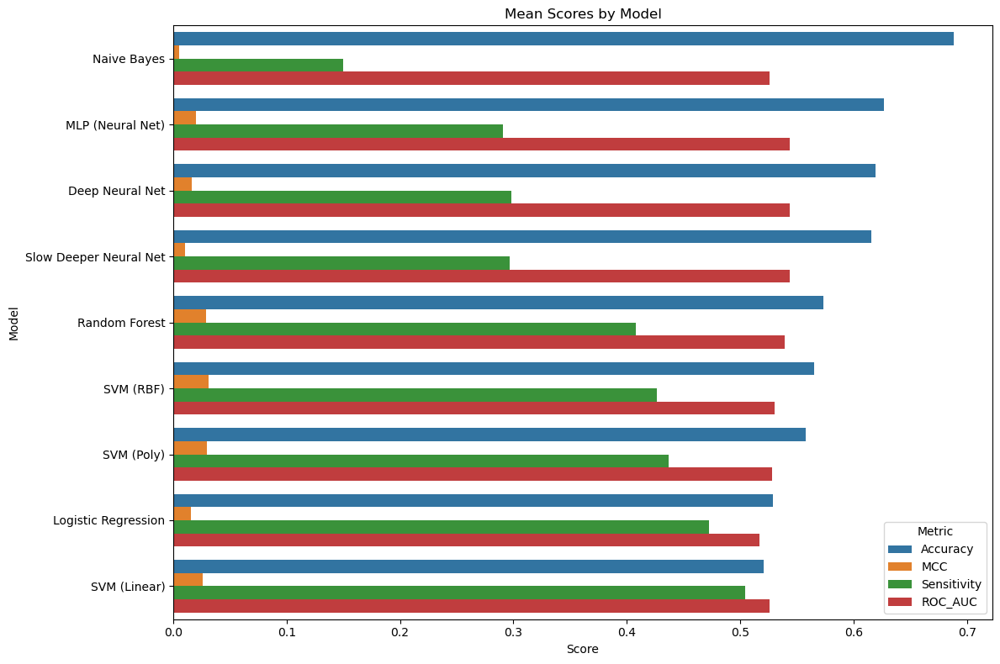


Best Performing Model by MCC:
Model                                                MLP (Neural Net)
RandomState                                                        81
Accuracy                                                     0.763158
BalancedAccuracy                                             0.624521
F1                                                           0.635297
MCC                                                          0.281178
Sensitivity                                                  0.361111
ROC_AUC                                                      0.629191
BestParams          {'activation': 'relu', 'hidden_layer_sizes': (...
Name: 725, dtype: object


In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC 
from sklearn.naive_bayes import GaussianNB
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import (
    accuracy_score, balanced_accuracy_score, f1_score, matthews_corrcoef,
    confusion_matrix, roc_auc_score
)
from ctgan import CTGAN
import matplotlib.pyplot as plt
import seaborn as sns

# Results container
results = []

# Define model grid
model_grid = {
    "Logistic Regression": (
        LogisticRegression(max_iter=1000),
        {
            'C': [0.01, 0.1, 1],
            'penalty': ['l1', 'l2'],
            'solver': ['liblinear'],
            'class_weight': ['balanced']
        }
    ),
    "SVM (Linear)": (
        SVC(probability=True),
        {
            'kernel': ['linear'],
            'C': [0.1, 1],
            'class_weight': ['balanced']
        }
    ),
    "SVM (RBF)": (
        SVC(probability=True),
        {
            'kernel': ['rbf'],
            'C': [0.1, 1],
            'gamma': ['scale'],
            'class_weight': ['balanced']
        }
    ),
    "SVM (Poly)": (
        SVC(probability=True),
        {
            'kernel': ['poly'],
            'degree': [2, 3],
            'C': [0.1, 1],
            'class_weight': ['balanced']
        }
    ),
    "Naive Bayes": (
        GaussianNB(),
        {}
    ),
    "MLP (Neural Net)": (
        MLPClassifier(),
        {
            'hidden_layer_sizes': [(64, 32)],
            'activation': ['relu'],
            'solver': ['adam'],
            'learning_rate_init': [0.001],
            'max_iter': [1000]
        }
    ),
    "Deep Neural Net": (
        MLPClassifier(),
        {
            'hidden_layer_sizes': [(128, 64, 32)],
            'activation': ['relu'],
            'solver': ['adam'],
            'learning_rate_init': [0.0005],
            'max_iter': [1500]
        }
    ),
    "Slow Deeper Neural Net": (
        MLPClassifier(),
        {
            'hidden_layer_sizes': [(256, 128, 64, 32)],
            'activation': ['relu'],
            'solver': ['adam'],
            'learning_rate_init': [0.0005],
            'max_iter': [3000]
        }
    ),
    "Random Forest": (
        RandomForestClassifier(),
        {
            'n_estimators': [100, 300],
            'max_depth': [None, 10],
            'min_samples_leaf': [1, 2],
            'class_weight': ['balanced']
        }
    )
}

# Loop over random states
for seed in range(1, 151):
    print(f"\n====== Random State: {seed} ======")
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed, stratify=y)

    # Apply CTGAN augmentation
    df_train = X_train.copy()
    df_train['target'] = y_train
    minority = df_train[df_train['target'] == 1]

    ctgan = CTGAN(epochs=300)
    ctgan.fit(minority, discrete_columns=['target'])
    synthetic_data = ctgan.sample(len(minority))

    augmented = pd.concat([df_train, synthetic_data])
    X_train_aug = augmented.drop(columns=['target'])
    y_train_aug = augmented['target']

    for model_name, (model, param_grid) in model_grid.items():
        print(f"\n--- {model_name} ---")

        if hasattr(model, 'random_state'):
            model.random_state = seed

        if param_grid:
            grid = GridSearchCV(model, param_grid, cv=5, scoring='balanced_accuracy', n_jobs=-1)
            grid.fit(X_train_aug, y_train_aug)
            best_model = grid.best_estimator_
            best_params = grid.best_params_
        else:
            best_model = model.fit(X_train_aug, y_train_aug)
            best_params = "N/A"

        y_pred = best_model.predict(X_test)
        y_proba = best_model.predict_proba(X_test)[:, 1] if hasattr(best_model, "predict_proba") else None

        acc = accuracy_score(y_test, y_pred)
        bal_acc = balanced_accuracy_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred, average='macro')
        mcc = matthews_corrcoef(y_test, y_pred)
        cm = confusion_matrix(y_test, y_pred)
        sensitivity = cm[1,1] / (cm[1,1] + cm[1,0]) if (cm[1,1] + cm[1,0]) else 0
        auc = roc_auc_score(y_test, y_proba) if y_proba is not None else None

        results.append({
            'Model': model_name,
            'RandomState': seed,
            'Accuracy': acc,
            'BalancedAccuracy': bal_acc,
            'F1': f1,
            'MCC': mcc,
            'Sensitivity': sensitivity,
            'ROC_AUC': auc,
            'BestParams': best_params
        })

# Create and save results
results_df = pd.DataFrame(results)
results_df.to_csv("ctgan_augmented_model_results_final.csv", index=False)

# Identify best results
grouped = results_df.groupby("Model").agg({
    'Accuracy': 'mean',
    'MCC': 'mean',
    'Sensitivity': 'mean',
    'ROC_AUC': 'mean'
}).sort_values(by=['Accuracy', 'MCC', 'Sensitivity', 'ROC_AUC'], ascending=False)

print("\nTop Models by Mean Scores (sorted by Accuracy, MCC, Sensitivity, ROC_AUC):")
print(grouped)

# Plot results
plt.figure(figsize=(12, 8))
sns.barplot(data=grouped.reset_index().melt(id_vars='Model'), x='value', y='Model', hue='variable')
plt.title("Mean Scores by Model")
plt.xlabel("Score")
plt.ylabel("Model")
plt.legend(title="Metric")
plt.tight_layout()
plt.savefig("model_scores_plot.png")
plt.show()

# Show best performing model with highest MCC
best_row = results_df.loc[results_df['MCC'].idxmax()]
print("\nBest Performing Model by MCC:")
print(best_row)


In [23]:
# read the results file
results_df = pd.read_csv("ctgan_augmented_model_results_final.csv")